In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import json
import cv2
from PIL import Image
import random
import math
from datetime import datetime

In [2]:
start = datetime.now()
print(start)

2025-05-30 01:53:28.053412


# Import Image

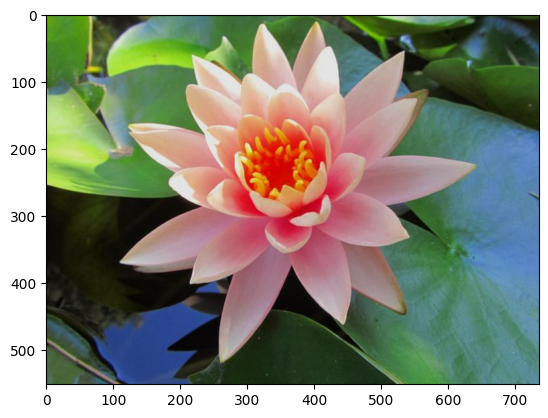

In [3]:
image_path = "./Images/flower.jpg"
original_image = Image.open(image_path).convert("RGB")
plt.imshow(original_image)

# Resize Image

In [4]:
from skimage.transform import resize

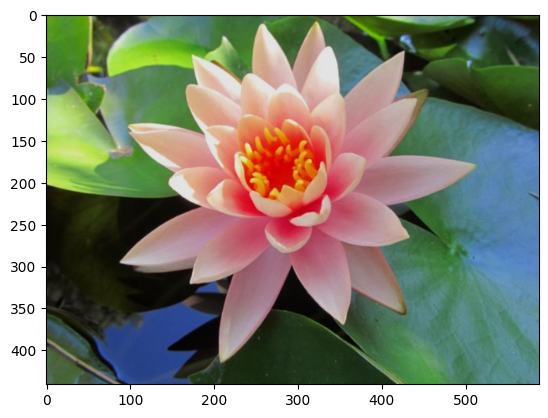

In [5]:
original_image_np = np.array(original_image)

RESIZE_FACTOR = 0.8

original_x_dim, original_y_dim, _ = original_image_np.shape
new_x_dim = int(original_x_dim * RESIZE_FACTOR)
new_y_dim = int(original_y_dim * RESIZE_FACTOR)
new_shape = (new_x_dim, new_y_dim)

downsampled_image = resize(
    original_image_np,
    output_shape=new_shape, 
    preserve_range=True,
    anti_aliasing=True
).astype(np.uint8)

plt.imshow(downsampled_image)

# Grayscale Image

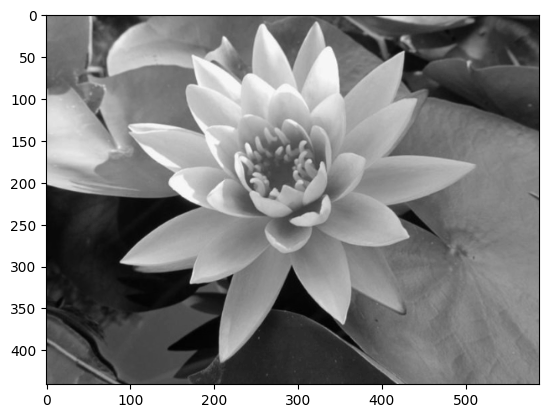

In [6]:
gray_image = cv2.cvtColor(downsampled_image, cv2.COLOR_RGB2GRAY)

plt.imshow(gray_image, cmap="gray")

# Blur Image

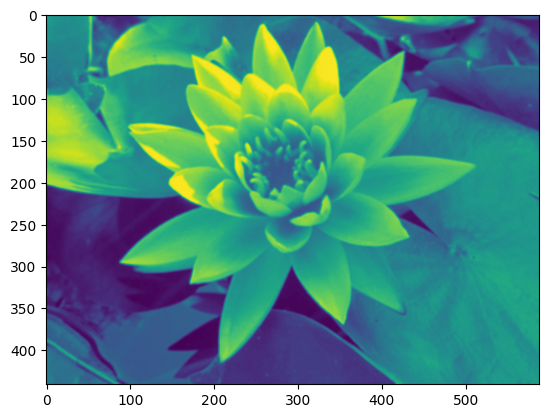

In [7]:
gray_image_np = np.array(gray_image)

BLUR_KERNEL_SIZE = 3
BLUR_SIGMA = 1.4

blurred_image = cv2.GaussianBlur(
    gray_image_np, 
    (BLUR_KERNEL_SIZE, BLUR_KERNEL_SIZE),
    sigmaX=BLUR_SIGMA
)

plt.imshow(blurred_image)

# Canny Filter

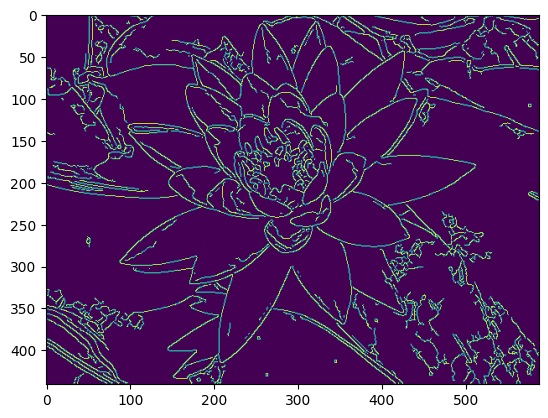

In [8]:
CANNY_THRESHOLD_1 = 50
CANNY_THRESHOLD_2 = 10


canny_edges = cv2.Canny(
    blurred_image, 
    CANNY_THRESHOLD_1,
    CANNY_THRESHOLD_2
)

plt.imshow(canny_edges)

# Detect Contours (and map to colors)

Found 304 countour segments


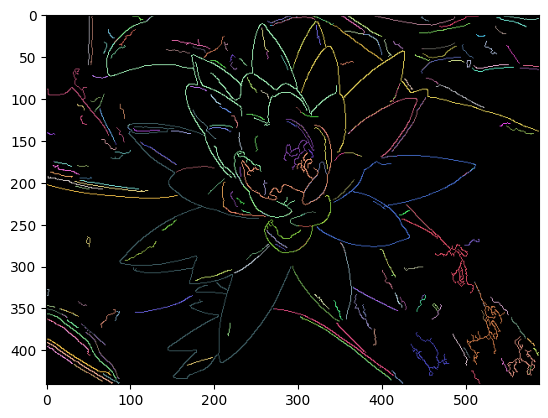

In [9]:
MAX_SEGMENT_ANGLE = np.deg2rad(40)
MIN_SEGMENT_LENGTH = 20
SEGMENT_ANGLE_WINDOW = 10

contours, _ = cv2.findContours(
    canny_edges.copy(),
    cv2.RETR_LIST,
    cv2.CHAIN_APPROX_NONE
)
        
contour_image = np.zeros((*canny_edges.shape, 3), dtype=np.uint8)
contour_id = 0
colors_used = []

for contour in contours: 
    
    points = contour.squeeze()
    if points.ndim != 2 or len(points) < 3:
        continue
        
    breaks = []
    window = SEGMENT_ANGLE_WINDOW
    for i in range(window, len(points) - window):
        segment1 = points[i-window:i]
        segment2 = points[i:i+window]
        
        v1 = segment1[-1] - segment1[0] # vector from behind
        v2 = segment2[-1] - segment2[0] # vector to beyond
        
        n1 = v1 / (np.linalg.norm(v1) + 1e-8)
        n2 = v2 / (np.linalg.norm(v2) + 1e-8)
        
        cosine_similarity = np.dot(n1, n2).clip(-1, 1)
        angle = np.arccos(np.abs(cosine_similarity))
        
        if angle > MAX_SEGMENT_ANGLE:
            breaks.append(i)
    
    ## split the contour 
    split_idxs = np.concatenate([[0], np.array(breaks, dtype=np.uint8), [len(points)]])
    for i in range(len(split_idxs) - 1):
        a, b, = split_idxs[i], split_idxs[i+1]
        segment = points[a:b]
        if (len(segment) < MIN_SEGMENT_LENGTH):
            continue
            
        while True:
            new_color = [random.randint(64, 255) for c in range(3)]
            if new_color not in colors_used:
                colors_used.append(new_color)
                break
                
        for x, y in segment:
            contour_image[y, x] = new_color
            
        contour_id += 1
                
                
print(f"Found {contour_id} countour segments")

plt.imshow(contour_image)
                    
        
        

# Find PCA Length (and rank countours)

In [10]:
from sklearn.decomposition import PCA
from collections import defaultdict

Kept 155 contours after PCA filter


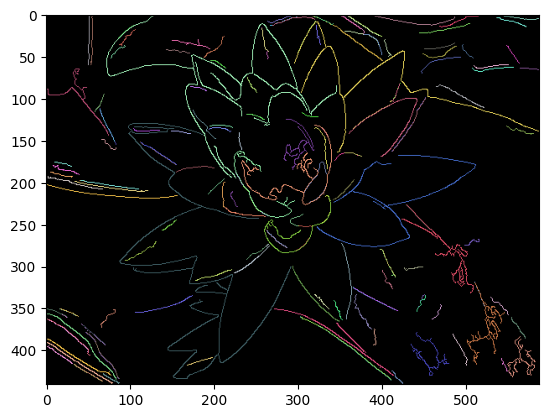

In [11]:
MIN_PCA_DISTANCE = 10

def pca_length(points):
    if len(points) < 2:
        return 0
    pca = PCA(n_components=1)
    projected = pca.fit_transform(points)
    return projected.max()

## map from each contour (key color) to its pixles
color_to_pixels = defaultdict(list)

h, w, c = contour_image.shape
for y in range(h):
    for x in range(w):
        color = tuple(contour_image[y, x])
        if color != (0, 0, 0):
            color_to_pixels[color].append([x, y])
            
## compute PCA length for all contours
color_lengths = []
for color, pixels in color_to_pixels.items():
    points = np.array(pixels)
    length = pca_length(points)
    color_lengths.append((color, length))
    
color_lengths.sort(key = lambda x: x[1], reverse=True)
color_lengths = [(k, v) for k, v in color_lengths if v > MIN_PCA_DISTANCE]

filtered_contour_image = np.zeros((contour_image.shape), dtype=np.uint8)
for color, length in color_lengths: 

    pixels = color_to_pixels[color]
    for x, y in pixels:
    
        filtered_contour_image[y, x] = color
        
print(f"Kept {len(color_lengths)} contours after PCA filter")
        
plt.imshow(filtered_contour_image)

# Select One Contour

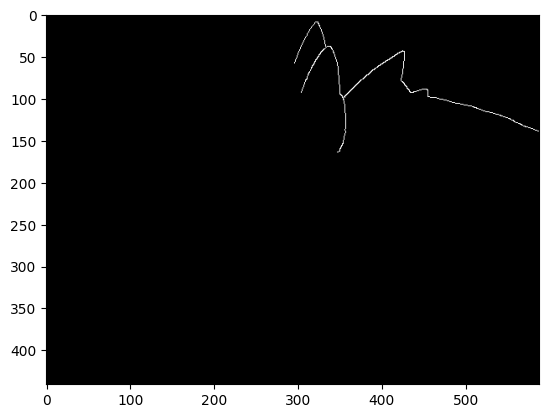

In [12]:
k = 0
color = color_lengths[k][0]

edge_pixels = color_to_pixels[color]

selected_contour_image = np.zeros_like(contour_image)

for x, y in edge_pixels: 
    selected_contour_image[y, x] = [255, 255, 255]
    
plt.imshow(selected_contour_image)

# Draw Squares

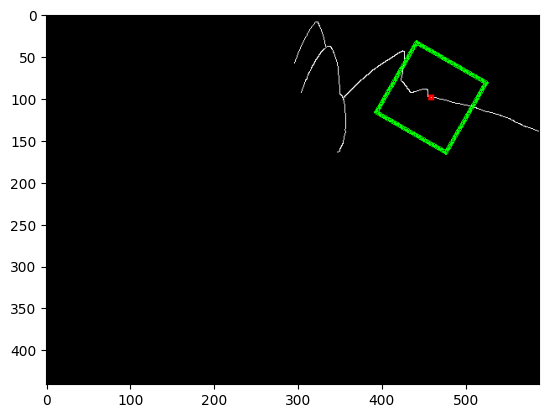

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import random

def draw_square(image, center, size, color, border, theta=0):
    x0, y0 = center
    H, W, C = image.shape
    half = size // 2
    angle_rad = np.deg2rad(theta)

    border = min(border, half)

    coords = []
    for dy in range(-half, half + 1):
        for dx in range(-half, half + 1):
            
            ## only work with pixels in border
            if (abs(dy) >= half - border + 1) or (abs(dx) >= half - border + 1):
                
                ## rotate about center
                dy_rot = dy * np.cos(angle_rad) - dx * np.sin(angle_rad)
                dx_rot = dy * np.sin(angle_rad) + dx * np.cos(angle_rad)

                y = int(round(y0 + dy_rot))
                x = int(round(x0 + dx_rot))

                if 0 <= y < H and 0 <= x < W:
                    coords.append((y, x))

    for y, x in coords:
        image[y, x] = color


random_point = random.choice(edge_pixels)
canvas_image = selected_contour_image.copy()

draw_square(
    image=canvas_image,
    center=random_point,
    size=7,
    color=[255, 0, 0],
    border=3
)

draw_square(
    image=canvas_image,
    center=random_point,
    size=100,
    color=[0, 255, 0],
    border=5,
    theta=random.randint(10, 90)
)

plt.imshow(canvas_image)
plt.show()


# Define Reward Function + Align Theta

In [14]:
def reward_function(image, center, size, theta, decay_rate=2.0):
    """
    Compute a reward that reflects how well a rotated square's centerline
    aligns with bright (edge) pixels in the image.
    """
    
#     print("Example pixel:", image[int(center[0]), int(center[1])])
#     print("Max pixel in image:", np.max(image))
#     print("Image dtype:", image.dtype)
    
    x0, y0 = center
    H, W = image.shape
    half = size / 2
    angle_rad = np.deg2rad(theta)
    reward = 0.0
    


    for dx in range(-size//2, size//2 + 1):
        dy = 0
        dy_rot = dy * np.cos(angle_rad) - dx * np.sin(angle_rad)
        dx_rot = dy * np.sin(angle_rad) + dx * np.cos(angle_rad)

        y = int(round(y0 + dy_rot))
        x = int(round(x0 + dx_rot))

        if 0 <= y < H and 0 <= x < W:
            base_intensity = image[y, x]
            reward += base_intensity

            for offset in range(1, 6):
                # Above centerline
                dy_off = offset
                dy_rot = dy_off * np.cos(angle_rad) - dx * np.sin(angle_rad)
                dx_rot = dy_off * np.sin(angle_rad) + dx * np.cos(angle_rad)
                y_off = int(round(y0 + dy_rot))
                x_off = int(round(x0 + dx_rot))
                if 0 <= y_off < H and 0 <= x_off < W:
                    weight = np.exp(-decay_rate * (offset / half) ** 2)
                    reward += weight * image[y_off, x_off]

                # Below centerline
                dy_off = -offset
                dy_rot = dy_off * np.cos(angle_rad) - dx * np.sin(angle_rad)
                dx_rot = dy_off * np.sin(angle_rad) + dx * np.cos(angle_rad)
                y_off = int(round(y0 + dy_rot))
                x_off = int(round(x0 + dx_rot))
                if 0 <= y_off < H and 0 <= x_off < W:
                    weight = np.exp(-decay_rate * (offset / half) ** 2)
                    reward += weight * image[y_off, x_off]



    return reward


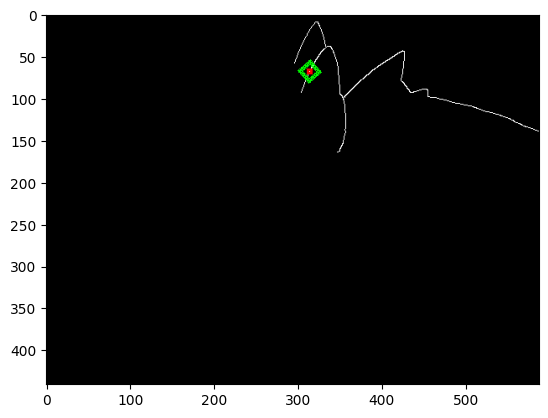

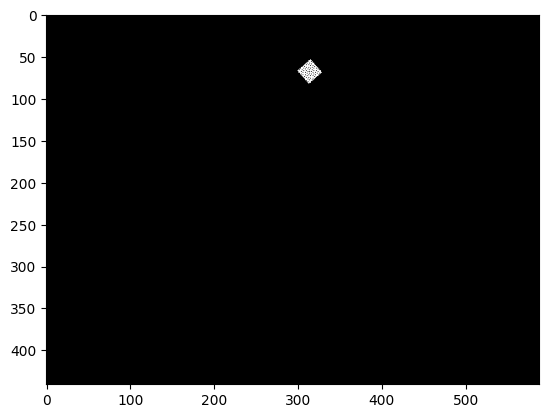

In [15]:
ERROR_CODE_NO_VALID_THETA = -999  # special negative int

def get_square_coords(center, size, border, theta, image_shape):
    """Get all coordinates of the square border with rotation."""
    y0, x0 = center
    H, W = image_shape
    angle_rad = np.deg2rad(theta)
    coords = []

    for dy in range(-size//2, size//2 + 1):
        for dx in range(-size//2, size//2 + 1):
            if (abs(dy) >= size//2 - border + 1) or (abs(dx) >= size//2 - border + 1):
                dy_rot = dy * np.cos(angle_rad) - dx * np.sin(angle_rad)
                dx_rot = dy * np.sin(angle_rad) + dx * np.cos(angle_rad)

                y = int(round(y0 + dy_rot))
                x = int(round(x0 + dx_rot))

                if 0 <= y < H and 0 <= x < W:
                    coords.append((y, x))
    return coords

def is_valid_square(mask, center, size, border, theta):
    """Check if the square with given params would overlap with the mask."""
    coords = get_square_coords(center, size, border, theta, mask.shape)
    return all(mask[y, x] == 0 for y, x in coords)

def find_best_theta(image, center, size, mask, theta_range=(-45, 45), decay_rate=2.0):
    
    image = np.mean(image[...,:3], axis=-1)
    mask = np.mean(mask[...,:3], axis=-1)
    
    best_theta = None
    best_reward = -float('inf')
    border = 5  # assumed from your draw_square usage

    for theta in range(theta_range[0], theta_range[1] + 1):
        if is_valid_square(mask, center, size, border, theta):
            reward = reward_function(image, center, size, theta, decay_rate)
#             print("Theta: ", theta, "Reward: ", reward)
            if reward > best_reward:
                best_reward = reward
                best_theta = theta

    return best_theta if best_theta is not None else ERROR_CODE_NO_VALID_THETA

        
        
canvas_image = selected_contour_image.copy()
mask = np.zeros_like(selected_contour_image, dtype=np.uint8)

SIZE = 20
DECAY_RATE = 2

# Pick a random point on the edge
random_point = random.choice(edge_pixels)


best_theta = find_best_theta(selected_contour_image, random_point, SIZE, mask, decay_rate=DECAY_RATE)


if best_theta != ERROR_CODE_NO_VALID_THETA:


    ## show starting point
    draw_square(
        image=canvas_image,
        center=random_point,
        size=7,
        color=[255, 0, 0],
        border=5
    )

    ## show tile
    draw_square(
        image=canvas_image,
        center=random_point,
        size=SIZE,
        color=[0, 255, 0],
        border=5,
        theta=best_theta
    )


    ## add tile to mask
    draw_square(
        image=mask,
        center=random_point,
        size=SIZE,
        color=[255, 255, 255],
        border=SIZE//2 + 1,
        theta=best_theta

    )


    # Show result
    plt.figure()
    plt.imshow(canvas_image)
    plt.show()


    plt.figure()
    plt.imshow(mask)
    plt.show()
    



# Find Next Points

Found 4 intersecting edge points.


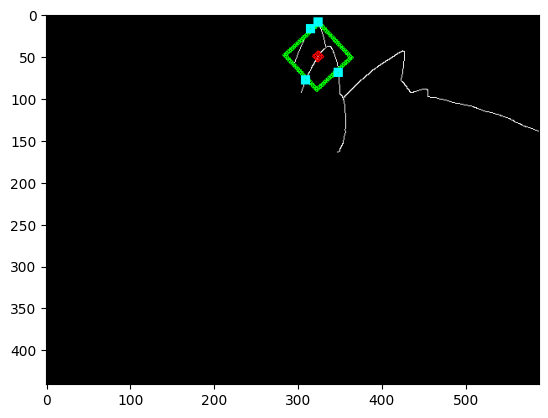

In [16]:
import numpy as np

# Function to calculate the Euclidean distance between two points
def euclidean_distance(point1, point2):
    return math.sqrt((point1[0] - point2[0]) ** 2 + (point1[1] - point2[1]) ** 2)

# Function to filter the points based on the distance criterion
def filter_points(points, d):
    if len(points) == 0: 
        return []
    selected_points = [points[0]]  # Keep the first point
    for point in points[1:]:
        # Check if the point is at least `d` distance away from all selected points
        if all(euclidean_distance(point, selected_point) >= d for selected_point in selected_points):
            selected_points.append(point)
    return selected_points

def get_rotated_square_border(center, size, theta_deg, step=1):
    """Return coordinates of border pixels for a rotated square."""
    x0, y0 = center
    half = size // 2
    angle_rad = np.deg2rad(theta_deg)
    coords = []

    # Define unrotated corners of the square
    corners = [
        (-half, -half),
        (-half,  half),
        ( half,  half),
        ( half, -half)
    ]

    # Trace the 4 sides between corners
    for i in range(4):
        y1, x1 = corners[i]
        y2, x2 = corners[(i + 1) % 4]
        dist = max(abs(x2 - x1), abs(y2 - y1))
        for t in np.linspace(0, 1, int(dist / step) + 1):
            dy = y1 + t * (y2 - y1)
            dx = x1 + t * (x2 - x1)
            # Rotate
            dy_rot = dy * np.cos(angle_rad) - dx * np.sin(angle_rad)
            dx_rot = dy * np.sin(angle_rad) + dx * np.cos(angle_rad)
            # Translate to image coords
            y = int(round(y0 + dy_rot))
            x = int(round(x0 + dx_rot))
            coords.append((y, x))

    return list(set(coords))  # Remove duplicates


def get_edge_intersections(edge_image, center, size, theta_deg, step=1, threshold=128):
    """
    Return a list of edge pixels that intersect with a concentric square 
    of double the size and given rotation.
    """
    # Convert image to grayscale if it's RGB
    if edge_image.ndim == 3:
        edge_image = np.mean(edge_image[..., :3], axis=-1)

    H, W = edge_image.shape
    border_coords = get_rotated_square_border(center, size, theta_deg, step)

    valid_points = []
    for y, x in border_coords:
        if 0 <= y < H and 0 <= x < W and edge_image[y, x] >= threshold:
            valid_points.append((x, y))

            
    filtered_points = filter_points(valid_points, d=int(size//10))
    
    return filtered_points


SIZE = 20

random_point = random.choice(edge_pixels)
best_theta = find_best_theta(selected_contour_image, random_point, SIZE, mask, decay_rate=DECAY_RATE)


search_square_size = int(3*SIZE)

intersections = get_edge_intersections(
    edge_image=selected_contour_image, 
    center=random_point, 
    size=search_square_size, 
    theta_deg=best_theta
)


canvas_image_2 = selected_contour_image.copy()


draw_square(
    image=canvas_image_2,
    center=random_point,
    size=10,
    color=[255, 0, 0],
    border=5,
    theta=best_theta
)

draw_square(
        image=canvas_image_2,
        center=random_point,
        size=search_square_size,
        color=[0, 255, 0],
        border=5,
        theta=best_theta
)

for point in intersections:
    draw_square(
        image=canvas_image_2,
        center=point,
        size=10,
        color=[0, 255, 255],
        border=5,
        theta=0
    )


print(f"Found {len(intersections)} intersecting edge points.")


plt.imshow(canvas_image_2)

# Perform multiple searches

Found 1 intersecting edge points.
Found 5 intersecting edge points.
Found 4 intersecting edge points.


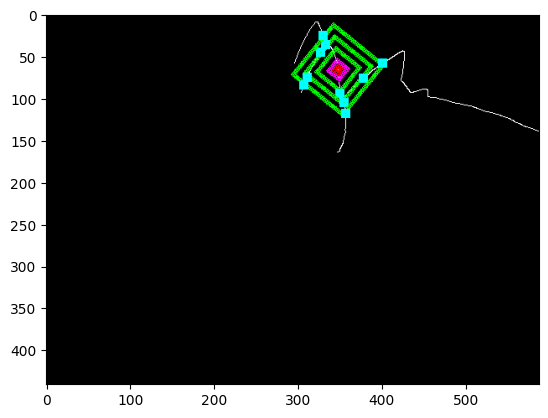

In [17]:
SIZE = 20

INITIAL_RADIUS = 20
SEARCH_ITERATIONS = 3

search_square_sizes = [SIZE + INITIAL_RADIUS * i for i in range(1,SEARCH_ITERATIONS+1)]
search_square_sizes

random_point = random.choice(edge_pixels)
best_theta = find_best_theta(selected_contour_image, random_point, SIZE, mask, decay_rate=DECAY_RATE)



canvas_image_2 = selected_contour_image.copy()

## draw original square
draw_square(
        image=canvas_image_2,
        center=random_point,
        size=SIZE,
        color=[255, 0, 255],
        border=5,
        theta=best_theta
)

for search_square_size in search_square_sizes:

    intersections = get_edge_intersections(
        edge_image=selected_contour_image, 
        center=random_point, 
        size=search_square_size, 
        theta_deg=best_theta
    )


    

    ## draw center (dot shaped)
    draw_square(
        image=canvas_image_2,
        center=random_point,
        size=10,
        color=[255, 0, 0],
        border=5,
        theta=best_theta
    )

    ## draw search square
    draw_square(
            image=canvas_image_2,
            center=random_point,
            size=search_square_size,
            color=[0, 255, 0],
            border=5,
            theta=best_theta
    )


    for point in intersections:
        draw_square(
            image=canvas_image_2,
            center=point,
            size=10,
            color=[0, 255, 255],
            border=5,
            theta=0
        )


    print(f"Found {len(intersections)} intersecting edge points.")


plt.imshow(canvas_image_2)

# Complete One BFS Frontier

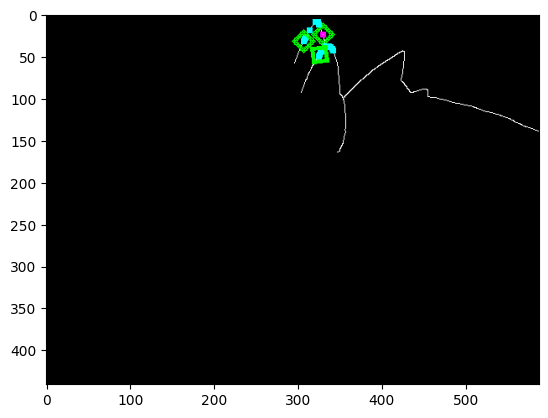

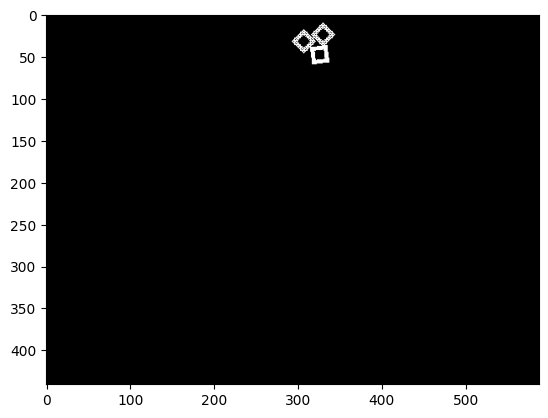

In [18]:
import numpy as np
import matplotlib.pyplot as plt

ERROR_CODE_NO_VALID_THETA = -999  # special negative int

def draw_square(image, center, size, color, border, theta=0):
    """Draws a rotated square border on a 3-channel image."""
    x0, y0 = center
    H, W, C = image.shape
    half = size // 2
    angle_rad = np.deg2rad(theta)
    border = min(border, half)

    coords = []
    for dy in range(-half, half + 1):
        for dx in range(-half, half + 1):
            if (abs(dy) >= half - border + 1) or (abs(dx) >= half - border + 1):
                dy_rot = dy * np.cos(angle_rad) - dx * np.sin(angle_rad)
                dx_rot = dy * np.sin(angle_rad) + dx * np.cos(angle_rad)

                y = int(round(y0 + dy_rot))
                x = int(round(x0 + dx_rot))

                if 0 <= y < H and 0 <= x < W:
                    coords.append((y, x))

    for y, x in coords:
        image[y, x] = color

def draw_mask(mask, center, size, border, theta=0):
    """Updates a 2D mask with 1s where the square would be drawn."""
    coords = get_square_coords(center, size, border, theta, mask.shape)
    for y, x in coords:
        mask[y, x] = 1
        
def place_tile(image, mask_draw, mask_check, center, size, border, theta=0):
    # draw tile (green)
    draw_square(
        image=image,
        center=center,
        size=size,
        color=[0, 255, 0],
        border=border,
        theta=theta
    )

    # draw on visualization mask (white)
    draw_square(
        image=mask_draw,
        center=center,
        size=SIZE,
        color=[255, 255, 255],
        border=border,
        theta=theta
    )

    # update logical mask
    draw_mask(
        mask=mask_check,
        center=center,
        size=size,
        border=border,
        theta=theta
    )
    

def get_square_coords(center, size, border, theta, image_shape):
    """Returns list of rotated square border coordinates within image bounds."""
    y0, x0 = center
    H, W = image_shape
    angle_rad = np.deg2rad(theta)
    coords = []

    for dy in range(-size // 2, size // 2 + 1):
        for dx in range(-size // 2, size // 2 + 1):
            if (abs(dy) >= size // 2 - border + 1) or (abs(dx) >= size // 2 - border + 1):
                dy_rot = dy * np.cos(angle_rad) - dx * np.sin(angle_rad)
                dx_rot = dy * np.sin(angle_rad) + dx * np.cos(angle_rad)

                y = int(round(y0 + dy_rot))
                x = int(round(x0 + dx_rot))

                if 0 <= y < H and 0 <= x < W:
                    coords.append((y, x))
    return coords

def is_valid_square(mask_check, center, size, border, theta):
    """Checks if a square's border would overlap anything already on the mask."""
    coords = get_square_coords(center, size, border, theta, mask_check.shape)
    return all(mask_check[y, x] == 0 for y, x in coords)

def reward_function(image, center, size, theta, decay_rate):
    """
    Dummy reward function. Replace this with your actual logic.
    Here, we just reward based on brightness of the square.
    """
    coords = get_square_coords(center, size, border=5, theta=theta, image_shape=image.shape)
    values = [image[y, x] for y, x in coords]
    return np.sum(values) / (len(values) + 1e-5)

def find_best_theta(image, center, size, mask_check, theta_range=(-45, 45), decay_rate=2.0):
    """Searches for the best rotation angle for a tile at the given center."""
    grayscale = np.mean(image[..., :3], axis=-1)

    best_theta = None
    best_reward = -float('inf')
    border = 5

    for theta in range(theta_range[0], theta_range[1] + 1):
        if is_valid_square(mask_check, center, size, border, theta):
            reward = reward_function(grayscale, center, size, theta, decay_rate)
            if reward > best_reward:
                best_reward = reward
                best_theta = theta

    return best_theta if best_theta is not None else ERROR_CODE_NO_VALID_THETA


canvas_image = selected_contour_image.copy()
mask_draw = np.zeros_like(selected_contour_image, dtype=np.uint8)  # for visualization
mask_check = np.zeros(selected_contour_image.shape[:2], dtype=np.uint8)  # for overlap checking

SIZE = 20
BORDER = 5
DECAY_RATE = 2

INITIAL_RADIUS = 5
SEARCH_ITERATIONS = 5

search_square_sizes = [SIZE + INITIAL_RADIUS * i for i in range(1,SEARCH_ITERATIONS+1)]


random_point = random.choice(edge_pixels)
best_theta = find_best_theta(selected_contour_image, random_point, SIZE, mask_check, decay_rate=DECAY_RATE)




intersections_list = []

for search_square_size in search_square_sizes:

    intersections = get_edge_intersections(
        edge_image=selected_contour_image, 
        center=random_point, 
        size=search_square_size, 
        theta_deg=best_theta
    )

    
    intersections_list.extend(intersections)










# show random point (small pink dot)
draw_square(
    image=canvas_image,
    center=random_point,
    size=7,
    color=[255, 0, 255],
    border=3
)


place_tile(canvas_image, mask_draw, mask_check, random_point, SIZE, BORDER, best_theta)





for point in intersections_list: 
    
    # show starting point (small red dot)
    draw_square(
        image=canvas_image,
        center=point,
        size=7,
        color=[0, 255, 255],
        border=3
    )

    
    best_theta = find_best_theta(selected_contour_image, point, SIZE, mask_check, decay_rate=DECAY_RATE)

    if best_theta != ERROR_CODE_NO_VALID_THETA:
        
        place_tile(canvas_image, mask_draw, mask_check, point, SIZE, BORDER, best_theta)


plt.figure()
plt.imshow(canvas_image)
plt.show()

plt.figure()
plt.imshow(mask_draw)
plt.show()


# Full BFS

Q:  deque([[336, 38]])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask


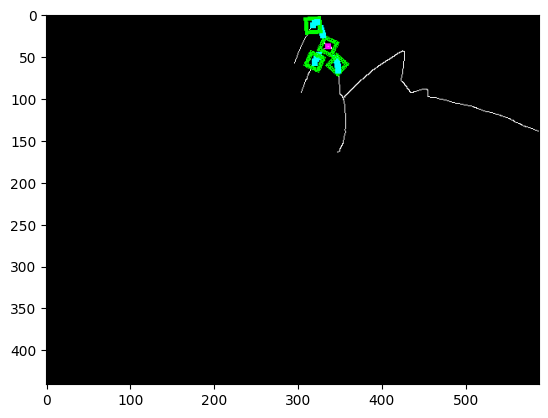

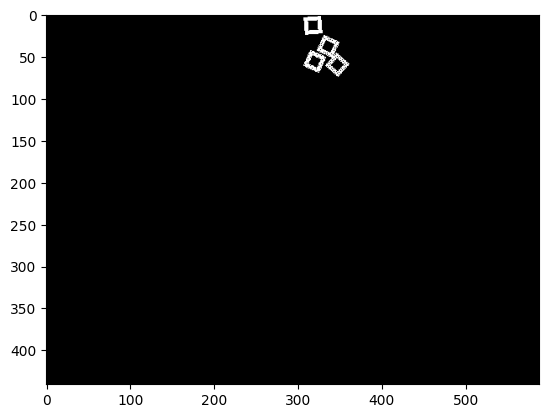

Q:  deque([(320, 56), (347, 60), (318, 13)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask


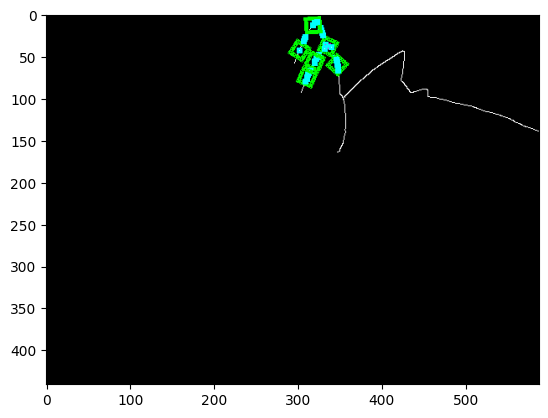

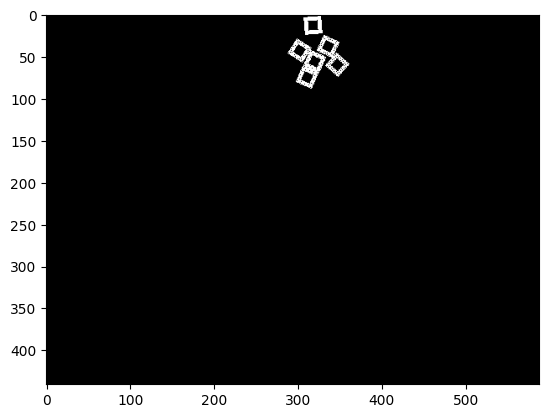

Q:  deque([(347, 60), (318, 13), (302, 43), (311, 75)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask


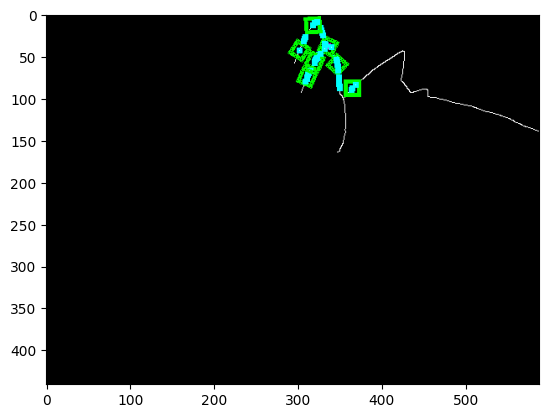

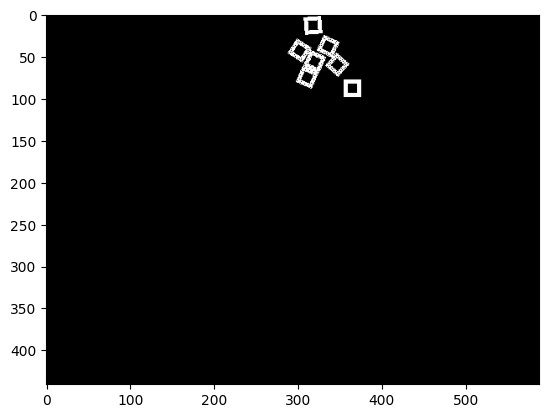

Q:  deque([(318, 13), (302, 43), (311, 75), (365, 88)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask


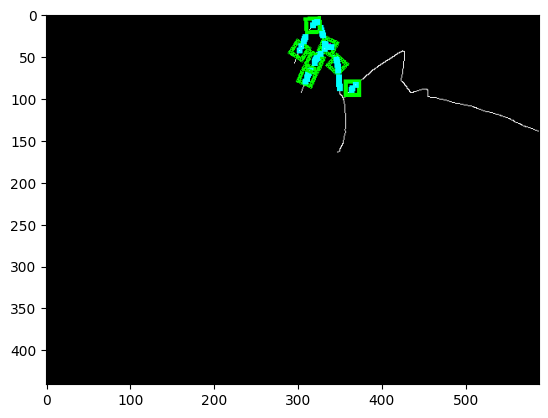

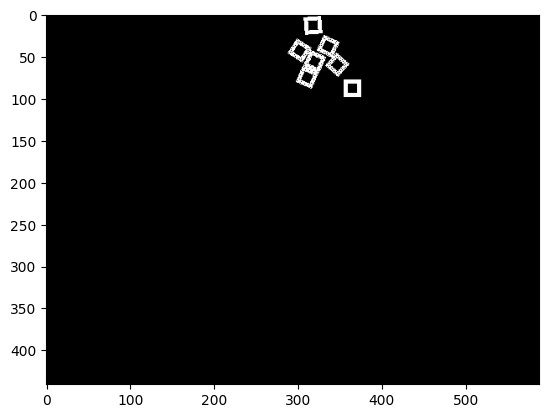

Q:  deque([(302, 43), (311, 75), (365, 88)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask


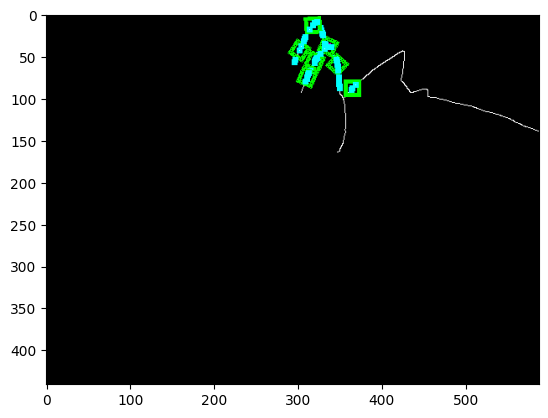

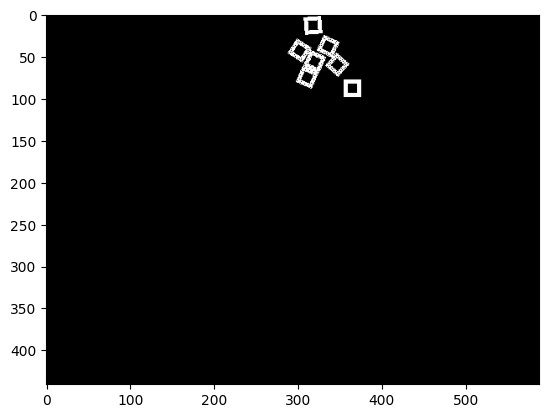

Q:  deque([(311, 75), (365, 88)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask


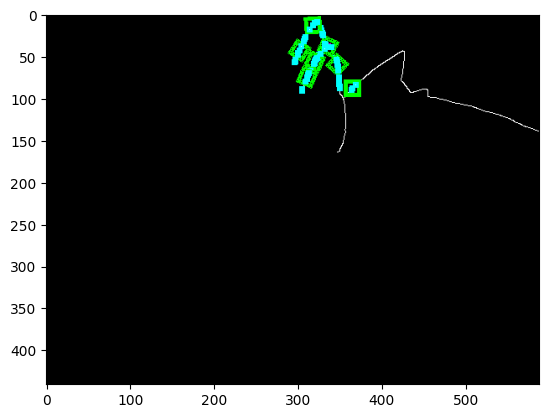

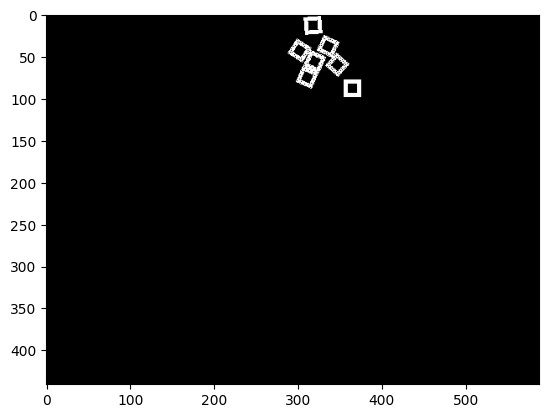

Q:  deque([(365, 88)])
Intersection inside mask
Intersection inside mask
Intersection inside mask


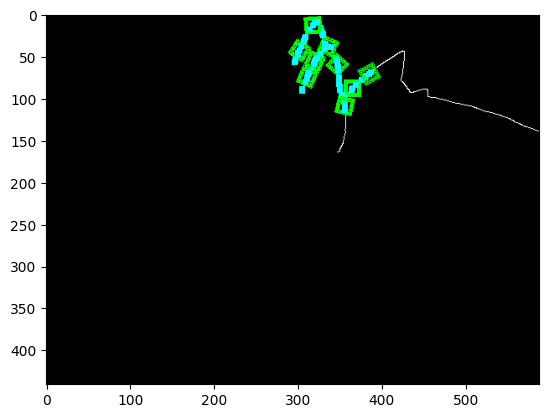

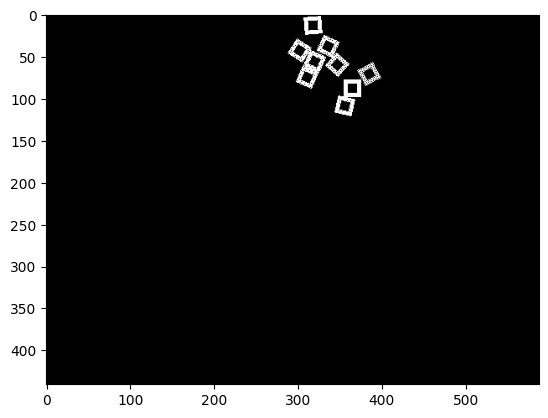

Q:  deque([(385, 71), (356, 109)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask


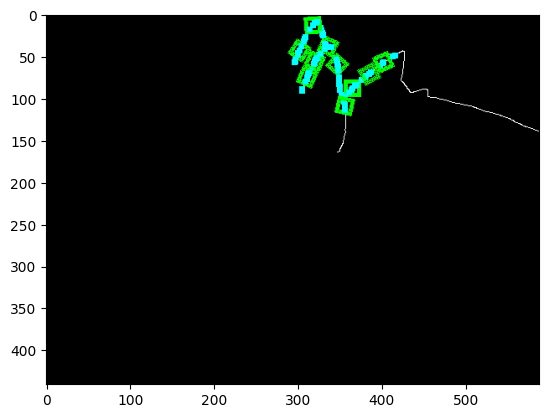

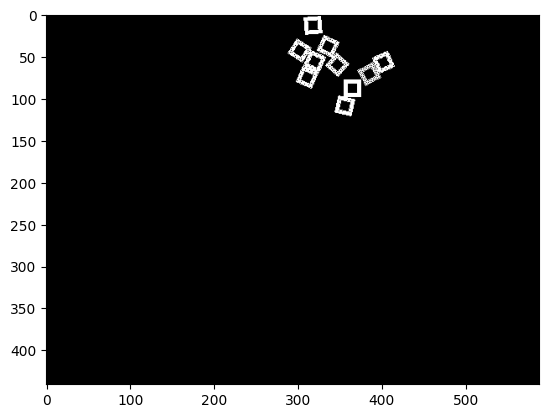

Q:  deque([(356, 109), (402, 57)])
Intersection inside mask
Intersection inside mask


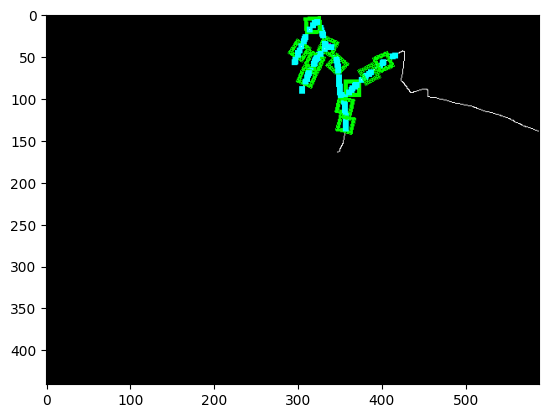

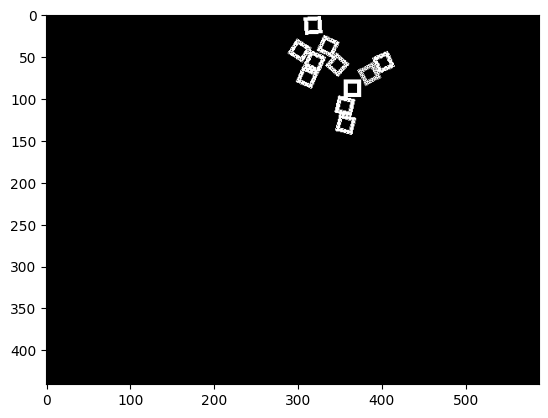

Q:  deque([(402, 57), (357, 131)])
Intersection inside mask
Intersection inside mask


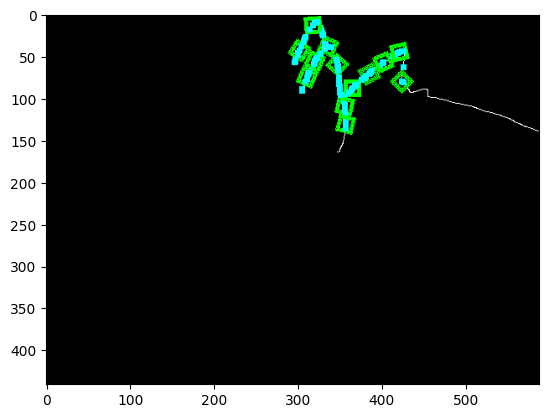

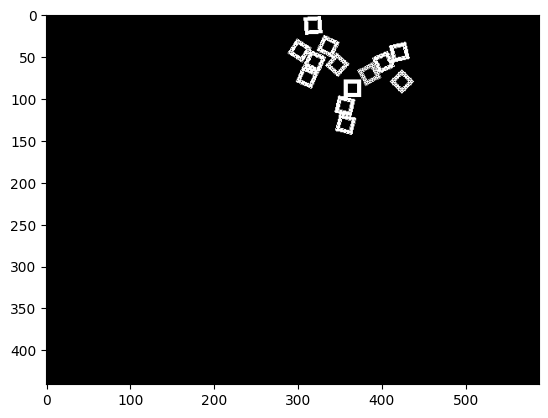

Q:  deque([(357, 131), (421, 45), (424, 80)])
Intersection inside mask
Intersection inside mask
Intersection inside mask


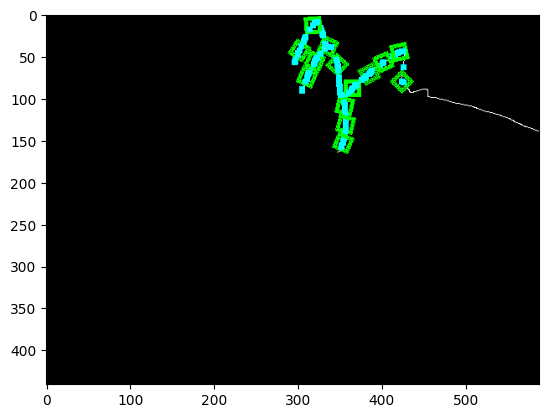

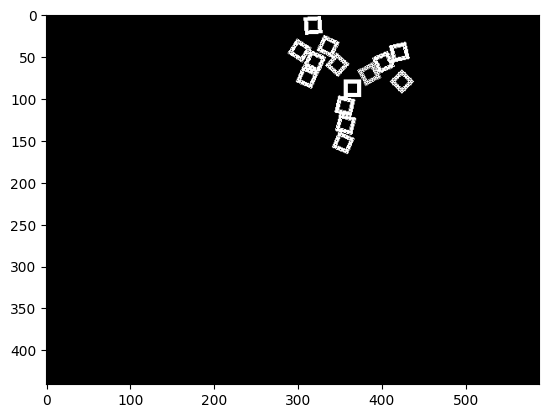

Q:  deque([(421, 45), (424, 80), (354, 153)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask


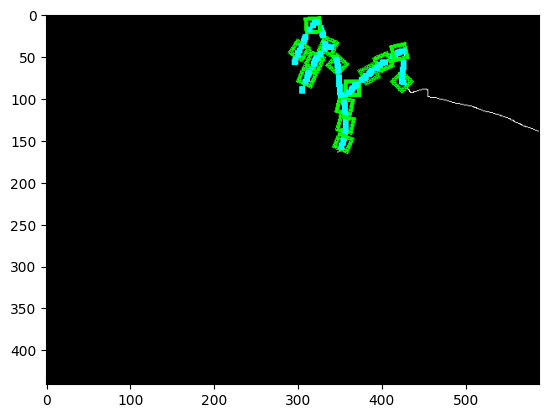

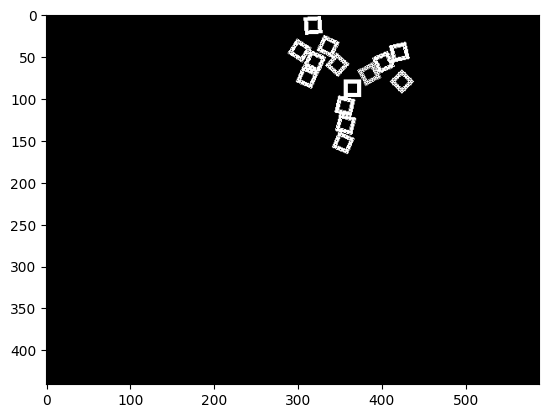

Q:  deque([(424, 80), (354, 153)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask


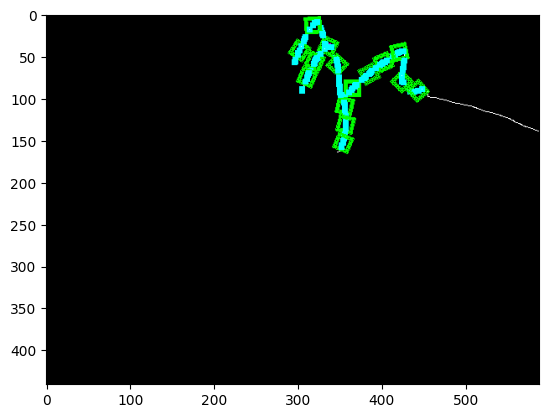

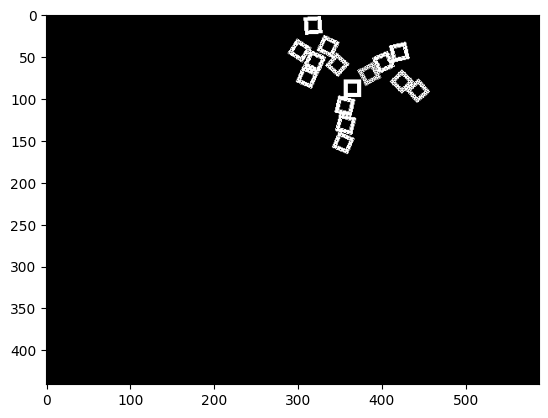

Q:  deque([(354, 153), (443, 91)])
Intersection inside mask
Intersection inside mask


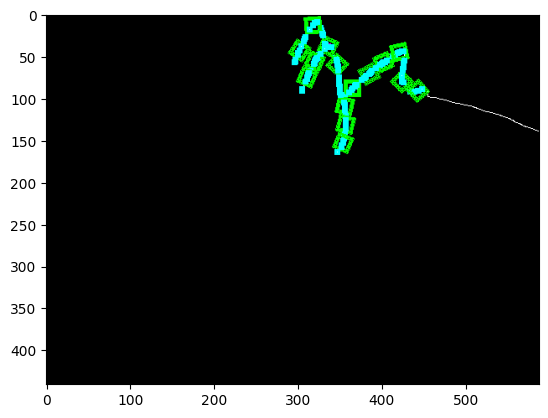

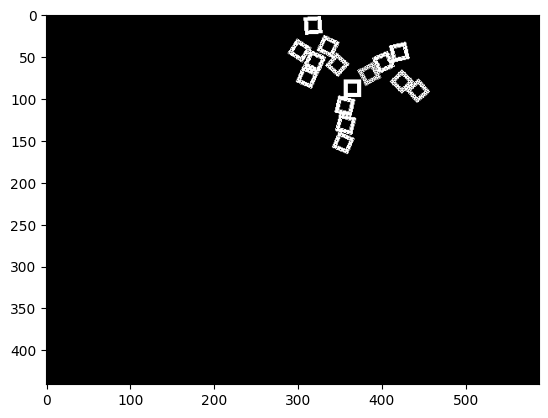

Q:  deque([(443, 91)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask


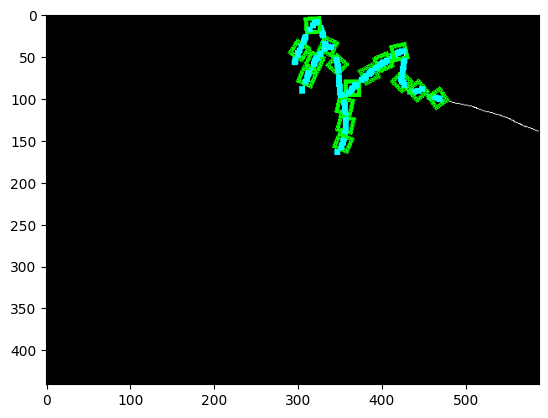

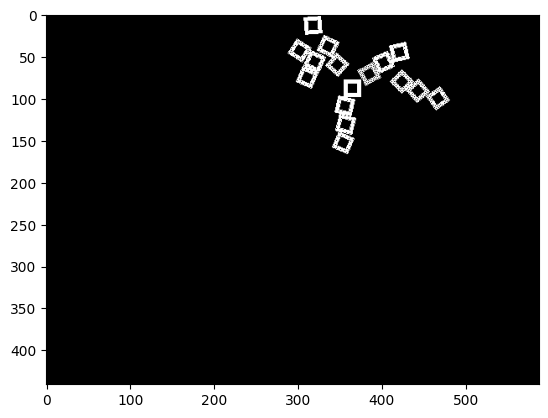

Q:  deque([(467, 100)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask


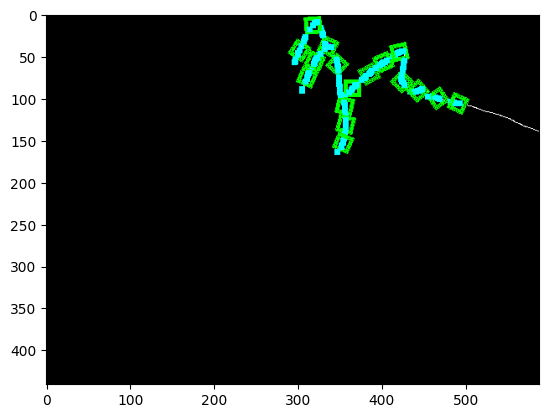

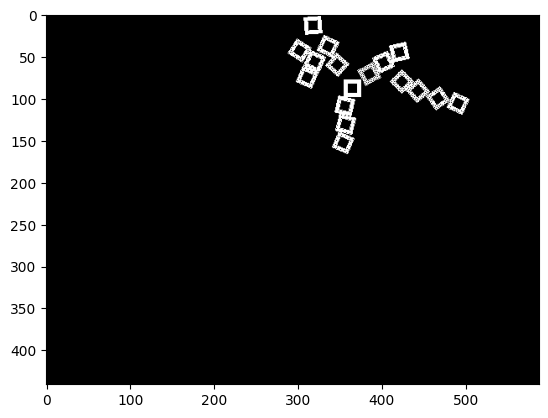

Q:  deque([(491, 106)])
Intersection inside mask
Intersection inside mask
Intersection inside mask


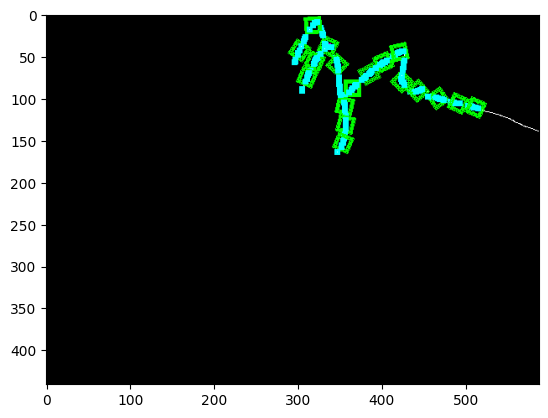

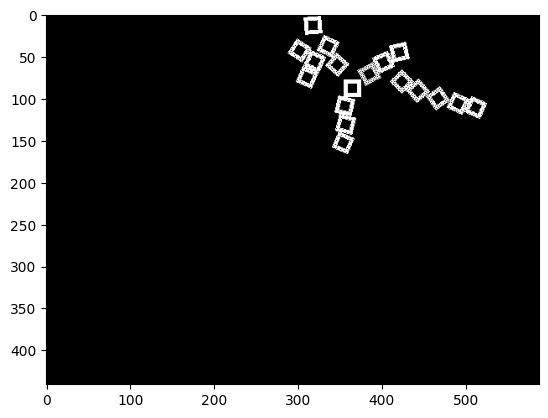

Q:  deque([(512, 111)])
Intersection inside mask
Intersection inside mask


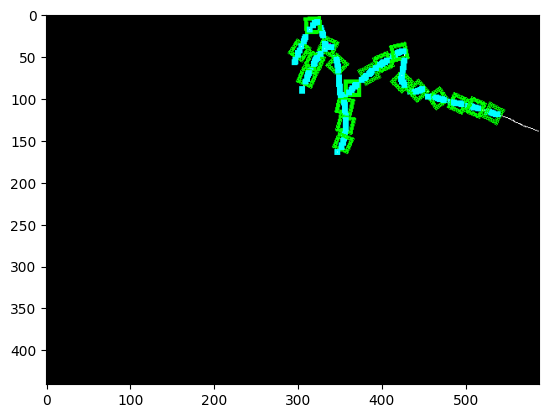

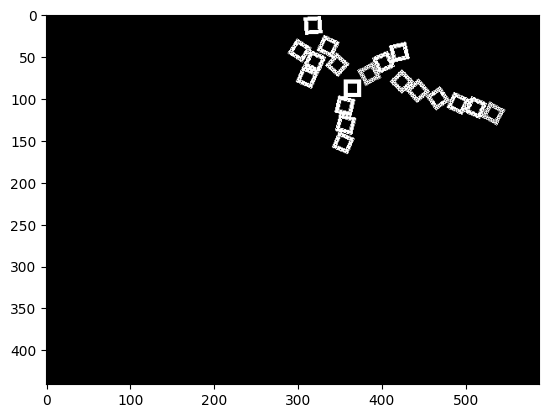

Q:  deque([(533, 118)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask


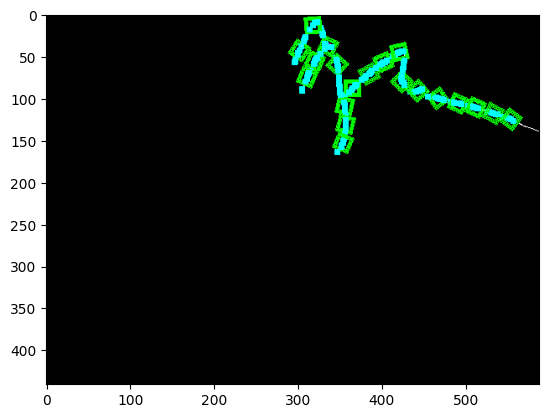

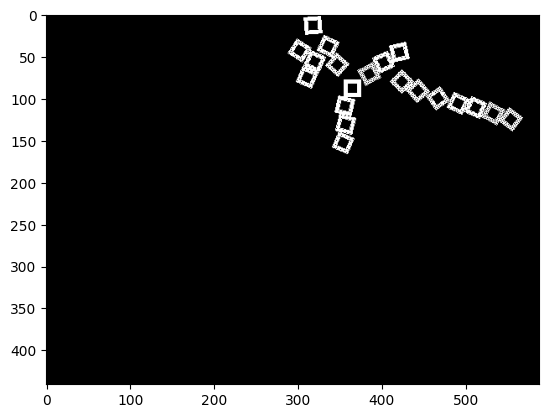

Q:  deque([(554, 125)])
Intersection inside mask


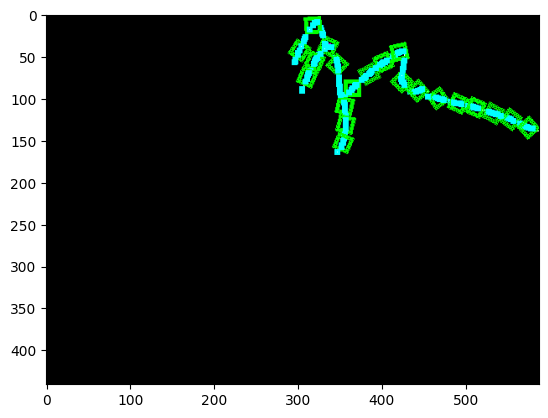

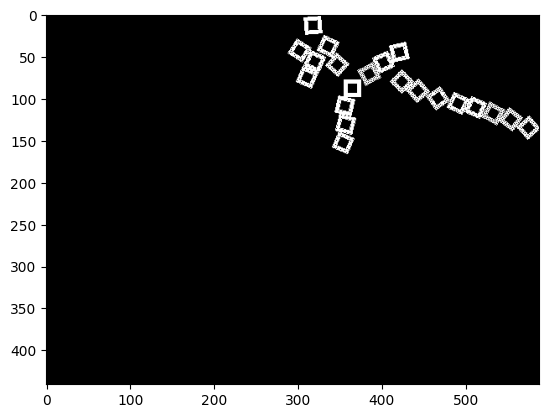

Q:  deque([(575, 135)])
Intersection inside mask
Intersection inside mask


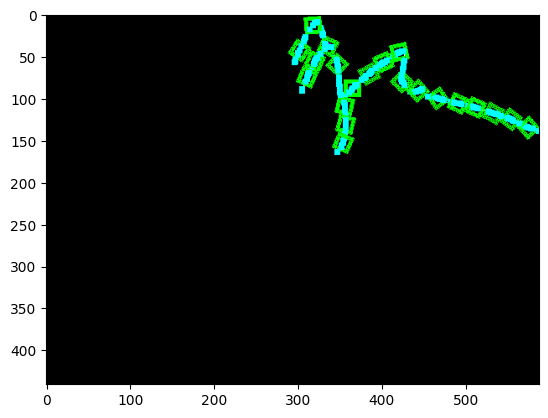

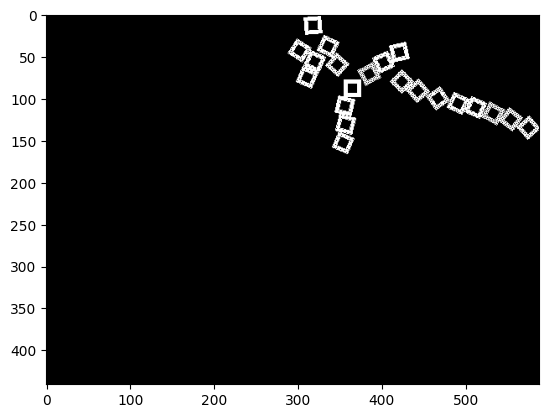

In [19]:
from collections import deque


ERROR_CODE_NO_VALID_THETA = -999  # special negative int

def draw_square(image, center, size, color, border, theta=0):
    """Draws a rotated square border on a 3-channel image."""
    x0, y0 = center
    H, W, C = image.shape
    half = size // 2
    angle_rad = np.deg2rad(theta)
    border = min(border, half)

    coords = []
    for dy in range(-half, half + 1):
        for dx in range(-half, half + 1):
            if (abs(dy) >= half - border + 1) or (abs(dx) >= half - border + 1):
                dy_rot = dy * np.cos(angle_rad) - dx * np.sin(angle_rad)
                dx_rot = dy * np.sin(angle_rad) + dx * np.cos(angle_rad)

                y = int(round(y0 + dy_rot))
                x = int(round(x0 + dx_rot))

                if 0 <= y < H and 0 <= x < W:
                    coords.append((y, x))

    for y, x in coords:
        image[y, x] = color

def draw_mask(mask, center, size, border, theta=0):
    """Updates a 2D mask with 1s where the square would be drawn."""
    coords = get_square_coords(center, size, border, theta, mask.shape)
    for y, x in coords:
        mask[y, x] = 1
        
def place_tile(image, mask_draw, mask_check, center, size, border, theta=0):
    # draw tile (green)
    draw_square(
        image=image,
        center=center,
        size=size,
        color=[0, 255, 0],
        border=border,
        theta=theta
    )

    # draw on visualization mask (white)
    draw_square(
        image=mask_draw,
        center=center,
        size=SIZE,
        color=[255, 255, 255],
        border=border,
        theta=theta
    )

    # update logical mask
    draw_mask(
        mask=mask_check,
        center=center,
        size=size,
        border=border,
        theta=theta
    )
    

def get_square_coords(center, size, border, theta, image_shape):
    """Returns list of rotated square border coordinates within image bounds."""
    x0, y0 = center
    H, W = image_shape
    angle_rad = np.deg2rad(theta)
    coords = []

    for dy in range(-size // 2, size // 2 + 1):
        for dx in range(-size // 2, size // 2 + 1):
            if (abs(dy) >= size // 2 - border + 1) or (abs(dx) >= size // 2 - border + 1):
                dy_rot = dy * np.cos(angle_rad) - dx * np.sin(angle_rad)
                dx_rot = dy * np.sin(angle_rad) + dx * np.cos(angle_rad)

                y = int(round(y0 + dy_rot))
                x = int(round(x0 + dx_rot))

                if 0 <= y < H and 0 <= x < W:
                    coords.append((y, x))
    return coords

def is_valid_square(mask_check, center, size, border, theta):

    
    
    """Checks if a square's border would overlap anything already on the mask."""
    coords = get_square_coords(center, size, border, theta, mask_check.shape)
    return all(mask_check[y, x] == 0 for y, x in coords)



def check_any_valid_rotation(mask_check, center, size):
    
    H, W = mask_check.shape
    ## adjust for indexing
    H -= 1
    W -= 1
    
    x, y = center
    
    candidate_points = [
        (x + size // 2, y),
        (x - size // 2, y),
        (x, y + size // 2),
        (x, y - size // 2)
    ]
    
    filtered_candidate_points = [(min(W, (max(0, x))), min(H, (max(0, y)))) for x, y in candidate_points]
    for x, y in filtered_candidate_points:
        if mask_check[y, x] != 0:
            return False
    
    
    return True

def find_best_theta(image, center, size, mask_check, theta_range=(-45, 45), decay_rate=2.0):
    """Searches for the best rotation angle for a tile at the given center."""

    ## initial check to spare rotations if possible
    
    if not check_any_valid_rotation(mask_check, center, size):
        return ERROR_CODE_NO_VALID_THETA
    
    

    best_theta = None
    best_reward = -float('inf')
    border = BORDER

    for theta in range(theta_range[0], theta_range[1] + 1):
        if is_valid_square(mask_check, center, size, border, theta):
            reward = reward_function(image, center, size, theta, decay_rate)
            if reward > best_reward:
                best_reward = reward
                best_theta = theta

    return best_theta if best_theta is not None else ERROR_CODE_NO_VALID_THETA







canvas_image = selected_contour_image.copy()
mask_draw = np.zeros_like(selected_contour_image, dtype=np.uint8)  # for visualization
mask_check = np.zeros(selected_contour_image.shape[:2], dtype=np.uint8)  # for overlap checking
gray_image = np.mean(selected_contour_image[..., :3], axis=-1)

SIZE = 20
BORDER = 5
DECAY_RATE = 1.5

SEARCH_RADIUS = 5
SEARCH_ITERATIONS = 7

search_square_sizes = [SIZE + SEARCH_RADIUS * i for i in range(1,SEARCH_ITERATIONS+1)]


## choose global BFS start here
random_point = random.choice(edge_pixels)
# show starting point (small pink dot)
draw_square(
    image=canvas_image,
    center=random_point,
    size=7,
    color=[255, 0, 255],
    border=3
)


## Attempt to place first tile
best_theta = find_best_theta(gray_image, random_point, SIZE, mask_check, decay_rate=DECAY_RATE)
assert(best_theta != ERROR_CODE_NO_VALID_THETA)
place_tile(canvas_image, mask_draw, mask_check, random_point, SIZE, BORDER, best_theta)



H, W, C = canvas_image.shape

q = deque([random_point])
visited = set()
visited.add(tuple(int(x) for x in random_point))

while len(q) > 0:
    
    
    
    print("Q: ", q)
    
    starting_point = q.popleft()
    
    
    best_theta = find_best_theta(gray_image, starting_point, SIZE, mask_check, decay_rate=DECAY_RATE)

    intersections_list = []

    for search_square_size in search_square_sizes:

        intersections = get_edge_intersections(
            edge_image=selected_contour_image, 
            center=starting_point, 
            size=search_square_size, 
            theta_deg=best_theta
        )


        intersections_list.extend(intersections)




    for point in intersections_list: 
        
        if point in visited:
            continue
            
        point_x, point_y = point
            
        if point_x >= 0 and point_x <= W and point_y >= 0 and point_y <= H:
            if mask_check[point_y, point_x] == 1:
                print("Intersection inside mask")
                continue
        else: 
            # point out of bounds
            print("Out of bounds point: ", point)
            continue

        # show intersecting point (small cyan dot)
        draw_square(
            image=canvas_image,
            center=point,
            size=7,
            color=[0, 255, 255],
            border=3
        )


        best_theta = find_best_theta(gray_image, point, SIZE, mask_check, decay_rate=DECAY_RATE)

        if best_theta != ERROR_CODE_NO_VALID_THETA:

            place_tile(canvas_image, mask_draw, mask_check, point, SIZE, BORDER, best_theta)
            q.append(point)
            visited.add(tuple(int(x) for x in point))


    plt.figure()
    plt.imshow(canvas_image)
    plt.show()

    plt.figure()
    plt.imshow(mask_draw)
    plt.show()


# Run Bfs on all contours

Q:  deque([[354, 151]])
wasted time on point:  (357, 141)
wasted time on point:  (350, 161)
placed tile at point:  (357, 136)
Intersection inside mask
wasted time on point:  (357, 126)
placed tile at point:  (357, 121)
Intersection inside mask
wasted time on point:  (356, 111)
Q:  deque([(357, 136), (357, 121)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (350, 160)
wasted time on point:  (356, 111)
placed tile at point:  (355, 105)
Intersection inside mask
placed tile at point:  (350, 94)
wasted time on point:  (358, 96)
Q:  deque([(357, 121), (355, 105), (350, 94)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (357, 96)
Intersection inside mask
Intersection inside mask
Intersection inside mask
placed tile at point:  (362, 91)
Intersection inside mask
wasted time on point:  (367, 87)
wasted time on point: 

Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (309, 28)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (310, 78)
Intersection inside mask
Q:  deque([(307, 86), (409, 53), (421, 45), (330, 25), (314, 19), (302, 43), (426, 58), (423, 77), (431, 89), (324, 9)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (317, 62)
Intersection inside mask
wasted time on point:  (297, 54)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside ma

placed tile at point:  (528, 116)
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (538, 119)
Q:  deque([(513, 112), (528, 116)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (537, 119)
Intersection inside mask
placed tile at point:  (542, 121)
Intersection inside mask
Intersection inside mask
wasted time on point:  (552, 124)
Intersection inside mask
Q:  deque([(528, 116), (542, 121)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (552, 124)
placed tile at point:  (557, 127)
Intersection inside mask
Intersection inside mask
wasted time on point:  (566, 131)
Intersection inside mask
Q:  deque([(542, 121), (557, 127)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside 

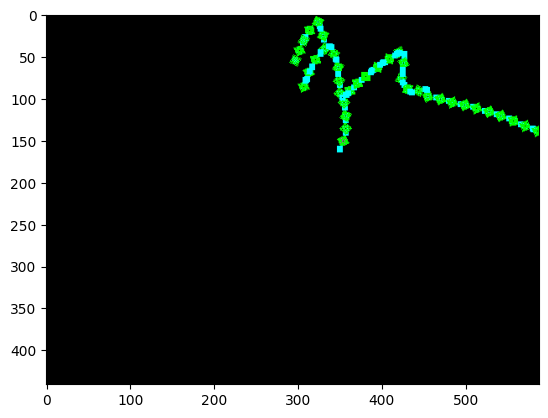

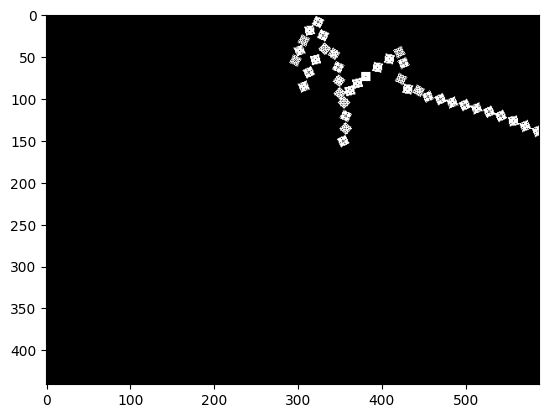

Q:  deque([[212, 333]])
placed tile at point:  (206, 322)
wasted time on point:  (218, 324)
wasted time on point:  (213, 343)
wasted time on point:  (202, 332)
placed tile at point:  (211, 348)
placed tile at point:  (197, 331)
Intersection inside mask
placed tile at point:  (220, 319)
wasted time on point:  (199, 318)
placed tile at point:  (194, 319)
Intersection inside mask
wasted time on point:  (215, 313)
wasted time on point:  (192, 331)
Intersection inside mask
placed tile at point:  (188, 355)
wasted time on point:  (209, 358)
placed tile at point:  (185, 342)
wasted time on point:  (188, 324)
Intersection inside mask
wasted time on point:  (187, 331)
wasted time on point:  (184, 320)
wasted time on point:  (179, 352)
Intersection inside mask
placed tile at point:  (201, 362)
placed tile at point:  (183, 326)
wasted time on point:  (208, 363)
wasted time on point:  (194, 366)
placed tile at point:  (174, 346)
wasted time on point:  (207, 368)
wasted time on point:  (179, 321)
p

wasted time on point:  (190, 368)
Intersection inside mask
Intersection inside mask
wasted time on point:  (185, 370)
Intersection inside mask
Intersection inside mask
wasted time on point:  (206, 383)
wasted time on point:  (179, 375)
wasted time on point:  (182, 353)
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (214, 339)
wasted time on point:  (177, 351)
wasted time on point:  (204, 332)
Intersection inside mask
wasted time on point:  (195, 331)
wasted time on point:  (167, 382)
wasted time on point:  (180, 328)
wasted time on point:  (206, 393)
placed tile at point:  (231, 398)
wasted time on point:  (206, 398)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
placed tile at point:  (222, 406)
wasted time on point:  (156, 389)
Intersection inside mask
wasted time on point:  (237, 393)
wasted time on point:  (171, 317)
placed tile at point:  (206, 403)
Q:  

placed tile at point:  (168, 412)
wasted time on point:  (196, 417)
wasted time on point:  (209, 415)
placed tile at point:  (192, 421)
wasted time on point:  (164, 417)
Q:  deque([(240, 388), (206, 388), (163, 292), (161, 304), (161, 386), (231, 398), (222, 406), (206, 403), (147, 296), (140, 307), (176, 404), (162, 401), (199, 412), (147, 396), (168, 412), (192, 421)])
Intersection inside mask
placed tile at point:  (248, 379)
Intersection inside mask
wasted time on point:  (229, 401)
placed tile at point:  (256, 370)
Intersection inside mask
Intersection inside mask
Intersection inside mask
placed tile at point:  (212, 414)
wasted time on point:  (262, 361)
Intersection inside mask
Intersection inside mask
wasted time on point:  (208, 364)
wasted time on point:  (207, 371)
Intersection inside mask
Intersection inside mask
placed tile at point:  (264, 356)
Intersection inside mask
wasted time on point:  (204, 360)
Intersection inside mask
Intersection inside mask
Q:  deque([(206, 388

wasted time on point:  (110, 306)
Intersection inside mask
placed tile at point:  (111, 270)
Intersection inside mask
placed tile at point:  (105, 305)
Q:  deque([(140, 307), (176, 404), (162, 401), (199, 412), (147, 396), (168, 412), (192, 421), (248, 379), (256, 370), (212, 414), (264, 356), (160, 421), (132, 298), (136, 252), (125, 308), (174, 429), (161, 434), (122, 262), (116, 299), (111, 270), (105, 305)])
wasted time on point:  (130, 308)
wasted time on point:  (139, 297)
Intersection inside mask
Intersection inside mask
wasted time on point:  (150, 306)
wasted time on point:  (153, 294)
Intersection inside mask
Intersection inside mask
wasted time on point:  (156, 294)
wasted time on point:  (120, 308)
wasted time on point:  (121, 299)
wasted time on point:  (115, 307)
Intersection inside mask
wasted time on point:  (166, 304)
wasted time on point:  (111, 299)
wasted time on point:  (173, 289)
Intersection inside mask
wasted time on point:  (171, 303)
Intersection inside mask
I

wasted time on point:  (284, 319)
Q:  deque([(160, 421), (132, 298), (136, 252), (125, 308), (174, 429), (161, 434), (122, 262), (116, 299), (111, 270), (105, 305), (273, 342), (279, 328)])
Intersection inside mask
wasted time on point:  (168, 432)
wasted time on point:  (153, 430)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (185, 424)
wasted time on point:  (190, 421)
wasted time on point:  (156, 390)
Intersection inside mask
wasted time on point:  (168, 382)
Intersection inside mask
Q:  deque([(132, 298), (136, 252), (125, 308), (174, 429), (161, 434), (122, 262), (116, 299), (111, 270), (105, 305), (273, 342), (279, 328)])
Intersection inside mask
wasted time on point:  (130, 308)
wasted time on point:  (133, 308)
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (115, 307)
Intersecti

wasted time on point:  (290, 304)
Intersection inside mask
Intersection inside mask
wasted time on point:  (259, 365)
Q:  deque([(96, 298), (99, 282), (147, 245), (158, 239), (169, 235), (170, 222), (181, 227), (160, 215), (286, 314)])
Intersection inside mask
wasted time on point:  (94, 287)
wasted time on point:  (111, 299)
Intersection inside mask
Intersection inside mask
wasted time on point:  (115, 307)
wasted time on point:  (101, 279)
Intersection inside mask
wasted time on point:  (120, 308)
wasted time on point:  (121, 299)
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (130, 308)
Intersection inside mask
Intersection inside mask
Q:  deque([(99, 282), (147, 245), (158, 239), (169, 235), (170, 222), (181, 227), (160, 215), (286, 314)])
wasted time on point:  (90, 291)
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (88, 295)
wasted time on point:  (117, 265)
Intersection inside 

Intersection inside mask
Intersection inside mask
wasted time on point:  (107, 151)
Intersection inside mask
wasted time on point:  (103, 147)
Intersection inside mask
wasted time on point:  (127, 141)
wasted time on point:  (98, 142)
Intersection inside mask
wasted time on point:  (122, 135)
wasted time on point:  (144, 138)
wasted time on point:  (114, 134)
Intersection inside mask
wasted time on point:  (100, 131)
placed tile at point:  (124, 130)
Intersection inside mask
Intersection inside mask
wasted time on point:  (153, 210)
placed tile at point:  (165, 136)
Q:  deque([(224, 240), (238, 242), (114, 142), (112, 156), (136, 140), (101, 140), (124, 130), (165, 136)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (249, 243)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Q:  deque([(238, 242), (114, 142), (112, 156), (136, 140), (101, 140), (124, 130), (1

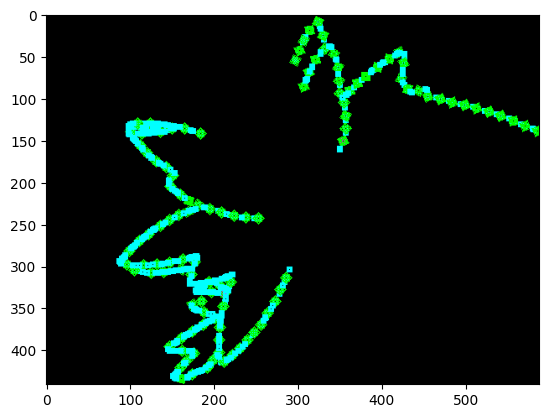

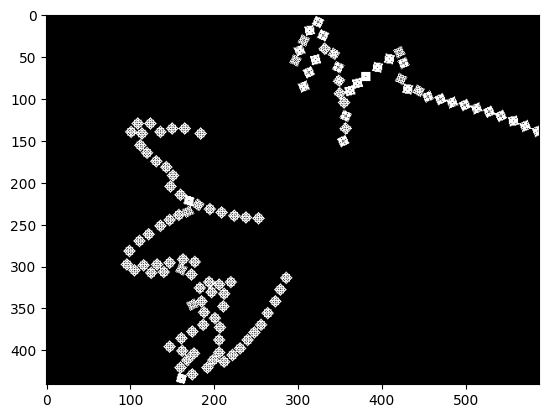

Q:  deque([[295, 87]])
placed tile at point:  (299, 98)
placed tile at point:  (284, 93)
Intersection inside mask
Intersection inside mask
wasted time on point:  (296, 77)
wasted time on point:  (286, 82)
Intersection inside mask
wasted time on point:  (306, 104)
wasted time on point:  (280, 84)
placed tile at point:  (295, 72)
placed tile at point:  (312, 109)
placed tile at point:  (273, 97)
wasted time on point:  (274, 90)
wasted time on point:  (292, 66)
Intersection inside mask
wasted time on point:  (290, 61)
Intersection inside mask
wasted time on point:  (316, 116)
wasted time on point:  (270, 88)
placed tile at point:  (266, 108)
wasted time on point:  (322, 110)
placed tile at point:  (265, 83)
Intersection inside mask
wasted time on point:  (288, 55)
placed tile at point:  (328, 105)
placed tile at point:  (285, 50)
Intersection inside mask
wasted time on point:  (265, 118)
wasted time on point:  (333, 100)
placed tile at point:  (264, 123)
wasted time on point:  (256, 77)
w

placed tile at point:  (262, 16)
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (246, 70)
wasted time on point:  (280, 85)
wasted time on point:  (255, 13)
wasted time on point:  (248, 31)
wasted time on point:  (273, 89)
Intersection inside mask
wasted time on point:  (241, 71)
Intersection inside mask
Q:  deque([(264, 123), (248, 123), (252, 74), (279, 39), (271, 28), (316, 120), (245, 57), (231, 109), (236, 74), (222, 100), (247, 40), (262, 16)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (271, 89)
wasted time on point:  (303, 102)
wasted time on point:  (280, 85)
wasted time on point:  (226, 106)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Q:  deque([(248, 123), (252, 74), (279, 39), (271, 28), (316, 120), (245, 57), (231, 1

wasted time on point:  (232, 92)
wasted time on point:  (212, 97)
Intersection inside mask
Intersection inside mask
wasted time on point:  (208, 94)
wasted time on point:  (233, 117)
Intersection inside mask
Intersection inside mask
wasted time on point:  (233, 81)
wasted time on point:  (203, 91)
wasted time on point:  (229, 81)
Intersection inside mask
wasted time on point:  (198, 89)
Intersection inside mask
wasted time on point:  (234, 77)
wasted time on point:  (216, 69)
wasted time on point:  (194, 87)
wasted time on point:  (196, 70)
Intersection inside mask
wasted time on point:  (239, 72)
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (246, 68)
Intersection inside mask
placed tile at point:  (189, 86)
wasted time on point:  (183, 134)
placed tile at point:  (191, 55)
wasted time on point:  (185, 81)
placed tile at point:  (177, 126)
Intersection inside mask
wasted time on point:  (258, 128)
Q:  deque([(247, 40), (262, 16), (23

Intersection inside mask
wasted time on point:  (210, 85)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (185, 53)
wasted time on point:  (213, 97)
Intersection inside mask
wasted time on point:  (227, 79)
wasted time on point:  (177, 71)
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (231, 83)
Intersection inside mask
wasted time on point:  (170, 84)
wasted time on point:  (173, 64)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (168, 64)
wasted time on point:  (245, 62)
placed tile at point:  (163, 63)
Intersection inside mask
wasted time on point:  (243, 70)
Intersection inside mask
Intersection inside mask
Q:  

wasted time on point:  (174, 119)
wasted time on point:  (167, 97)
wasted time on point:  (177, 124)
wasted time on point:  (166, 92)
Intersection inside mask
Intersection inside mask
wasted time on point:  (174, 83)
wasted time on point:  (191, 86)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (207, 93)
Intersection inside mask
wasted time on point:  (190, 147)
wasted time on point:  (211, 96)
wasted time on point:  (177, 69)
Intersection inside mask
Intersection inside mask
Q:  deque([(178, 49), (166, 90), (163, 63), (150, 60), (192, 154), (197, 165), (136, 60)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (177, 69)
wasted time on point:  (197, 58)
Intersection inside mask
wasted time on point:  (181, 70)
In

wasted time on point:  (72, 53)
Intersection inside mask
placed tile at point:  (72, 58)
Q:  deque([(81, 73), (84, 31), (114, 10), (125, 3), (74, 45), (72, 58)])
Intersection inside mask
Intersection inside mask
wasted time on point:  (72, 56)
wasted time on point:  (102, 66)
wasted time on point:  (74, 47)
Intersection inside mask
wasted time on point:  (113, 63)
wasted time on point:  (76, 42)
wasted time on point:  (79, 37)
Intersection inside mask
Intersection inside mask
Q:  deque([(84, 31), (114, 10), (125, 3), (74, 45), (72, 58)])
wasted time on point:  (78, 40)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (72, 60)
Intersection inside mask
Intersection inside mask
wasted time on point:  (73, 65)
Intersection inside mask
Intersection inside mask
wasted time on point:  (73, 70)
Intersection inside mask
Q:  deque([(114, 10), (125, 

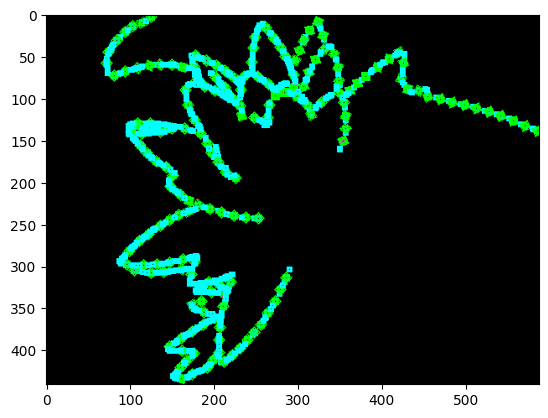

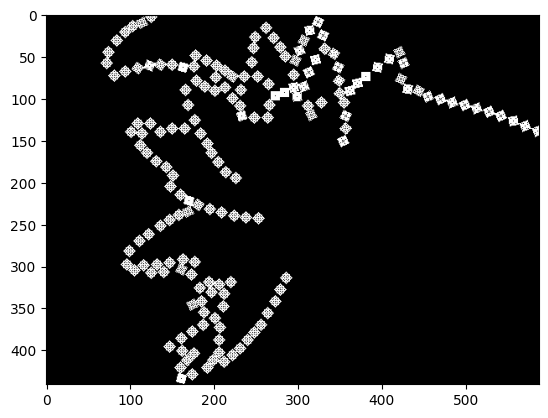

Q:  deque([[500, 176]])
wasted time on point:  (490, 174)
placed tile at point:  (505, 187)
Intersection inside mask
wasted time on point:  (510, 178)
wasted time on point:  (500, 191)
placed tile at point:  (485, 173)
placed tile at point:  (493, 195)
wasted time on point:  (480, 173)
wasted time on point:  (488, 199)
wasted time on point:  (475, 172)
placed tile at point:  (470, 171)
placed tile at point:  (481, 203)
wasted time on point:  (474, 207)
Intersection inside mask
placed tile at point:  (466, 211)
wasted time on point:  (460, 170)
Q:  deque([(505, 187), (485, 173), (493, 195), (470, 171), (481, 203), (466, 211)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (502, 176)
Intersection inside mask
wasted time on point:  (510, 178)
wasted time on point:  (488, 199)
wasted time on point:  (492, 175)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (477, 1

Intersection inside mask
wasted time on point:  (387, 180)
wasted time on point:  (430, 168)
wasted time on point:  (435, 168)
wasted time on point:  (374, 199)
wasted time on point:  (445, 168)
placed tile at point:  (368, 207)
Intersection inside mask
wasted time on point:  (450, 169)
wasted time on point:  (363, 211)
Intersection inside mask
Q:  deque([(402, 226), (430, 260), (423, 270), (411, 274), (395, 276), (390, 223), (377, 276), (393, 176), (382, 184), (379, 214), (376, 196), (368, 207)])
wasted time on point:  (393, 221)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (420, 242)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (370, 204)
Intersection inside mask
Intersection inside 

Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (368, 274)
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (382, 276)
Intersection inside mask
wasted time on point:  (387, 277)
Intersection inside mask
Q:  deque([(338, 264), (345, 223), (327, 257)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (324, 255)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Q:  deque([(345, 223), (327, 257)])
wasted time on point:  (362, 212)
Intersection inside mask
wasted time on point:  (372, 212)
wasted time on point:  (372, 202)
Intersection inside mask
wasted time on point:  (377, 214)
wasted time on point:  (324, 255)
Intersection inside mask
Intersection inside mask
wasted time on point:  (335, 262)
Intersection inside mask
wasted time on point:  (386, 217)
Q:  deque([(327, 

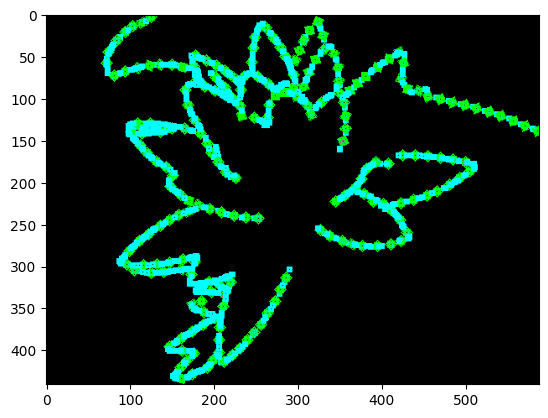

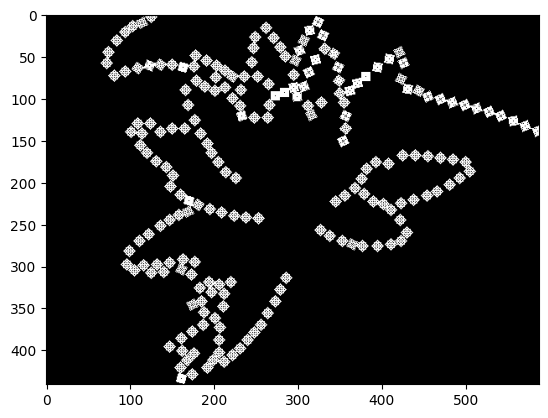

Q:  deque([[367, 396]])
placed tile at point:  (362, 385)
wasted time on point:  (358, 390)
placed tile at point:  (376, 403)
Intersection inside mask
wasted time on point:  (357, 379)
wasted time on point:  (353, 386)
wasted time on point:  (381, 406)
wasted time on point:  (381, 403)
placed tile at point:  (350, 373)
wasted time on point:  (349, 383)
wasted time on point:  (385, 409)
wasted time on point:  (346, 368)
placed tile at point:  (390, 412)
wasted time on point:  (344, 380)
Intersection inside mask
wasted time on point:  (340, 377)
placed tile at point:  (399, 420)
placed tile at point:  (335, 374)
wasted time on point:  (330, 371)
Intersection inside mask
Q:  deque([(362, 385), (376, 403), (350, 373), (390, 412), (399, 420), (335, 374)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (352, 385)
Intersection inside mask
Intersection inside mask
wasted time on point:  (347, 382)
Intersection inside mask
Intersection inside m

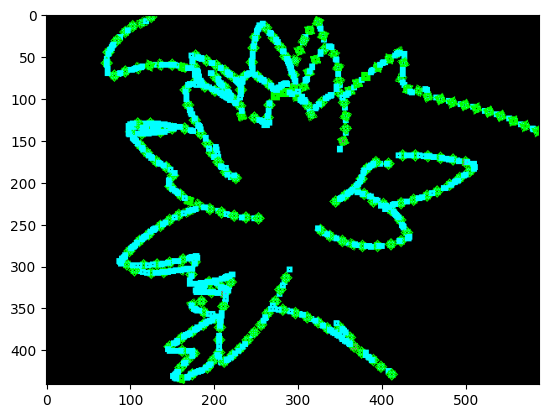

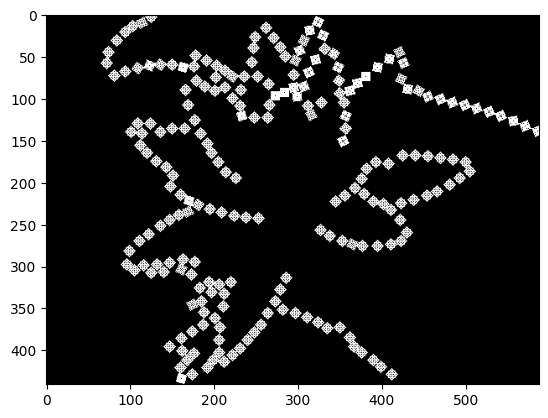

Q:  deque([[77, 216]])
wasted time on point:  (67, 215)
wasted time on point:  (87, 217)
placed tile at point:  (92, 217)
placed tile at point:  (62, 215)
Intersection inside mask
Intersection inside mask
wasted time on point:  (102, 218)
wasted time on point:  (52, 214)
placed tile at point:  (107, 218)
placed tile at point:  (47, 213)
Intersection inside mask
Intersection inside mask
wasted time on point:  (117, 219)
wasted time on point:  (37, 211)
Q:  deque([(92, 217), (62, 215), (107, 218), (47, 213)])
wasted time on point:  (102, 218)
wasted time on point:  (82, 216)
Intersection inside mask
wasted time on point:  (72, 216)
wasted time on point:  (67, 215)
wasted time on point:  (117, 219)
placed tile at point:  (122, 219)
wasted time on point:  (127, 219)
Intersection inside mask
Intersection inside mask
wasted time on point:  (132, 219)
Q:  deque([(62, 215), (107, 218), (47, 213), (122, 219)])
wasted time on point:  (72, 216)
Intersection inside mask
Intersection inside mask
wa

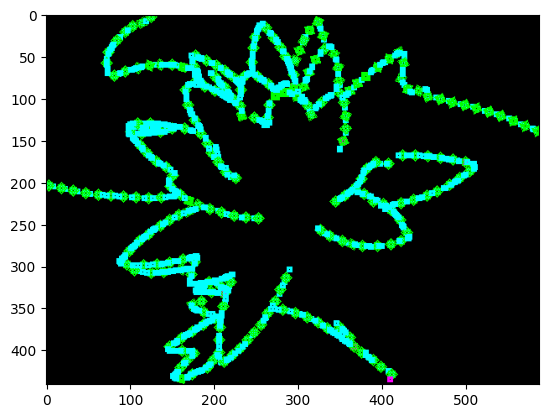

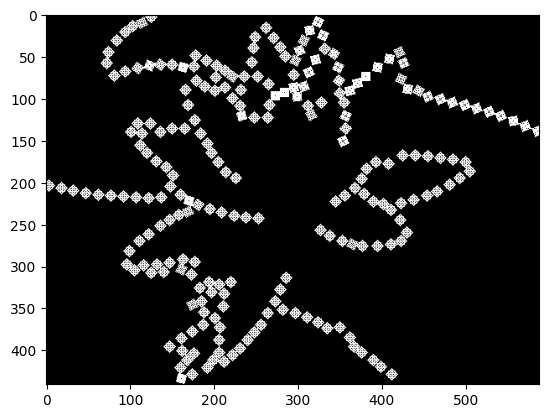

Q:  deque([[503, 321]])
wasted time on point:  (506, 332)
placed tile at point:  (494, 314)
wasted time on point:  (494, 312)
Intersection inside mask
Intersection inside mask
wasted time on point:  (501, 310)
wasted time on point:  (493, 322)
wasted time on point:  (495, 305)
wasted time on point:  (488, 320)
wasted time on point:  (490, 305)
wasted time on point:  (500, 305)
placed tile at point:  (499, 300)
wasted time on point:  (484, 310)
Intersection inside mask
wasted time on point:  (495, 294)
placed tile at point:  (494, 289)
wasted time on point:  (483, 287)
Intersection inside mask
placed tile at point:  (481, 282)
wasted time on point:  (502, 285)
wasted time on point:  (473, 286)
wasted time on point:  (488, 283)
wasted time on point:  (488, 278)
Intersection inside mask
placed tile at point:  (468, 287)
Q:  deque([(494, 314), (499, 300), (494, 289), (481, 282), (468, 287)])
Intersection inside mask
wasted time on point:  (484, 310)
wasted time on point:  (495, 324)
Inters

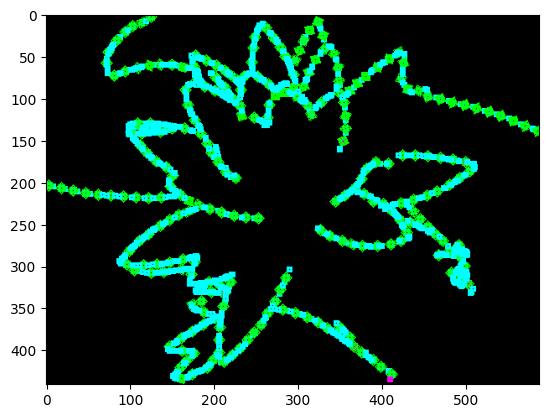

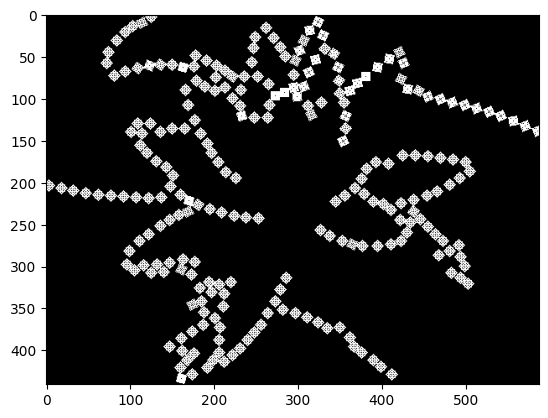

Q:  deque([[367, 31]])
wasted time on point:  (376, 36)
placed tile at point:  (358, 24)
wasted time on point:  (353, 21)
placed tile at point:  (381, 41)
Intersection inside mask
placed tile at point:  (349, 17)
wasted time on point:  (344, 14)
wasted time on point:  (390, 47)
placed tile at point:  (394, 50)
wasted time on point:  (399, 54)
Q:  deque([(358, 24), (381, 41), (349, 17), (394, 50)])
wasted time on point:  (344, 14)
wasted time on point:  (372, 34)
wasted time on point:  (376, 36)
Intersection inside mask
Intersection inside mask
Q:  deque([(381, 41), (349, 17), (394, 50)])
wasted time on point:  (372, 34)
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (399, 54)
Intersection inside mask
Intersection inside mask
Q:  deque([(349, 17), (394, 50)])
Intersection inside mask
wasted time on point:  (372, 34)
wasted time on point:  (376, 36)
wasted time on point:  (316, 1)
Intersection inside mask
placed tile at point:  (311, 0)


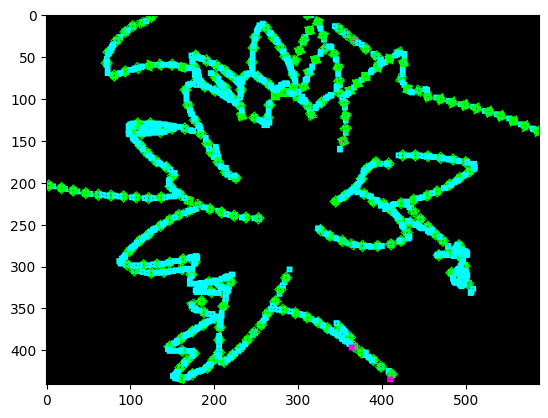

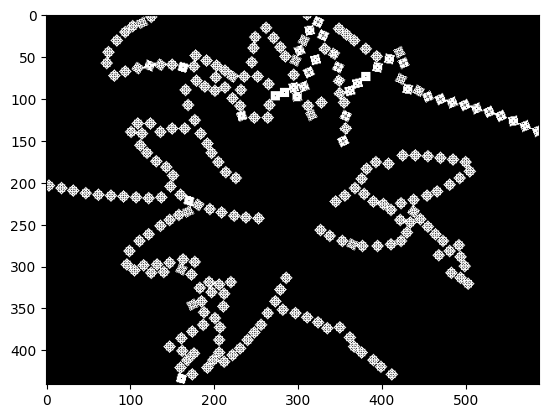

Q:  deque([[42, 384]])
placed tile at point:  (33, 376)
placed tile at point:  (51, 393)
wasted time on point:  (55, 400)
Intersection inside mask
placed tile at point:  (24, 369)
placed tile at point:  (59, 407)
wasted time on point:  (19, 366)
wasted time on point:  (63, 412)
placed tile at point:  (67, 416)
placed tile at point:  (15, 362)
wasted time on point:  (72, 420)
Intersection inside mask
placed tile at point:  (76, 424)
wasted time on point:  (6, 358)
Q:  deque([(33, 376), (51, 393), (24, 369), (59, 407), (67, 416), (15, 362), (76, 424)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (55, 400)
wasted time on point:  (10, 359)
wasted time on point:  (5, 358)
Intersection inside mask
Intersection inside mask
placed tile at point:  (1, 357)
Q:  deque([(51, 393), (24, 369), (59, 407), (67, 416), (15, 362), (76, 424), (1, 357)])
wasted time on point:  (57, 404)
wasted time on point:  (61, 410)
Intersect

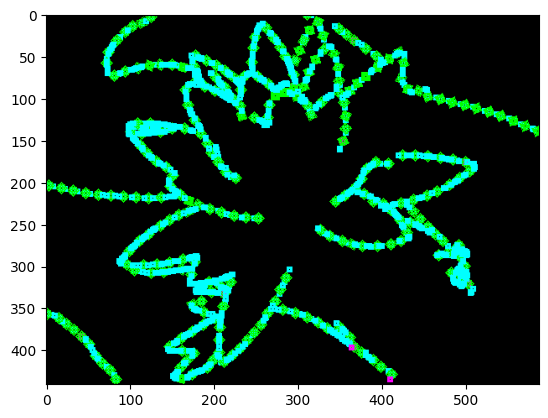

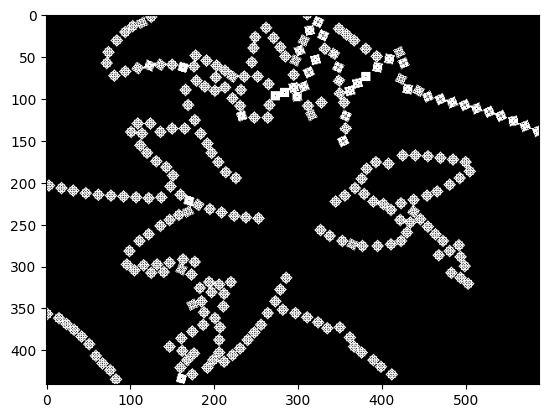

Q:  deque([[35, 69]])
wasted time on point:  (34, 79)
placed tile at point:  (35, 84)
wasted time on point:  (42, 90)
wasted time on point:  (29, 88)
Intersection inside mask
placed tile at point:  (24, 93)
wasted time on point:  (38, 95)
placed tile at point:  (45, 96)
wasted time on point:  (42, 101)
placed tile at point:  (1, 89)
placed tile at point:  (12, 96)
wasted time on point:  (47, 106)
placed tile at point:  (52, 112)
Q:  deque([(35, 84), (24, 93), (45, 96), (1, 89), (12, 96), (52, 112)])
wasted time on point:  (38, 95)
Intersection inside mask
wasted time on point:  (45, 87)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (47, 106)
Intersection inside mask
Intersection inside mask
wasted time on point:  (3, 96)
wasted time on point:  (57, 118)
placed tile at point:  (62, 124)
wasted time on point:  (66, 129)
Q:  deque([(24, 93), (45, 96), (1, 89), (12, 96), (52, 112), (62, 12

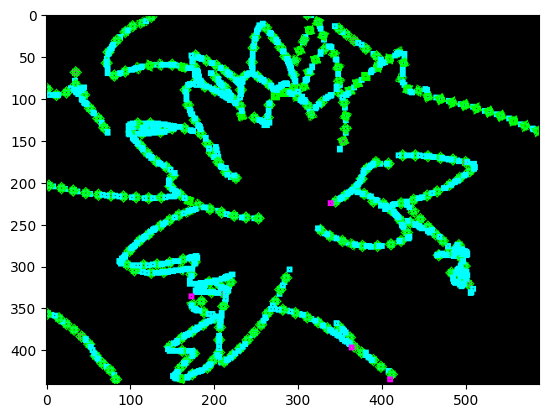

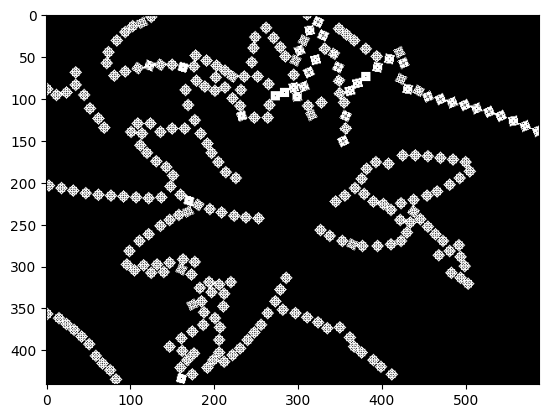

Q:  deque([[318, 196]])
placed tile at point:  (310, 185)
placed tile at point:  (311, 205)
wasted time on point:  (323, 187)
placed tile at point:  (331, 212)
Intersection inside mask
Intersection inside mask
wasted time on point:  (305, 180)
wasted time on point:  (308, 179)
wasted time on point:  (308, 210)
placed tile at point:  (301, 178)
Intersection inside mask
placed tile at point:  (339, 179)
wasted time on point:  (308, 174)
placed tile at point:  (296, 208)
wasted time on point:  (326, 217)
wasted time on point:  (307, 215)
Intersection inside mask
placed tile at point:  (306, 219)
placed tile at point:  (320, 222)
Intersection inside mask
wasted time on point:  (291, 205)
placed tile at point:  (308, 169)
Intersection inside mask
wasted time on point:  (286, 203)
wasted time on point:  (340, 169)
placed tile at point:  (281, 206)
placed tile at point:  (340, 164)
placed tile at point:  (274, 218)
wasted time on point:  (276, 209)
Intersection inside mask
Q:  deque([(310, 18

wasted time on point:  (313, 225)
wasted time on point:  (241, 204)
wasted time on point:  (243, 192)
Intersection inside mask
wasted time on point:  (324, 188)
Intersection inside mask
Q:  deque([(340, 164), (274, 218), (337, 149), (335, 197), (331, 137), (259, 218), (250, 210), (249, 183)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (335, 143)
Intersection inside mask
wasted time on point:  (312, 182)
wasted time on point:  (337, 189)
wasted time on point:  (313, 173)
wasted time on point:  (323, 187)
Intersection inside mask
Intersection inside mask
wasted time on point:  (308, 174)
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (335, 199)
Intersection inside mask
wasted time on point:  (334, 204)
Q:  deque([(274, 218), (337, 149), (335, 197), (331, 137), (259, 218), (250, 210), (249, 183)])
Intersection inside mask
wasted time on point:  (275, 208)
wasted time on point:  (272, 

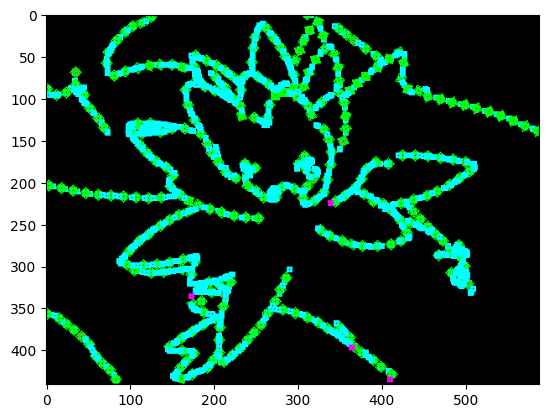

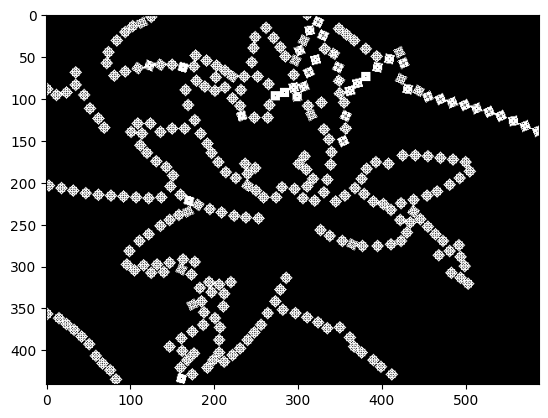

Q:  deque([[224, 181]])
wasted time on point:  (224, 171)
wasted time on point:  (228, 192)
placed tile at point:  (226, 166)
wasted time on point:  (240, 173)
Intersection inside mask
Intersection inside mask
wasted time on point:  (245, 177)
wasted time on point:  (235, 203)
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (242, 214)
wasted time on point:  (245, 220)
placed tile at point:  (247, 225)
Q:  deque([(226, 166), (247, 225)])
Intersection inside mask
wasted time on point:  (236, 170)
wasted time on point:  (236, 165)
wasted time on point:  (236, 167)
wasted time on point:  (240, 173)
wasted time on point:  (245, 177)
Intersection inside mask
wasted time on point:  (228, 192)
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (235, 203)
Intersection inside mask
Q:  deque([(247, 225)])
wasted time on point:  (242, 214)
Intersection inside mask
wasted time on point:  (260, 237)
wast

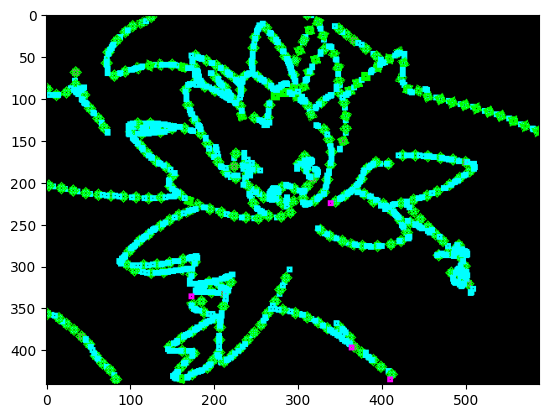

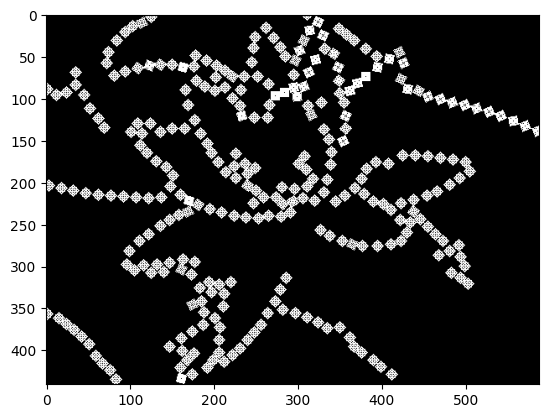

Q:  deque([[526, 364]])
wasted time on point:  (527, 374)
wasted time on point:  (532, 355)
placed tile at point:  (535, 372)
placed tile at point:  (534, 355)
Intersection inside mask
wasted time on point:  (523, 353)
wasted time on point:  (535, 381)
placed tile at point:  (524, 349)
Intersection inside mask
wasted time on point:  (528, 379)
wasted time on point:  (531, 350)
Intersection inside mask
wasted time on point:  (542, 361)
wasted time on point:  (531, 380)
wasted time on point:  (538, 381)
wasted time on point:  (539, 378)
placed tile at point:  (530, 385)
Intersection inside mask
placed tile at point:  (517, 383)
Intersection inside mask
wasted time on point:  (521, 343)
placed tile at point:  (519, 338)
Intersection inside mask
wasted time on point:  (533, 390)
wasted time on point:  (509, 387)
wasted time on point:  (517, 332)
placed tile at point:  (505, 391)
placed tile at point:  (534, 396)
wasted time on point:  (536, 401)
wasted time on point:  (505, 396)
placed til

wasted time on point:  (506, 398)
wasted time on point:  (510, 412)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (536, 401)
Intersection inside mask
wasted time on point:  (507, 382)
Intersection inside mask
wasted time on point:  (535, 381)
Intersection inside mask
wasted time on point:  (540, 377)
wasted time on point:  (527, 374)
wasted time on point:  (532, 370)
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (533, 365)
Q:  deque([(542, 363)])
wasted time on point:  (531, 367)
wasted time on point:  (536, 352)
wasted time on point:  (532, 361)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (527, 376)
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (541, 378)


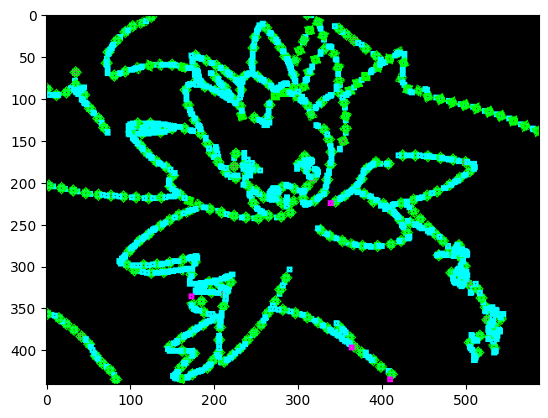

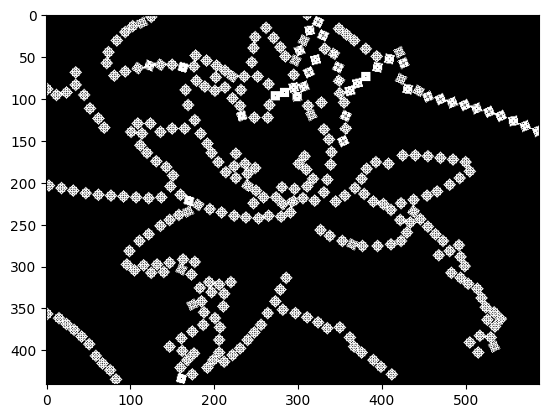

Q:  deque([[445, 12]])
wasted time on point:  (455, 12)
wasted time on point:  (435, 10)
placed tile at point:  (460, 13)
placed tile at point:  (430, 10)
Intersection inside mask
Intersection inside mask
wasted time on point:  (420, 8)
wasted time on point:  (471, 10)
placed tile at point:  (476, 9)
placed tile at point:  (415, 7)
Intersection inside mask
Intersection inside mask
placed tile at point:  (487, 4)
wasted time on point:  (406, 5)
Q:  deque([(460, 13), (430, 10), (476, 9), (415, 7), (487, 4)])
Intersection inside mask
wasted time on point:  (450, 12)
Intersection inside mask
Intersection inside mask
wasted time on point:  (435, 10)
Intersection inside mask
Intersection inside mask
Q:  deque([(430, 10), (476, 9), (415, 7), (487, 4)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (450, 12)
wasted time on point:  (405, 5)
Intersection inside mask
placed tile at point:  (401, 4)
Intersection inside mask
Intersection inside ma

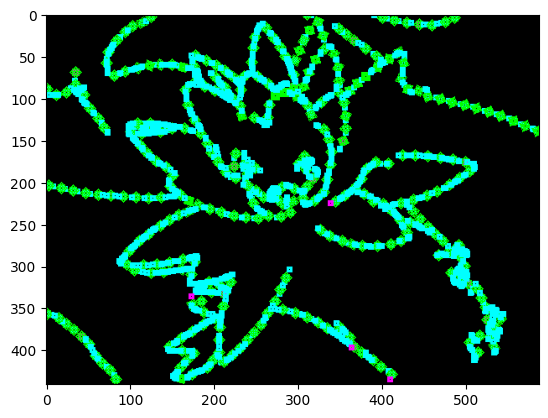

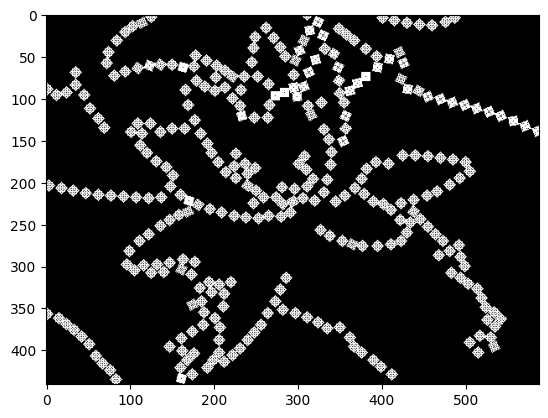

Q:  deque([[31, 410]])
wasted time on point:  (22, 404)
placed tile at point:  (40, 417)
wasted time on point:  (45, 420)
placed tile at point:  (17, 402)
wasted time on point:  (49, 422)
Intersection inside mask
placed tile at point:  (8, 395)
placed tile at point:  (54, 425)
wasted time on point:  (3, 392)
wasted time on point:  (59, 428)
wasted time on point:  (63, 431)
placed tile at point:  (68, 433)
Q:  deque([(40, 417), (17, 402), (8, 395), (54, 425), (68, 433)])
wasted time on point:  (49, 422)
wasted time on point:  (26, 407)
wasted time on point:  (59, 428)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (3, 392)
wasted time on point:  (77, 438)
Q:  deque([(17, 402), (8, 395), (54, 425), (68, 433)])
Intersection inside mask
wasted time on point:  (26, 407)
wasted time on point:  (3, 392)
Intersection inside mask
wasted time on point:  (45, 420)
wasted time on point:  (49, 422)


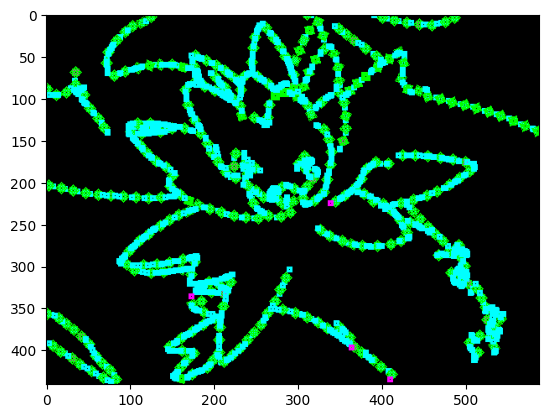

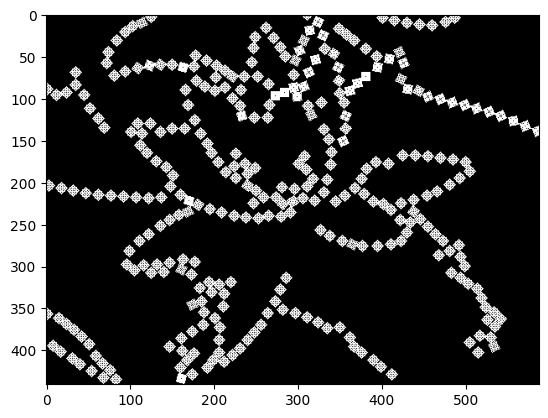

Q:  deque([[363, 338]])
wasted time on point:  (361, 348)
wasted time on point:  (364, 328)
placed tile at point:  (363, 323)
placed tile at point:  (359, 353)
wasted time on point:  (363, 318)
wasted time on point:  (358, 363)
wasted time on point:  (362, 313)
placed tile at point:  (361, 307)
Intersection inside mask
wasted time on point:  (359, 297)
Q:  deque([(363, 323), (359, 353), (361, 307)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (359, 297)
Intersection inside mask
placed tile at point:  (358, 292)
Intersection inside mask
Intersection inside mask
wasted time on point:  (358, 363)
wasted time on point:  (356, 281)
Q:  deque([(359, 353), (361, 307), (358, 292)])
Intersection inside mask
wasted time on point:  (358, 363)
Intersection inside mask
Intersection inside mask
wasted time on point:  (363, 318)
Intersection inside mask
Q:  deque([(361, 307), (358, 292)])
wasted ti

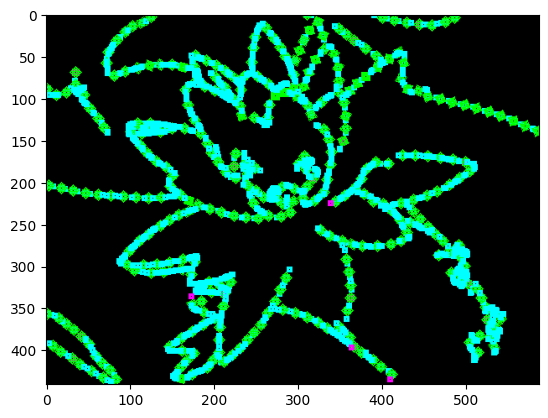

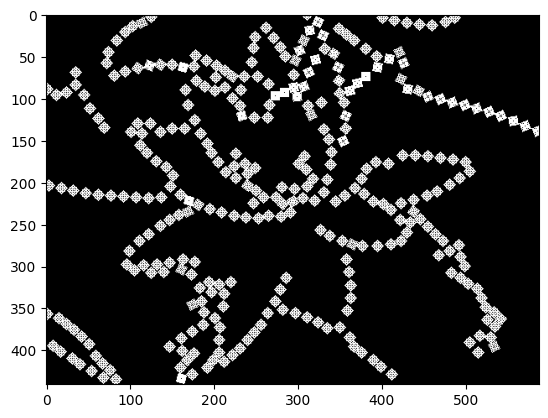

Q:  deque([[316, 337]])
placed tile at point:  (325, 346)
placed tile at point:  (308, 327)
wasted time on point:  (304, 320)
Intersection inside mask
placed tile at point:  (300, 314)
placed tile at point:  (334, 354)
Intersection inside mask
Intersection inside mask
placed tile at point:  (342, 362)
placed tile at point:  (294, 303)
Intersection inside mask
Q:  deque([(325, 346), (308, 327), (300, 314), (334, 354), (342, 362), (294, 303)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (304, 321)
wasted time on point:  (347, 365)
Intersection inside mask
wasted time on point:  (296, 306)
wasted time on point:  (294, 301)
Q:  deque([(308, 327), (300, 314), (334, 354), (342, 362), (294, 303)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside m

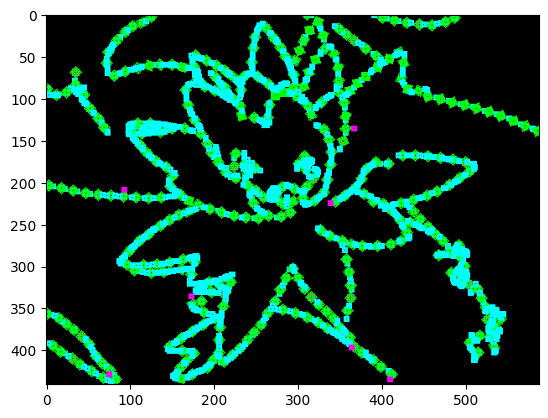

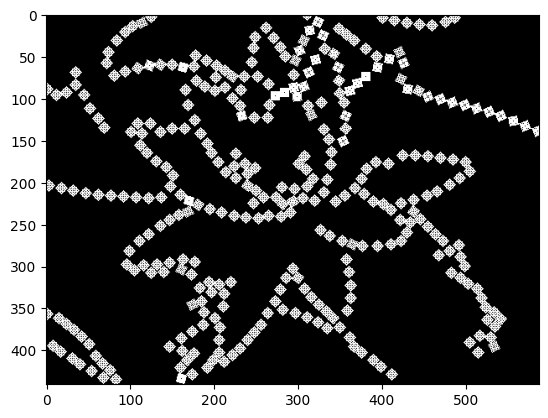

Q:  deque([[413, 163]])
placed tile at point:  (420, 154)
placed tile at point:  (427, 145)
wasted time on point:  (430, 140)
wasted time on point:  (433, 136)
placed tile at point:  (436, 131)
Intersection inside mask
Q:  deque([(420, 154), (427, 145), (436, 131)])
wasted time on point:  (430, 140)
wasted time on point:  (433, 136)
Intersection inside mask
wasted time on point:  (441, 122)
placed tile at point:  (442, 117)
Q:  deque([(427, 145), (436, 131), (442, 117)])
wasted time on point:  (433, 136)
Intersection inside mask
Intersection inside mask
wasted time on point:  (445, 112)
wasted time on point:  (447, 108)
Q:  deque([(436, 131), (442, 117)])
wasted time on point:  (430, 140)
Intersection inside mask
wasted time on point:  (445, 112)
Intersection inside mask
Intersection inside mask
wasted time on point:  (450, 103)
Q:  deque([(442, 117)])
Intersection inside mask
wasted time on point:  (447, 108)
wasted time on point:  (450, 103)
wasted time on point:  (433, 136)
wasted t

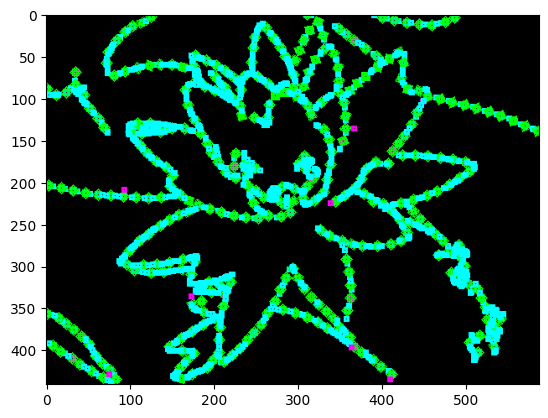

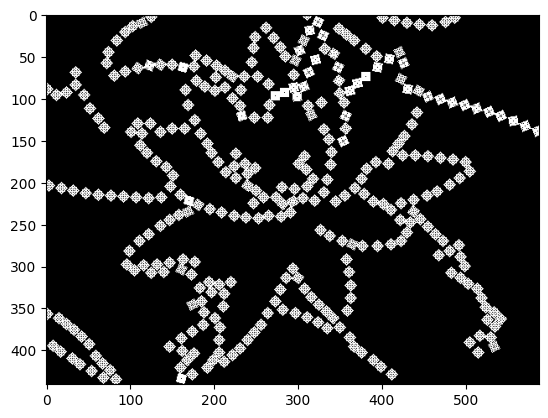

Q:  deque([[45, 199]])


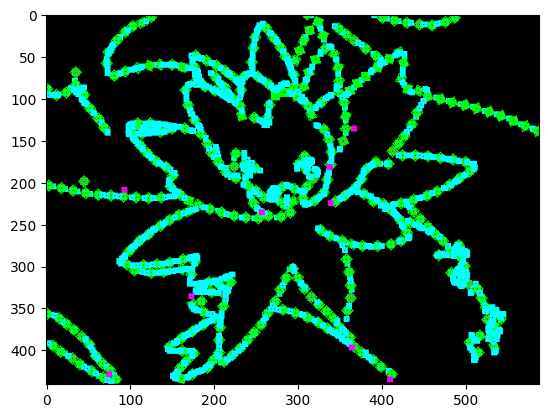

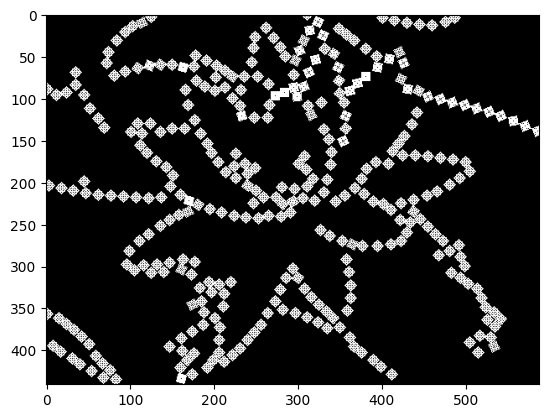

Q:  deque([[99, 207]])
wasted time on point:  (109, 208)
wasted time on point:  (89, 205)
placed tile at point:  (84, 205)
Intersection inside mask
wasted time on point:  (74, 203)
placed tile at point:  (69, 203)
Intersection inside mask
wasted time on point:  (59, 201)
Q:  deque([(84, 205), (69, 203)])
wasted time on point:  (74, 203)
Intersection inside mask
wasted time on point:  (104, 207)
Intersection inside mask
wasted time on point:  (59, 201)
wasted time on point:  (109, 208)
wasted time on point:  (54, 200)
Intersection inside mask
Intersection inside mask
Q:  deque([(69, 203)])
Intersection inside mask
wasted time on point:  (59, 201)
wasted time on point:  (54, 200)
wasted time on point:  (89, 205)
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (104, 207)
wasted time on point:  (109, 208)


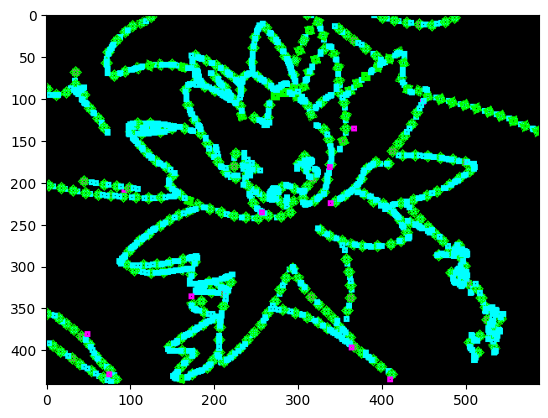

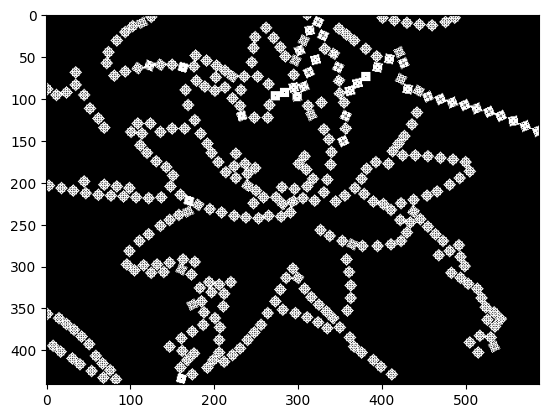

Q:  deque([[152, 346]])
wasted time on point:  (141, 349)
wasted time on point:  (163, 342)
wasted time on point:  (168, 339)
placed tile at point:  (136, 351)
Intersection inside mask
wasted time on point:  (126, 353)
placed tile at point:  (120, 354)
Intersection inside mask
wasted time on point:  (110, 355)
Q:  deque([(136, 351), (120, 354)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (110, 355)
wasted time on point:  (163, 342)
wasted time on point:  (168, 339)
Q:  deque([(120, 354)])
wasted time on point:  (110, 355)
Intersection inside mask
Intersection inside mask
wasted time on point:  (146, 348)
Intersection inside mask
wasted time on point:  (162, 342)


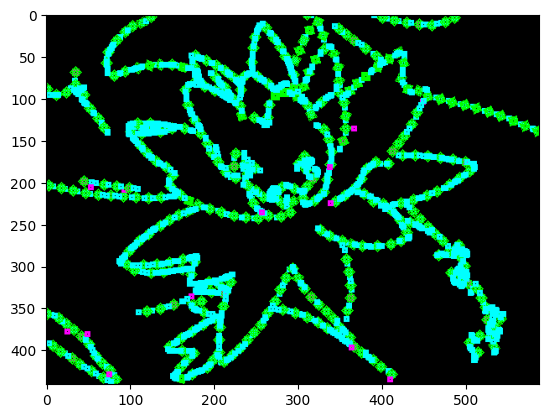

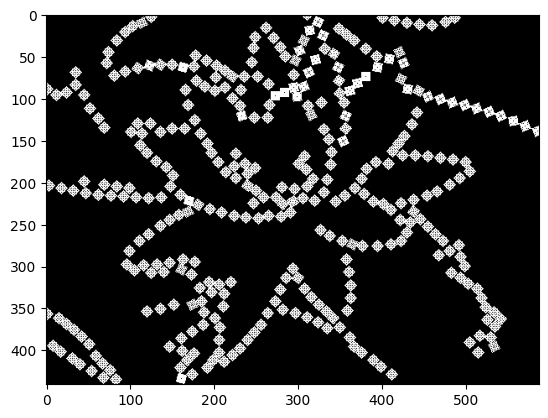

Q:  deque([[489, 93]])
wasted time on point:  (480, 88)
wasted time on point:  (498, 99)
placed tile at point:  (475, 86)
wasted time on point:  (503, 102)
Intersection inside mask
wasted time on point:  (508, 104)
wasted time on point:  (465, 86)
Intersection inside mask
Intersection inside mask
wasted time on point:  (522, 111)
Q:  deque([(475, 86)])
wasted time on point:  (465, 86)
wasted time on point:  (484, 91)
Intersection inside mask
wasted time on point:  (494, 97)
wasted time on point:  (498, 99)
wasted time on point:  (503, 102)
wasted time on point:  (508, 104)
Intersection inside mask


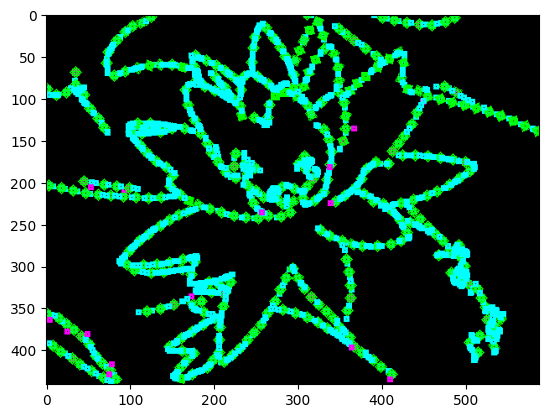

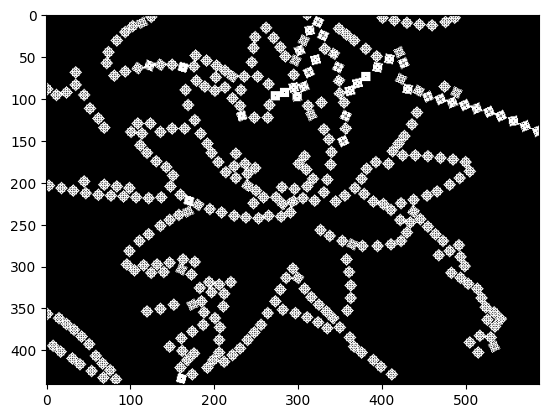

Q:  deque([[460, 430]])
wasted time on point:  (463, 420)
placed tile at point:  (455, 419)
wasted time on point:  (467, 421)
wasted time on point:  (451, 413)
placed tile at point:  (475, 417)
wasted time on point:  (467, 416)
wasted time on point:  (472, 412)
placed tile at point:  (443, 408)
Intersection inside mask
wasted time on point:  (466, 411)
placed tile at point:  (466, 406)
wasted time on point:  (474, 407)
Intersection inside mask
placed tile at point:  (437, 396)
Intersection inside mask
wasted time on point:  (463, 395)
placed tile at point:  (448, 388)
wasted time on point:  (457, 389)
Q:  deque([(455, 419), (475, 417), (443, 408), (466, 406), (437, 396), (448, 388)])
Intersection inside mask
wasted time on point:  (466, 411)
Intersection inside mask
wasted time on point:  (465, 422)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (446, 402)
Intersection inside mask
Intersection inside mask
Inter

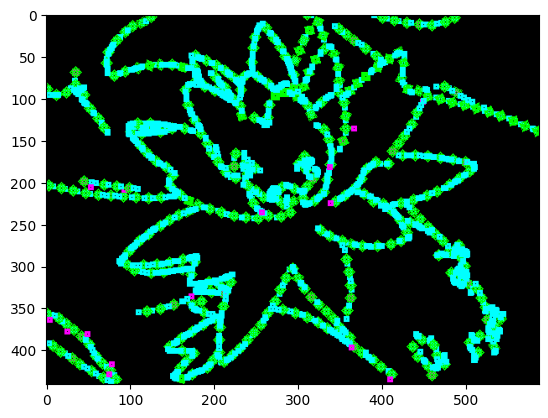

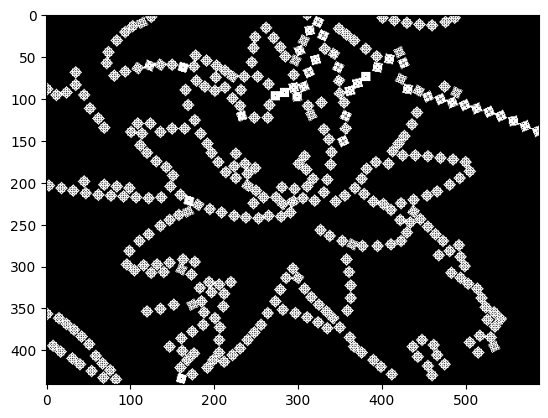

Q:  deque([[55, 45]])
wasted time on point:  (54, 35)
wasted time on point:  (54, 55)
placed tile at point:  (53, 60)
placed tile at point:  (55, 30)
wasted time on point:  (55, 25)
wasted time on point:  (55, 20)
placed tile at point:  (55, 15)
Intersection inside mask
wasted time on point:  (55, 5)
Q:  deque([(53, 60), (55, 30), (55, 15)])
Intersection inside mask
wasted time on point:  (55, 40)
Intersection inside mask
wasted time on point:  (55, 25)
wasted time on point:  (55, 20)
Q:  deque([(55, 30), (55, 15)])
wasted time on point:  (55, 40)
wasted time on point:  (55, 20)
Intersection inside mask
wasted time on point:  (55, 10)
Intersection inside mask
wasted time on point:  (55, 5)
Q:  deque([(55, 15)])
wasted time on point:  (55, 5)
wasted time on point:  (55, 25)
placed tile at point:  (54, 0)
Intersection inside mask
wasted time on point:  (55, 40)
Intersection inside mask
Intersection inside mask
Q:  deque([(54, 0)])
wasted time on point:  (55, 10)
wasted time on point:  (5

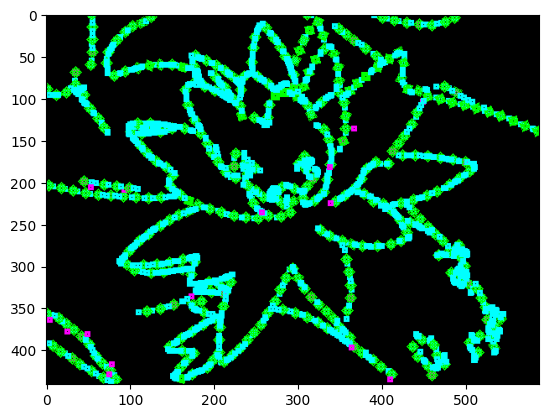

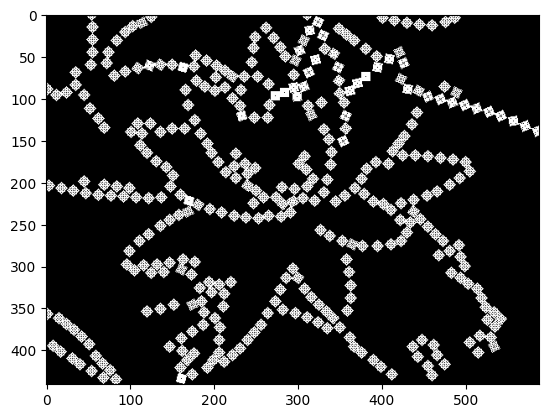

Q:  deque([[263, 47]])
wasted time on point:  (257, 16)


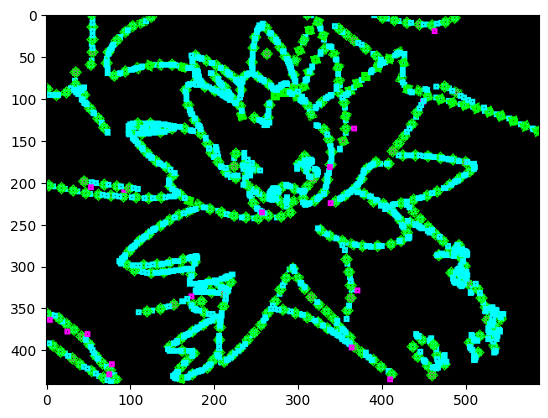

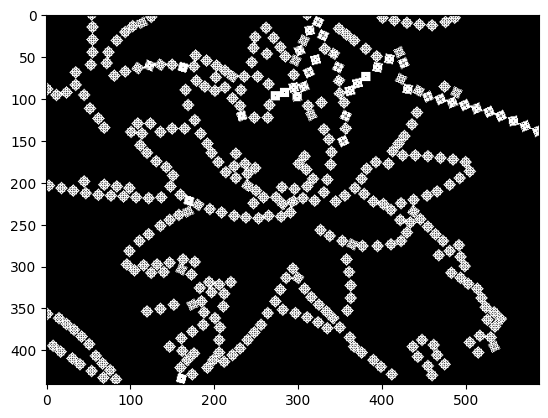

Q:  deque([[396, 342]])
wasted time on point:  (387, 337)
placed tile at point:  (382, 335)
placed tile at point:  (410, 349)
wasted time on point:  (377, 332)
Intersection inside mask
wasted time on point:  (373, 330)
wasted time on point:  (368, 327)
Q:  deque([(382, 335), (410, 349)])
wasted time on point:  (373, 330)
wasted time on point:  (368, 327)
Intersection inside mask
Intersection inside mask
Q:  deque([(410, 349)])
Intersection inside mask
wasted time on point:  (391, 339)
Intersection inside mask
wasted time on point:  (377, 332)
wasted time on point:  (373, 330)


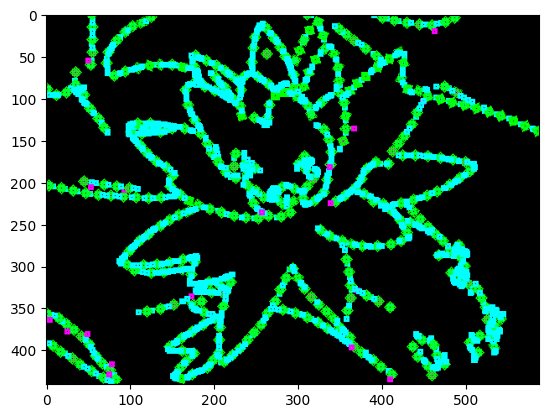

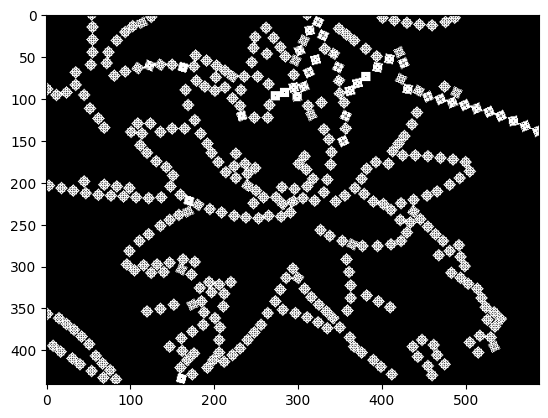

Q:  deque([[286, 160]])
wasted time on point:  (284, 170)
wasted time on point:  (296, 161)
wasted time on point:  (295, 168)
placed tile at point:  (302, 155)
Intersection inside mask
Intersection inside mask
wasted time on point:  (299, 172)
Intersection inside mask
placed tile at point:  (309, 145)
Intersection inside mask
Intersection inside mask
wasted time on point:  (295, 182)
wasted time on point:  (303, 137)
Intersection inside mask
wasted time on point:  (313, 152)
Intersection inside mask
placed tile at point:  (304, 132)
placed tile at point:  (317, 159)
placed tile at point:  (293, 126)
Q:  deque([(302, 155), (309, 145), (304, 132), (317, 159), (293, 126)])
wasted time on point:  (291, 157)
wasted time on point:  (313, 152)
wasted time on point:  (292, 163)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (290, 168)
wasted time on point:  (285, 167)
Intersection inside mask
Intersection inside mask
I

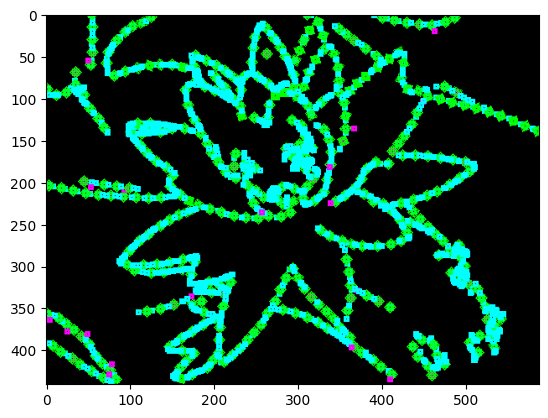

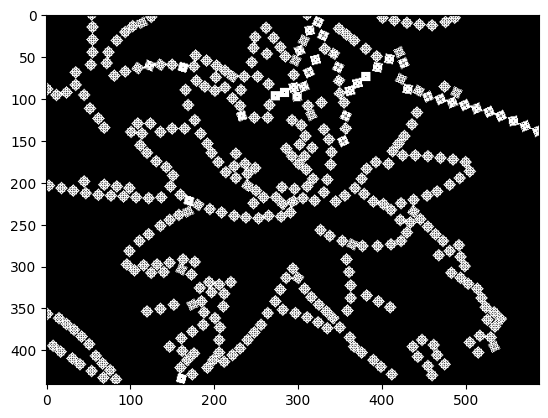

Q:  deque([[338, 236]])
wasted time on point:  (333, 245)


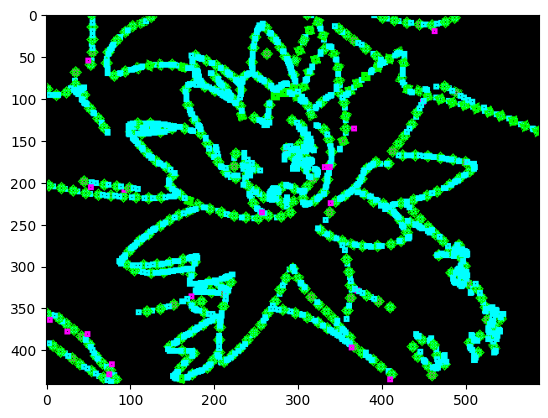

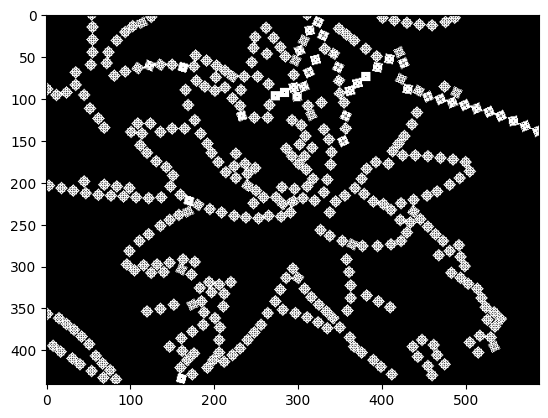

Q:  deque([[403, 111]])
placed tile at point:  (375, 128)
wasted time on point:  (369, 133)
Q:  deque([(375, 128)])
wasted time on point:  (397, 114)
wasted time on point:  (409, 108)


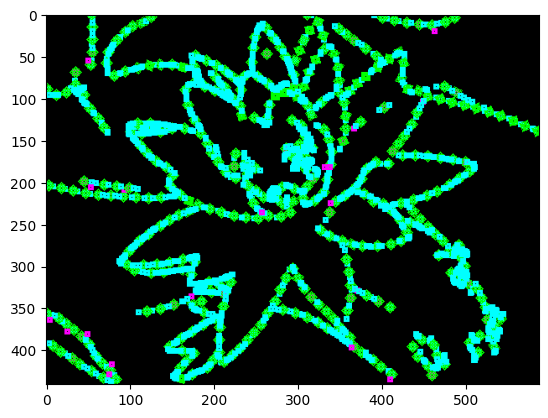

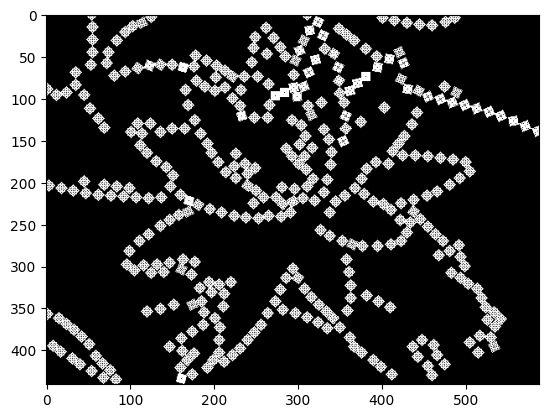

Q:  deque([[561, 388]])
wasted time on point:  (564, 399)
placed tile at point:  (566, 399)
wasted time on point:  (574, 403)
Intersection inside mask
wasted time on point:  (565, 409)
placed tile at point:  (578, 409)
placed tile at point:  (564, 414)
wasted time on point:  (582, 414)
Intersection inside mask
wasted time on point:  (573, 415)
wasted time on point:  (553, 417)
placed tile at point:  (581, 422)
wasted time on point:  (559, 418)
Intersection inside mask
Intersection inside mask
wasted time on point:  (559, 423)
placed tile at point:  (557, 428)
Q:  deque([(566, 399), (578, 409), (564, 414), (581, 422), (557, 428)])
wasted time on point:  (576, 402)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (573, 415)
wasted time on point:  (553, 417)
wasted time on point:  (559, 418)
Intersection inside mask
Intersection inside mask
I

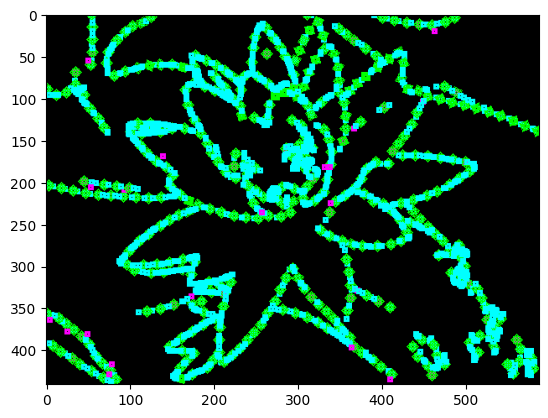

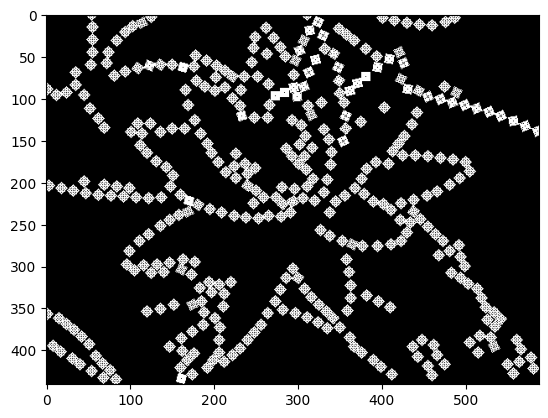

Q:  deque([[265, 274]])
wasted time on point:  (259, 283)
placed tile at point:  (249, 292)
Intersection inside mask
placed tile at point:  (238, 300)
wasted time on point:  (233, 304)
placed tile at point:  (226, 308)
Q:  deque([(249, 292), (238, 300), (226, 308)])
Intersection inside mask
Intersection inside mask
wasted time on point:  (232, 304)
Q:  deque([(238, 300), (226, 308)])
Intersection inside mask
wasted time on point:  (259, 283)
Intersection inside mask
Q:  deque([(226, 308)])
Intersection inside mask
wasted time on point:  (243, 297)
wasted time on point:  (255, 287)
wasted time on point:  (259, 283)


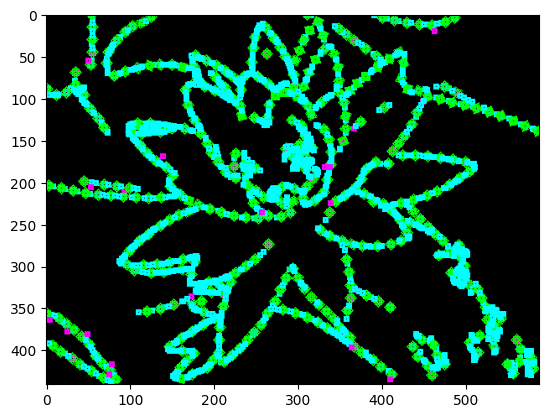

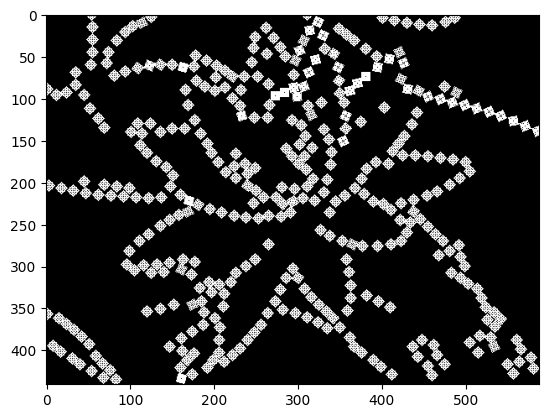

Q:  deque([[83, 154]])
Intersection inside mask
wasted time on point:  (71, 132)
Intersection inside mask


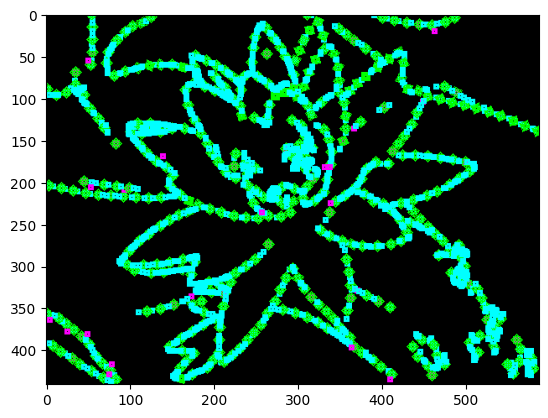

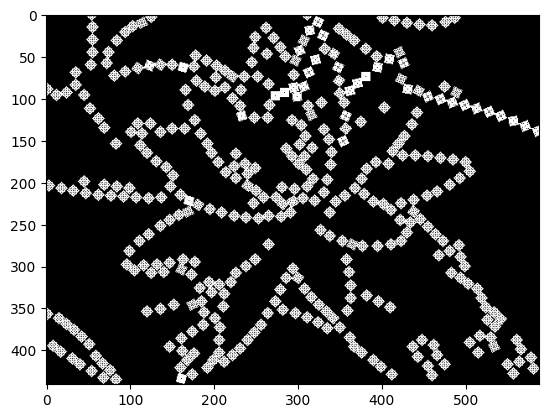

Q:  deque([[475, 53]])
wasted time on point:  (485, 52)
wasted time on point:  (464, 55)
placed tile at point:  (459, 57)
placed tile at point:  (490, 51)
wasted time on point:  (454, 61)
placed tile at point:  (447, 68)
Q:  deque([(459, 57), (490, 51), (447, 68)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Q:  deque([(490, 51), (447, 68)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (453, 62)
Q:  deque([(447, 68)])
wasted time on point:  (456, 59)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask


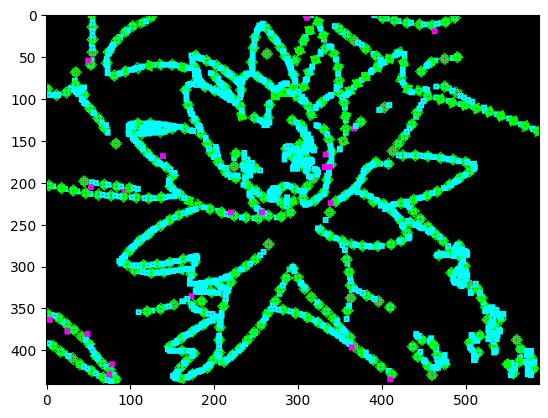

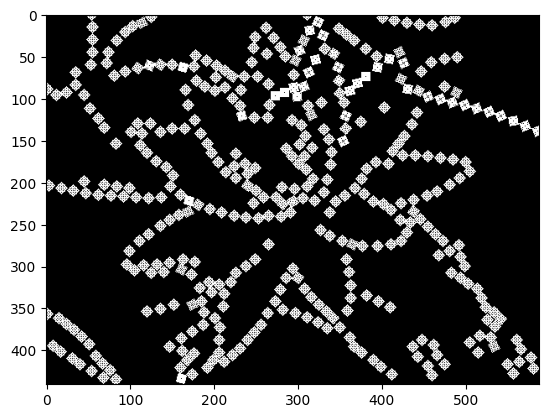

Q:  deque([[395, 33]])
placed tile at point:  (386, 26)
wasted time on point:  (376, 23)
wasted time on point:  (371, 22)
wasted time on point:  (366, 21)
Intersection inside mask
Intersection inside mask
Q:  deque([(386, 26)])
wasted time on point:  (376, 23)
wasted time on point:  (371, 22)
wasted time on point:  (367, 21)
Intersection inside mask
Intersection inside mask


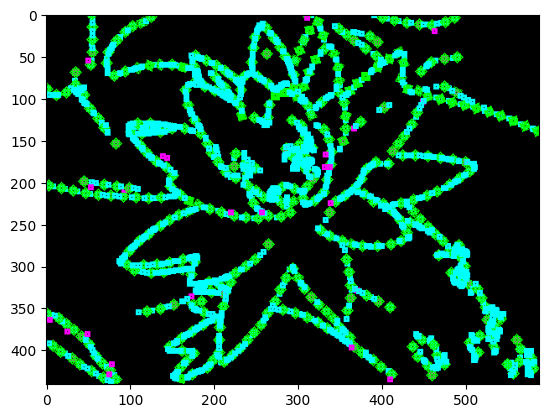

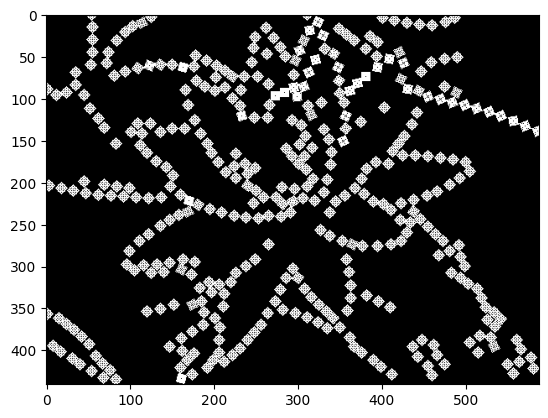

Q:  deque([[359, 1]])
placed tile at point:  (368, 8)
wasted time on point:  (373, 11)
Intersection inside mask
wasted time on point:  (396, 25)
Q:  deque([(368, 8)])
Intersection inside mask
Intersection inside mask
wasted time on point:  (396, 25)


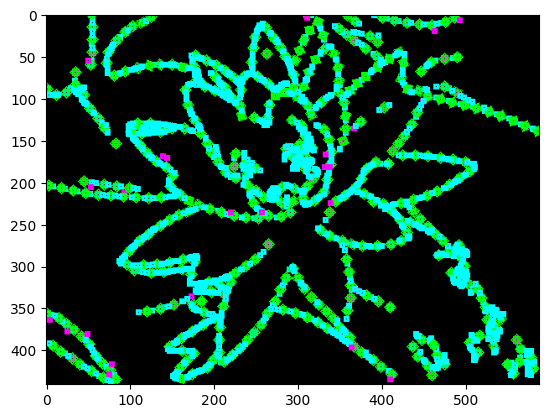

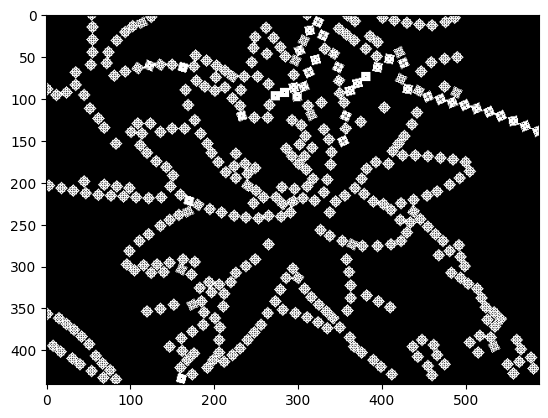

Q:  deque([[509, 65]])
wasted time on point:  (519, 68)
placed tile at point:  (524, 66)
Intersection inside mask
wasted time on point:  (534, 64)
placed tile at point:  (540, 64)
wasted time on point:  (545, 64)
wasted time on point:  (550, 63)
Q:  deque([(524, 66), (540, 64)])
wasted time on point:  (535, 64)
Intersection inside mask
Intersection inside mask
wasted time on point:  (545, 64)
wasted time on point:  (550, 63)
placed tile at point:  (555, 63)
Q:  deque([(540, 64), (555, 63)])
wasted time on point:  (550, 63)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Q:  deque([(555, 63)])
wasted time on point:  (545, 64)
wasted time on point:  (535, 64)
Intersection inside mask
Intersection inside mask
Intersection inside mask


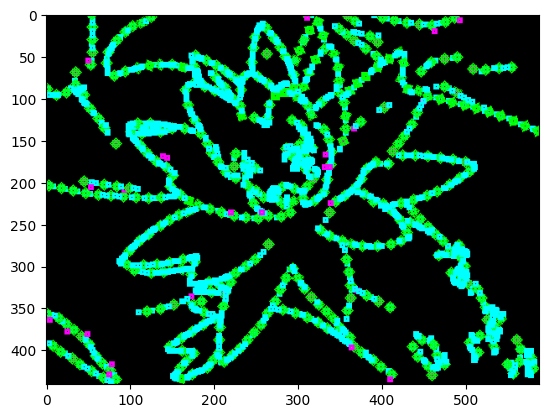

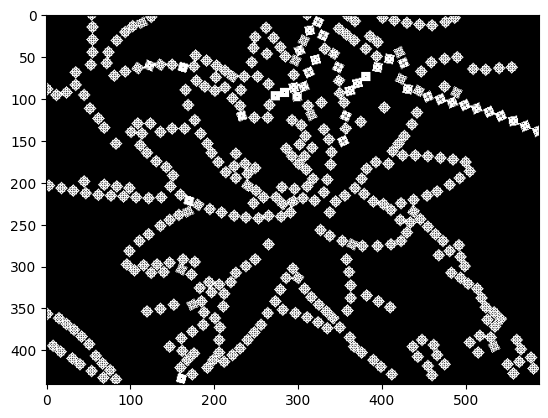

Q:  deque([[543, 0]])
wasted time on point:  (553, 3)
placed tile at point:  (558, 4)
wasted time on point:  (563, 4)
wasted time on point:  (568, 5)
placed tile at point:  (577, 6)
Intersection inside mask
Q:  deque([(558, 4), (577, 6)])
wasted time on point:  (568, 5)
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Q:  deque([(577, 6)])
wasted time on point:  (567, 5)
wasted time on point:  (587, 5)
Intersection inside mask
Intersection inside mask
wasted time on point:  (552, 2)
Intersection inside mask
Intersection inside mask


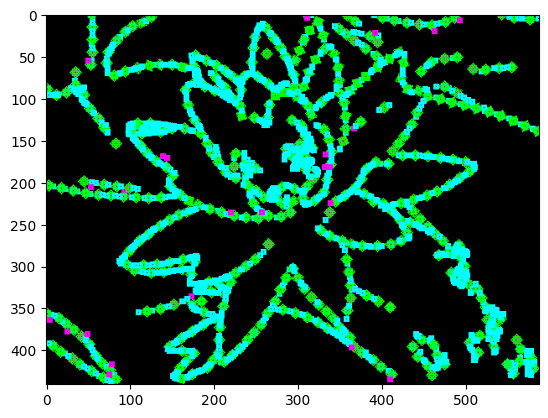

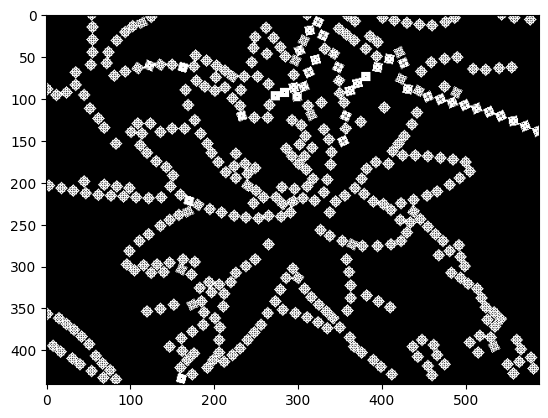

Q:  deque([[182, 34]])
wasted time on point:  (191, 39)
wasted time on point:  (172, 34)
placed tile at point:  (167, 34)
Intersection inside mask
wasted time on point:  (157, 31)
placed tile at point:  (152, 31)
Q:  deque([(167, 34), (152, 31)])
wasted time on point:  (157, 31)
Intersection inside mask
wasted time on point:  (182, 36)
wasted time on point:  (187, 38)
wasted time on point:  (192, 39)
Q:  deque([(152, 31)])
Intersection inside mask
wasted time on point:  (172, 34)
Intersection inside mask
wasted time on point:  (182, 36)
Intersection inside mask
wasted time on point:  (191, 39)


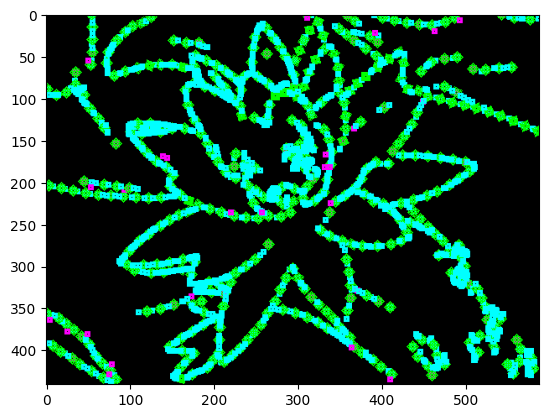

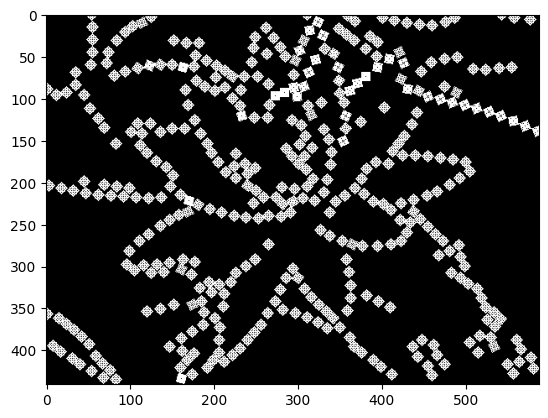

Q:  deque([[164, 184]])
wasted time on point:  (174, 183)
placed tile at point:  (179, 182)
Intersection inside mask
wasted time on point:  (190, 181)
placed tile at point:  (195, 182)
Intersection inside mask
Q:  deque([(179, 182), (195, 182)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
wasted time on point:  (158, 186)
Q:  deque([(195, 182)])
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask
Intersection inside mask


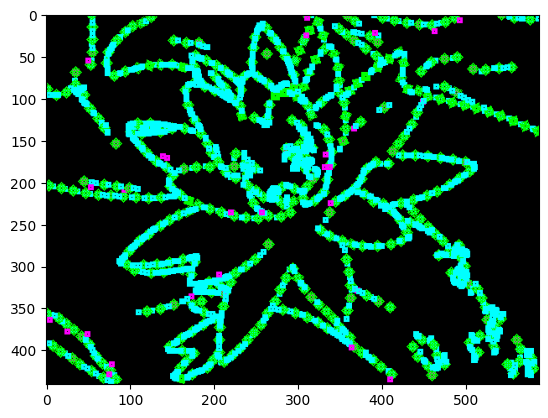

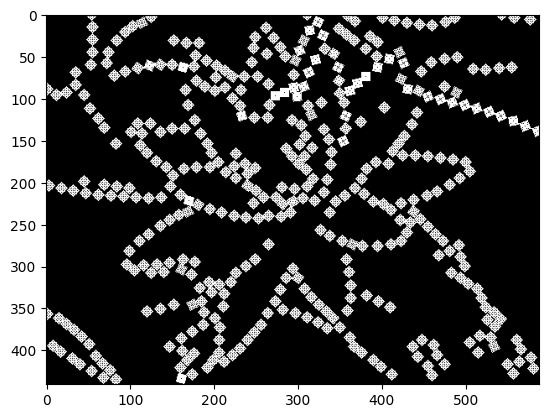

Q:  deque([[377, 361]])
placed tile at point:  (371, 350)
wasted time on point:  (369, 350)
placed tile at point:  (384, 372)
wasted time on point:  (368, 344)
wasted time on point:  (369, 340)
Q:  deque([(371, 350), (384, 372)])
Intersection inside mask
wasted time on point:  (369, 335)
Intersection inside mask
Q:  deque([(384, 372)])
Intersection inside mask
wasted time on point:  (368, 344)
Intersection inside mask
wasted time on point:  (370, 334)


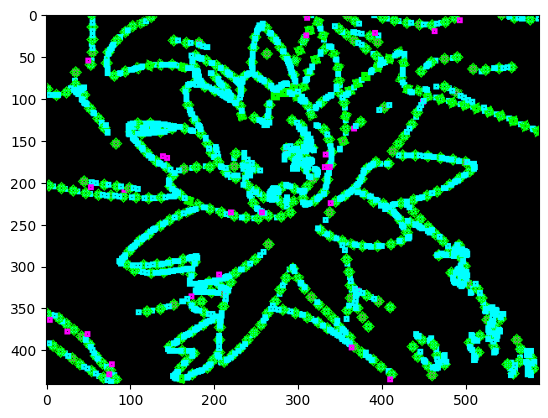

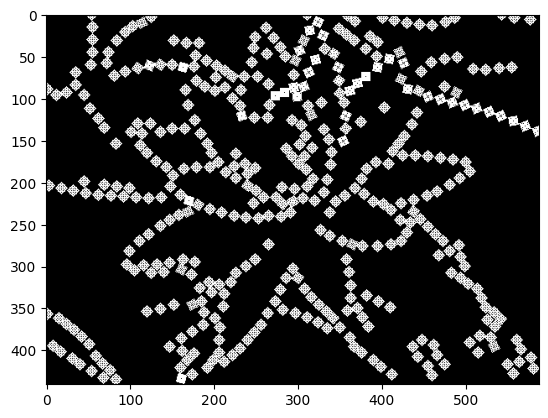

Q:  deque([[410, 302]])
placed tile at point:  (416, 313)
Intersection inside mask
Q:  deque([(416, 313)])
placed tile at point:  (402, 285)
Intersection inside mask
Q:  deque([(402, 285)])
Intersection inside mask


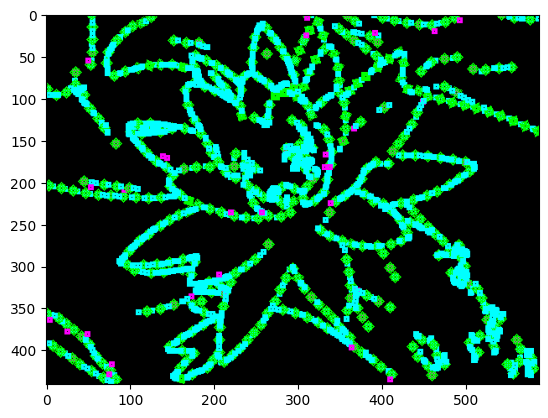

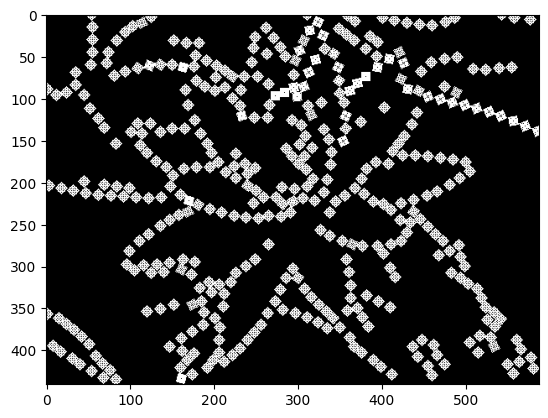

Q:  deque([[130, 272]])
placed tile at point:  (119, 280)
wasted time on point:  (107, 287)
wasted time on point:  (102, 290)
wasted time on point:  (96, 293)
Q:  deque([(119, 280)])
Intersection inside mask
wasted time on point:  (108, 286)
wasted time on point:  (102, 290)
Intersection inside mask


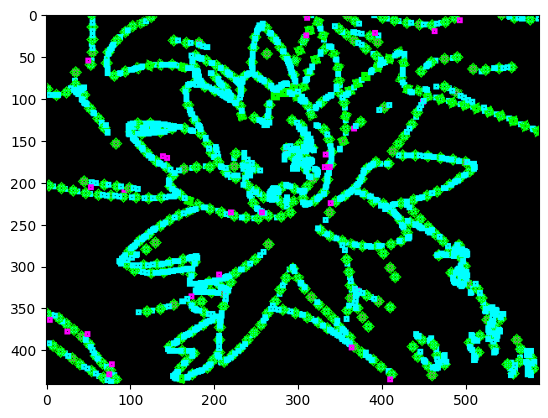

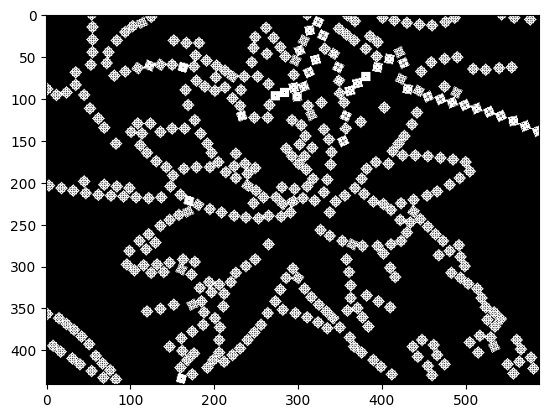

Q:  deque([[188, 130]])
wasted time on point:  (194, 141)
Intersection inside mask
wasted time on point:  (175, 114)
wasted time on point:  (200, 147)


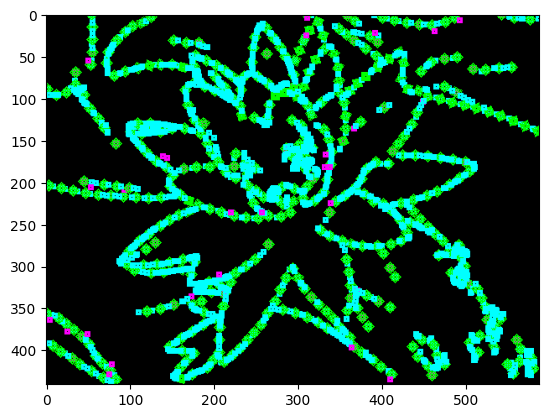

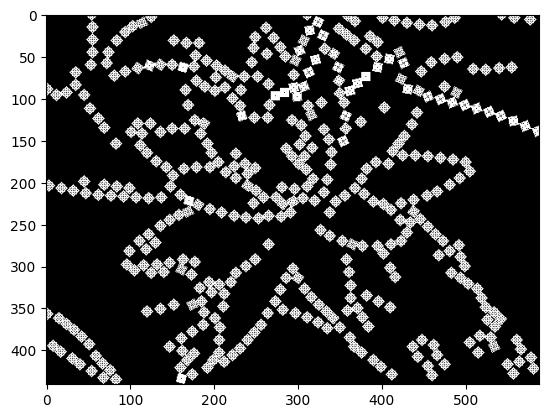

Q:  deque([[326, 180]])
wasted time on point:  (321, 194)
Intersection inside mask


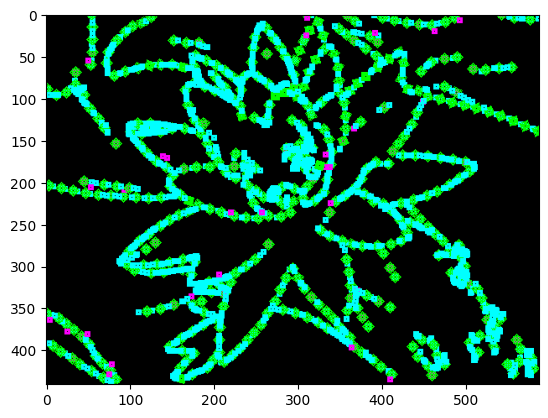

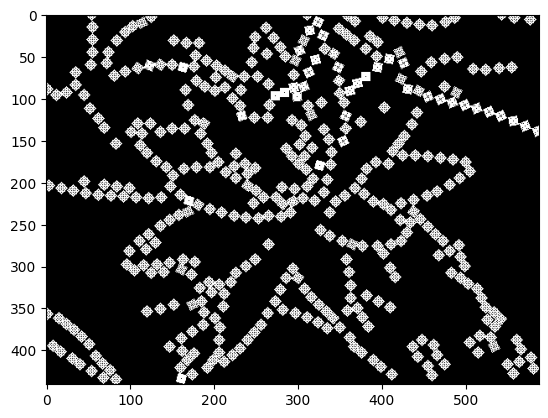

Q:  deque([[42, 369]])
placed tile at point:  (60, 385)
Intersection inside mask
placed tile at point:  (69, 393)
Q:  deque([(60, 385), (69, 393)])
wasted time on point:  (47, 374)
Q:  deque([(69, 393)])
wasted time on point:  (47, 374)


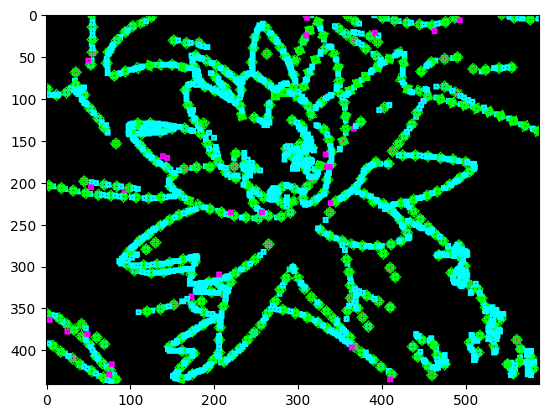

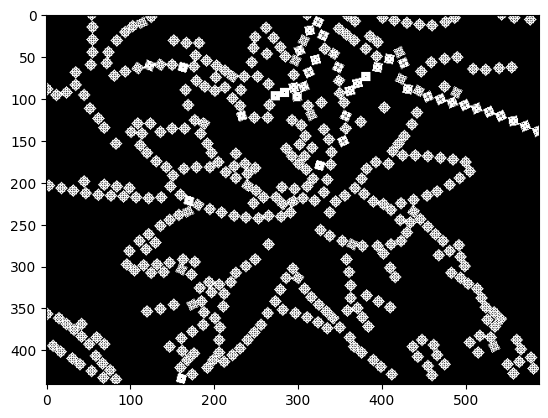

Q:  deque([[450, 47]])
Intersection inside mask
wasted time on point:  (465, 51)
wasted time on point:  (470, 50)
Intersection inside mask
placed tile at point:  (481, 42)
wasted time on point:  (487, 39)
Q:  deque([(481, 42)])
wasted time on point:  (470, 50)
wasted time on point:  (464, 51)
Intersection inside mask
Intersection inside mask


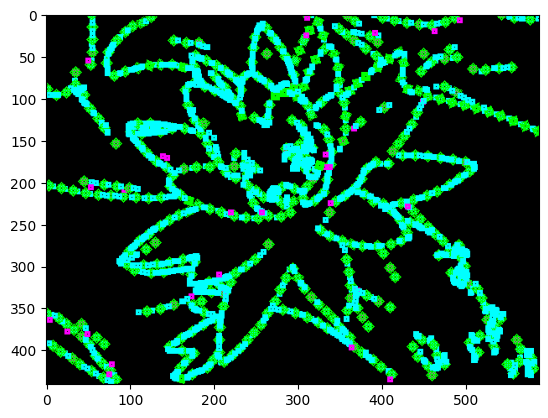

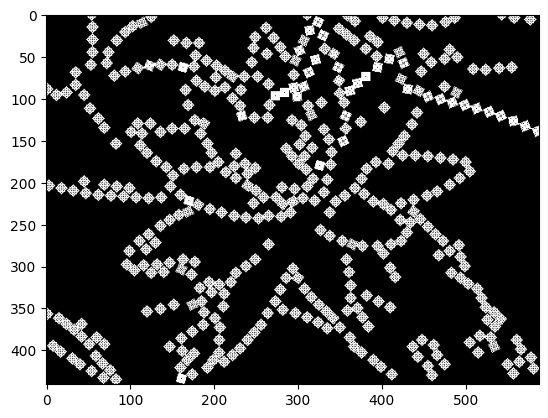

Q:  deque([[490, 390]])
placed tile at point:  (496, 401)
wasted time on point:  (499, 407)
placed tile at point:  (502, 412)
Intersection inside mask
Q:  deque([(496, 401), (502, 412)])
Intersection inside mask
wasted time on point:  (486, 384)
Q:  deque([(502, 412)])
wasted time on point:  (493, 395)
wasted time on point:  (486, 384)


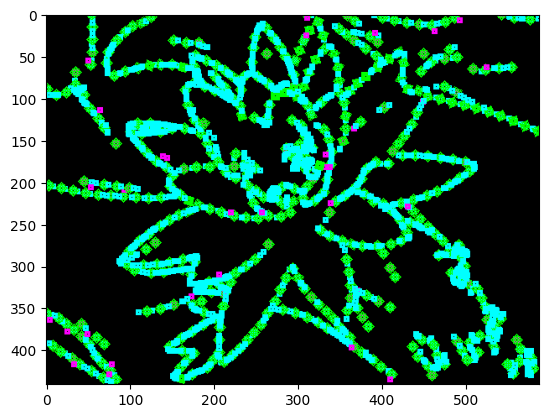

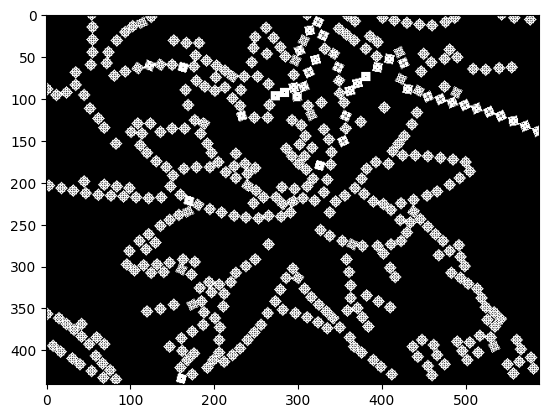

Q:  deque([[304, 252]])
wasted time on point:  (314, 252)
placed tile at point:  (312, 268)
wasted time on point:  (309, 273)
placed tile at point:  (304, 277)
wasted time on point:  (298, 281)
Q:  deque([(312, 268), (304, 277)])
Intersection inside mask
wasted time on point:  (313, 253)
Intersection inside mask
wasted time on point:  (298, 281)
wasted time on point:  (316, 253)
Q:  deque([(304, 277)])
Intersection inside mask
wasted time on point:  (313, 253)


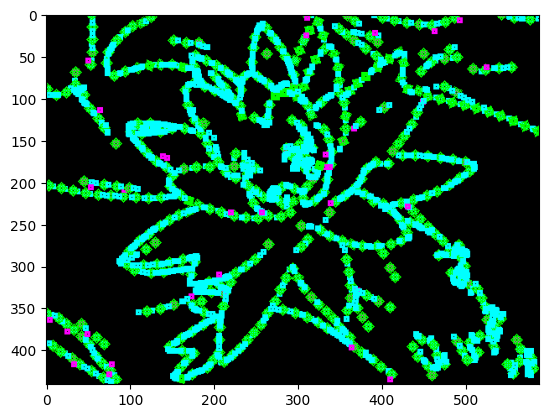

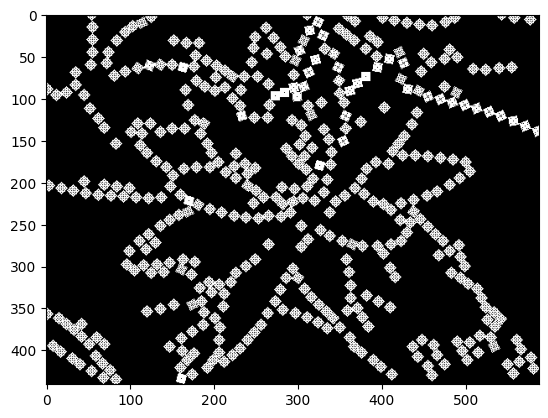

Q:  deque([[354, 166]])
wasted time on point:  (344, 174)


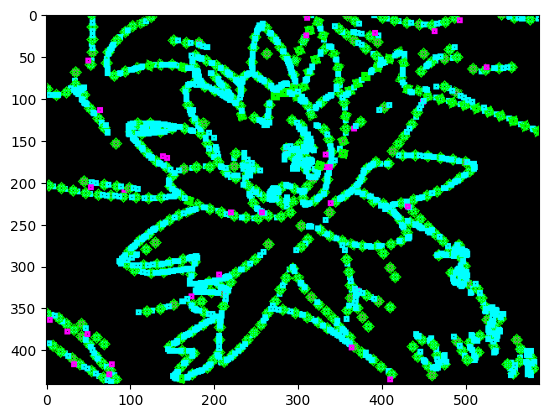

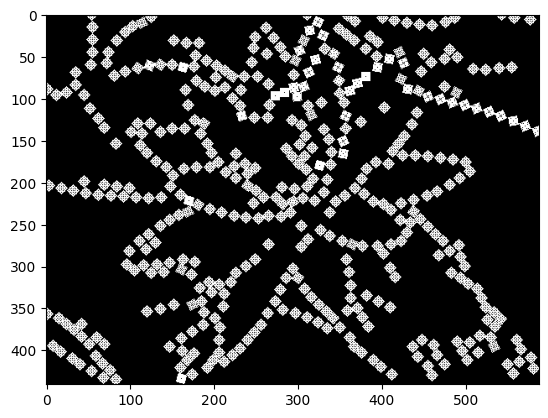

Q:  deque([[209, 34]])
placed tile at point:  (201, 43)
wasted time on point:  (192, 46)
Intersection inside mask
Q:  deque([(201, 43)])
Intersection inside mask
Intersection inside mask


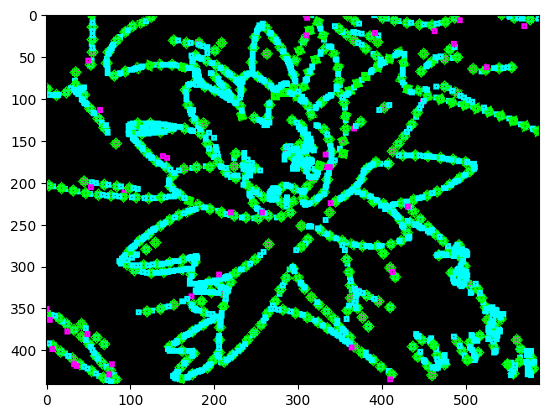

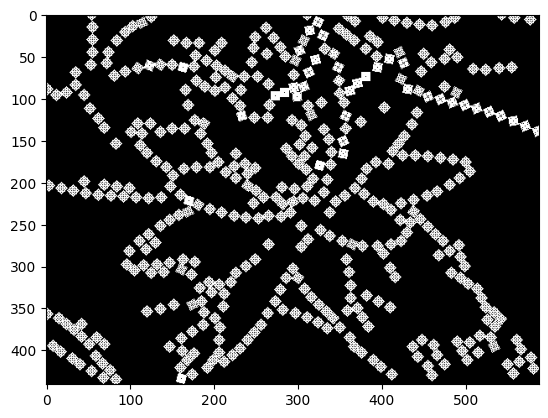

Q:  deque([[32, 187]])
wasted time on point:  (22, 186)
placed tile at point:  (17, 185)
wasted time on point:  (13, 180)
wasted time on point:  (8, 180)
Q:  deque([(17, 185)])
Intersection inside mask
wasted time on point:  (8, 180)
Intersection inside mask


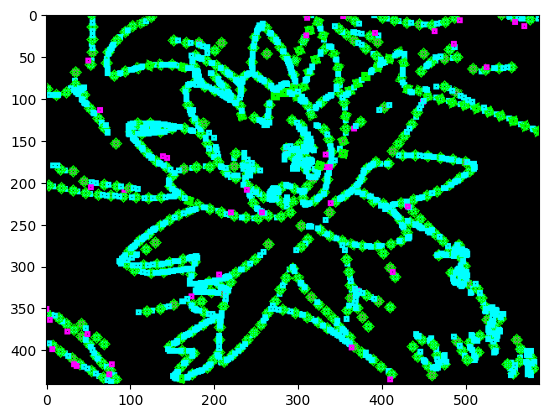

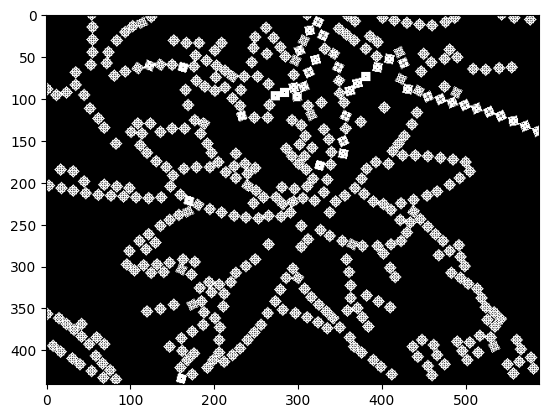

Q:  deque([[277, 272]])
wasted time on point:  (286, 278)
wasted time on point:  (268, 264)
placed tile at point:  (264, 260)
Q:  deque([(264, 260)])
Intersection inside mask


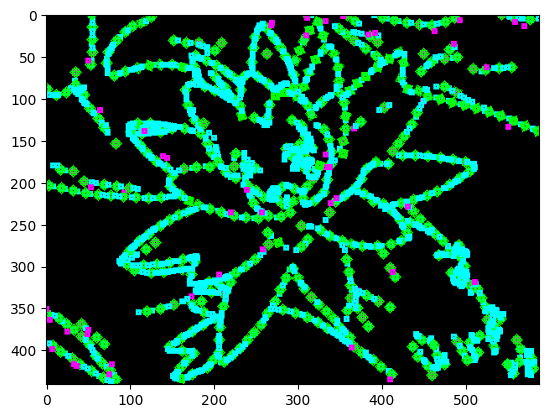

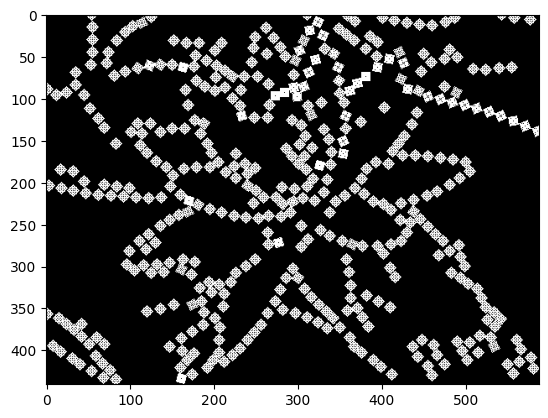

Q:  deque([[544, 348]])
wasted time on point:  (535, 343)


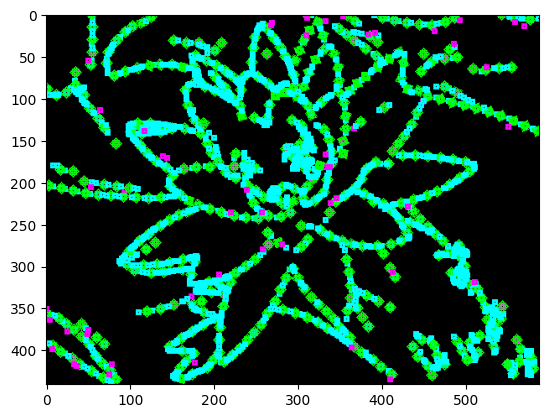

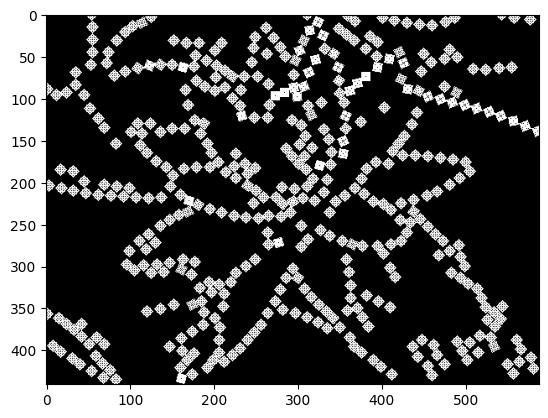

Q:  deque([[211, 221]])
wasted time on point:  (210, 211)
placed tile at point:  (210, 206)
Intersection inside mask
Q:  deque([(210, 206)])
Intersection inside mask
wasted time on point:  (211, 226)


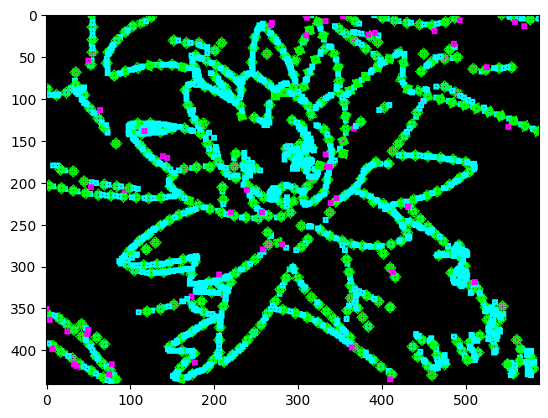

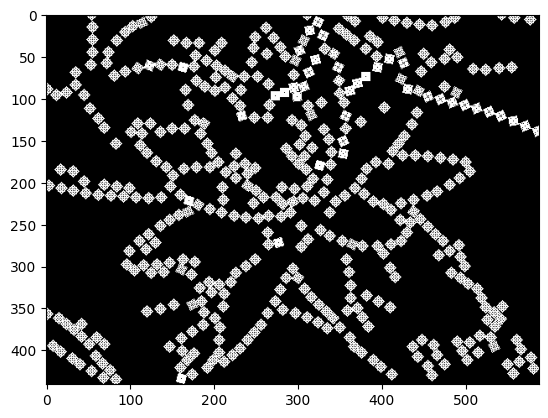

Q:  deque([[555, 361]])
placed tile at point:  (563, 372)
wasted time on point:  (566, 378)
wasted time on point:  (571, 384)
Q:  deque([(563, 372)])
Intersection inside mask
wasted time on point:  (570, 383)


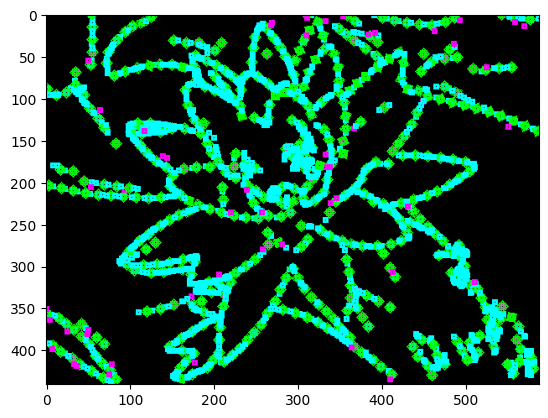

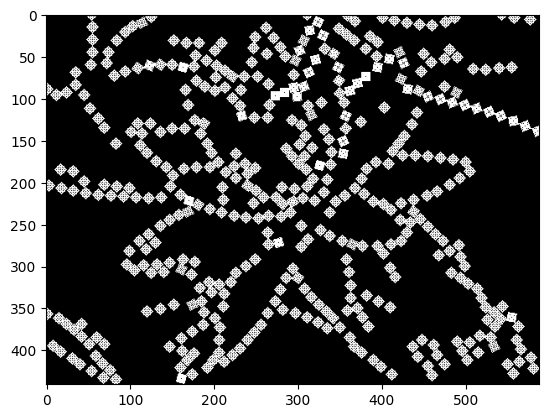

Q:  deque([[218, 133]])
wasted time on point:  (208, 132)
placed tile at point:  (203, 132)
wasted time on point:  (198, 132)
Q:  deque([(203, 132)])
Intersection inside mask


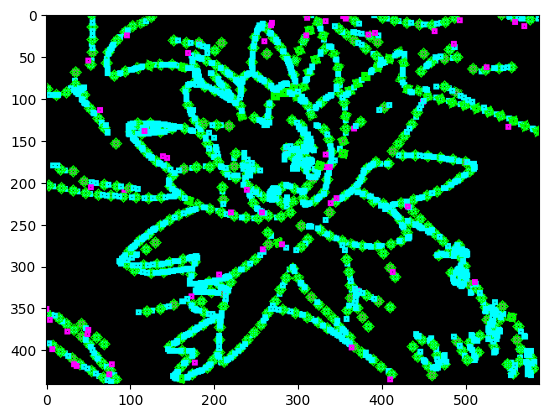

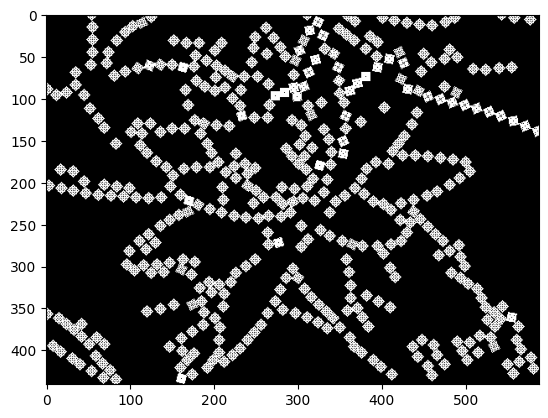

Q:  deque([[560, 52]])
placed tile at point:  (552, 41)
Q:  deque([(552, 41)])
wasted time on point:  (564, 58)


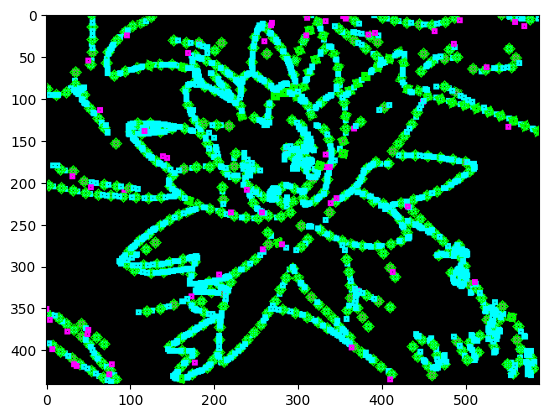

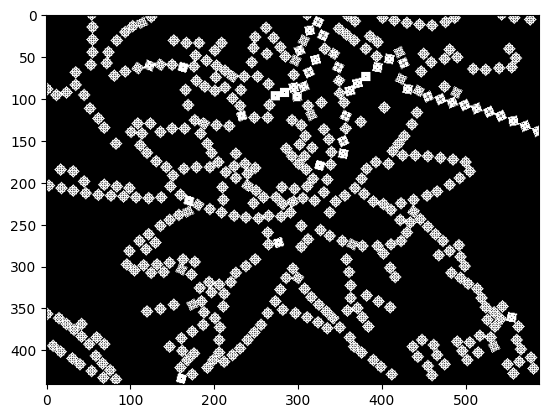

Q:  deque([[404, 317]])
wasted time on point:  (401, 306)


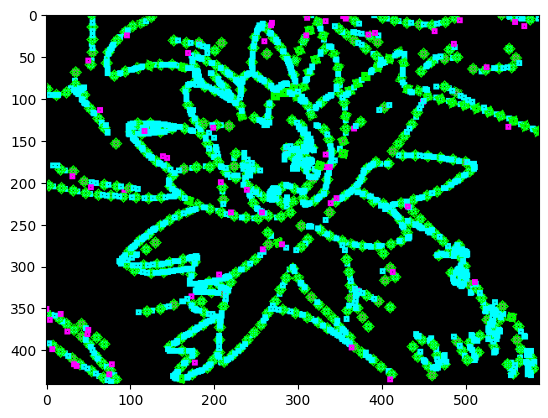

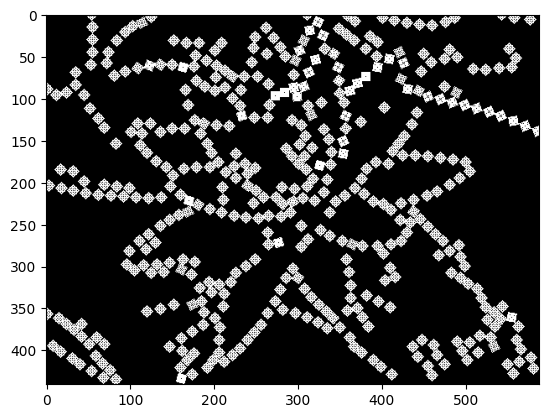

Q:  deque([[77, 357]])
placed tile at point:  (68, 366)
Intersection inside mask
Q:  deque([(68, 366)])
wasted time on point:  (82, 353)


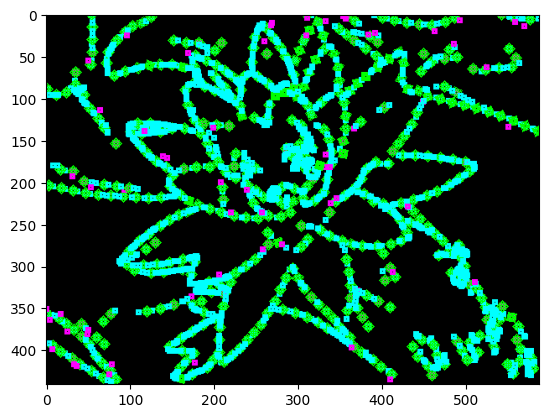

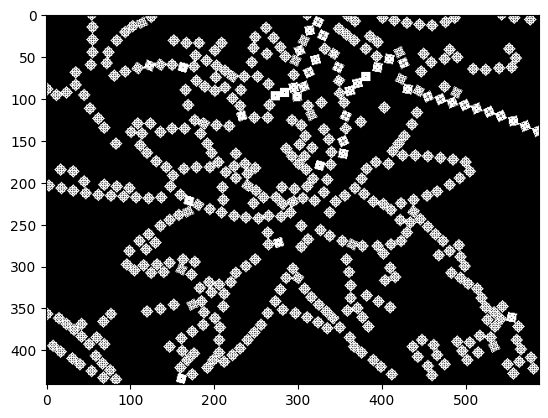

Q:  deque([[66, 103]])
wasted time on point:  (60, 112)


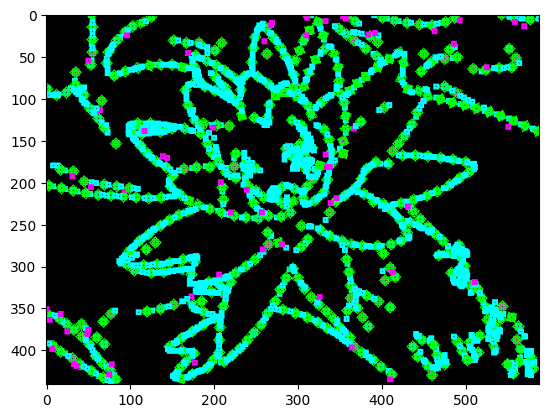

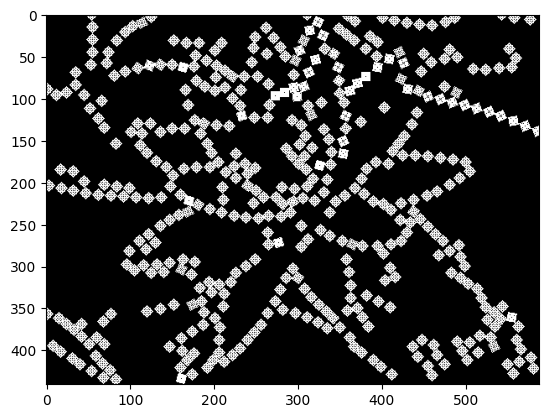

Q:  deque([[414, 100]])


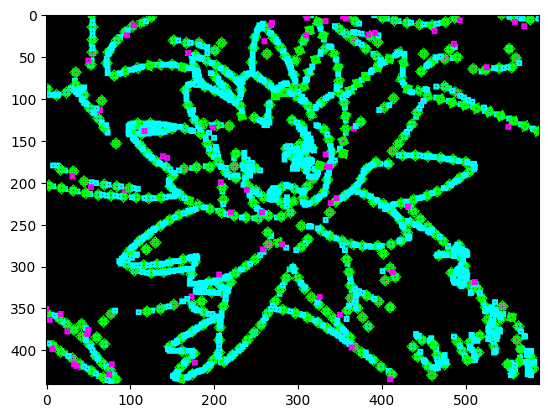

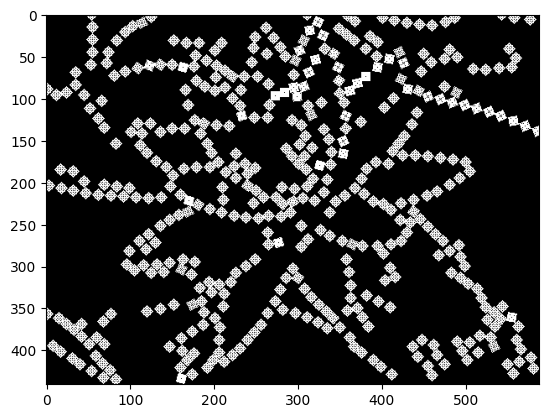

Q:  deque([[23, 353]])
wasted time on point:  (33, 357)
wasted time on point:  (37, 359)


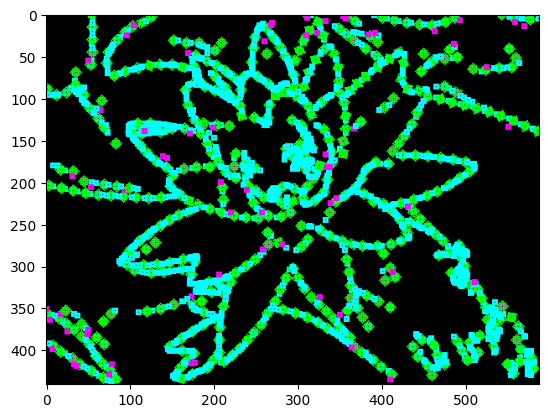

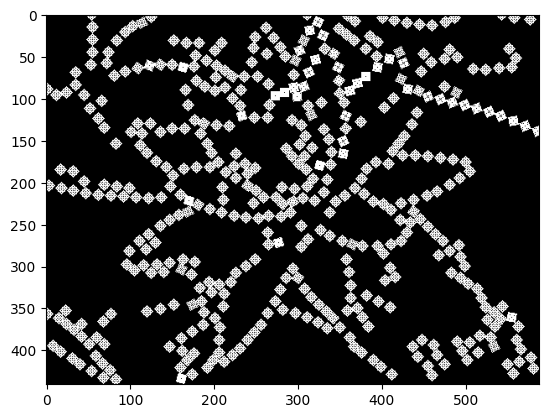

Q:  deque([[444, 301]])
wasted time on point:  (433, 303)
placed tile at point:  (428, 304)
Q:  deque([(428, 304)])
wasted time on point:  (438, 303)
Intersection inside mask
wasted time on point:  (449, 301)


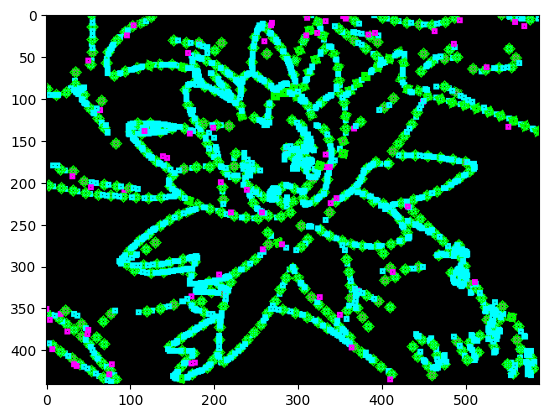

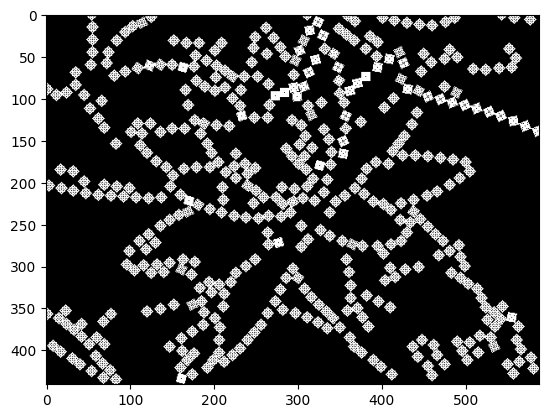

Q:  deque([[406, 39]])
Intersection inside mask


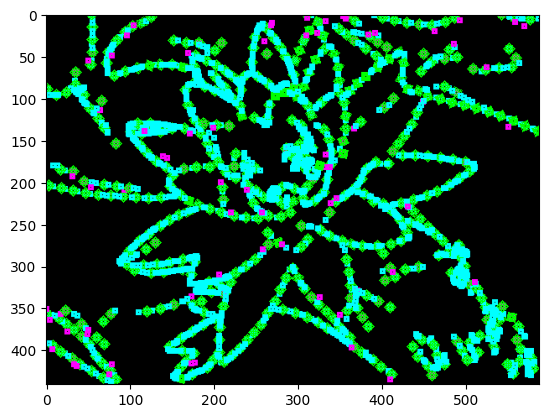

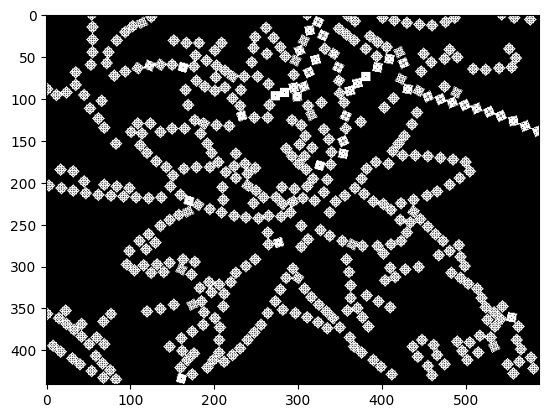

Q:  deque([[451, 339]])
wasted time on point:  (445, 348)
placed tile at point:  (442, 353)
Q:  deque([(442, 353)])
wasted time on point:  (446, 343)


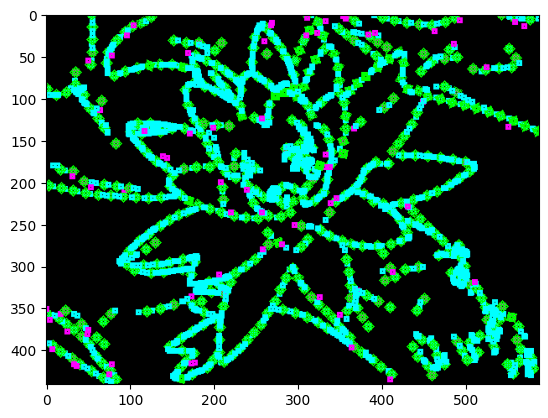

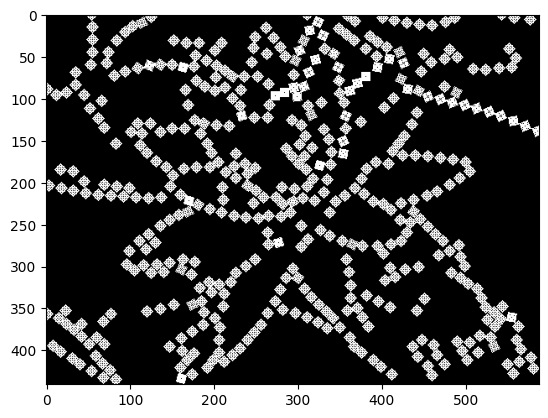

Q:  deque([[577, 65]])
wasted time on point:  (587, 66)
wasted time on point:  (567, 64)


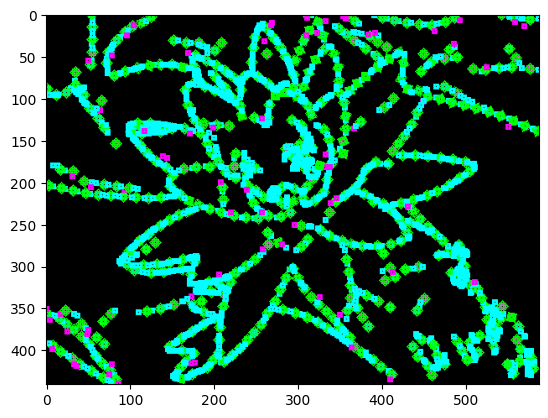

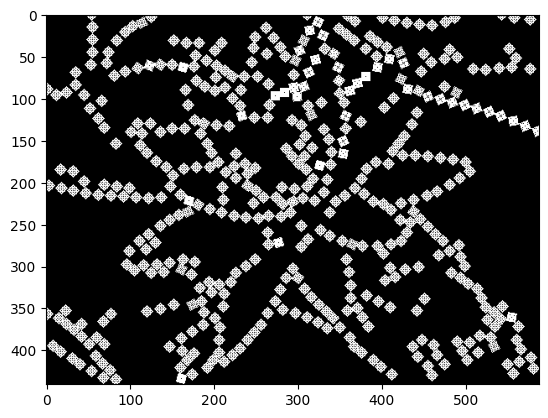

Q:  deque([[502, 47]])
placed tile at point:  (497, 36)
Q:  deque([(497, 36)])


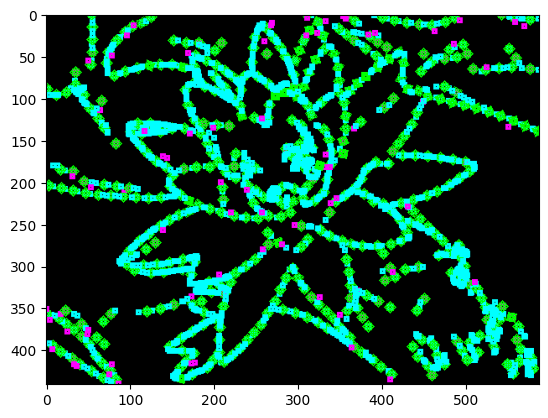

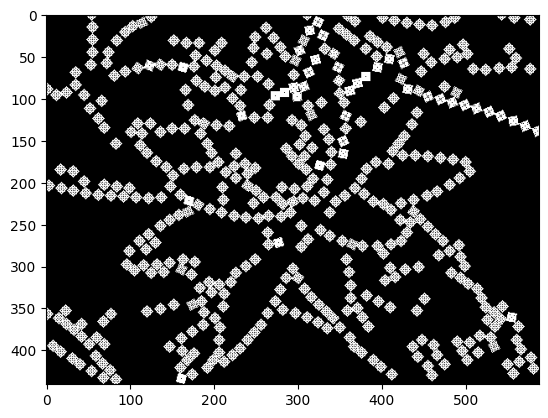

Q:  deque([[250, 91]])
wasted time on point:  (242, 80)


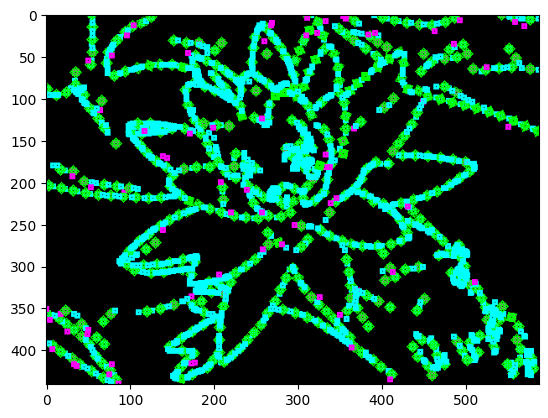

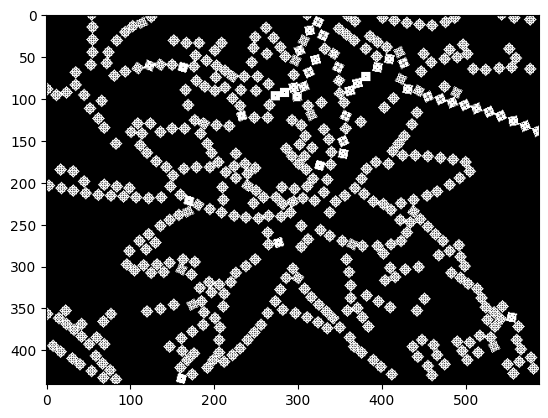

Q:  deque([[221, 213]])
placed tile at point:  (225, 224)
wasted time on point:  (228, 229)
Q:  deque([(225, 224)])


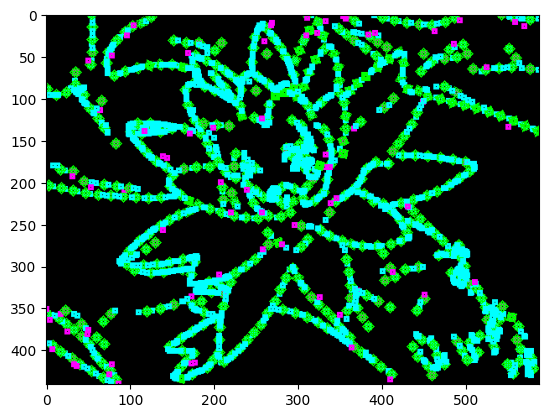

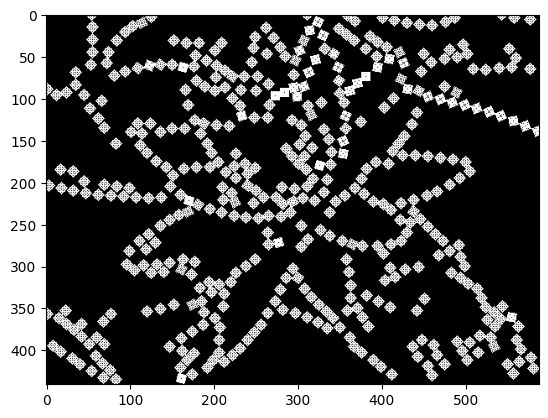

Q:  deque([[393, 390]])
wasted time on point:  (391, 379)
wasted time on point:  (391, 375)


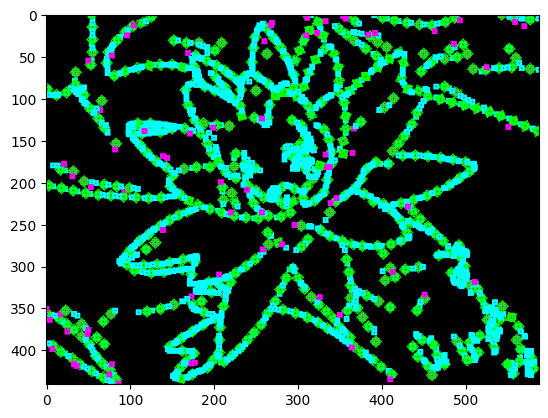

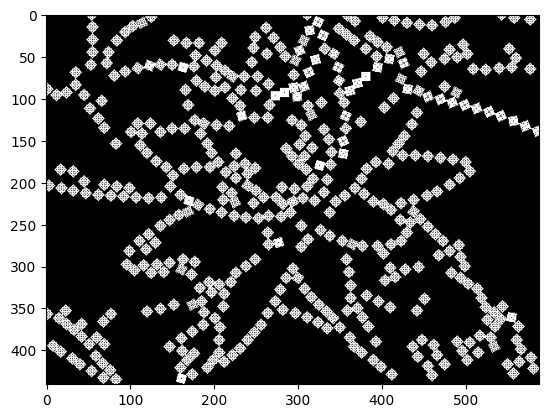

Q:  deque([[35, 359]])
wasted time on point:  (21, 353)
wasted time on point:  (16, 351)


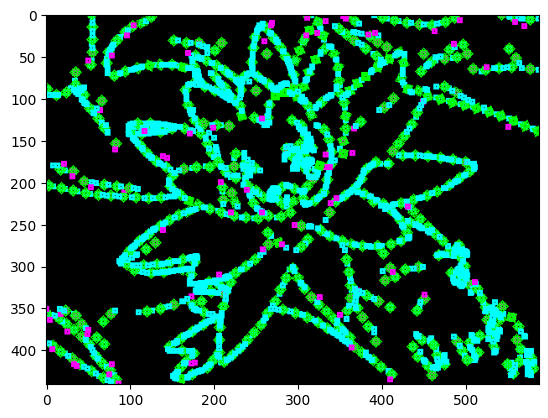

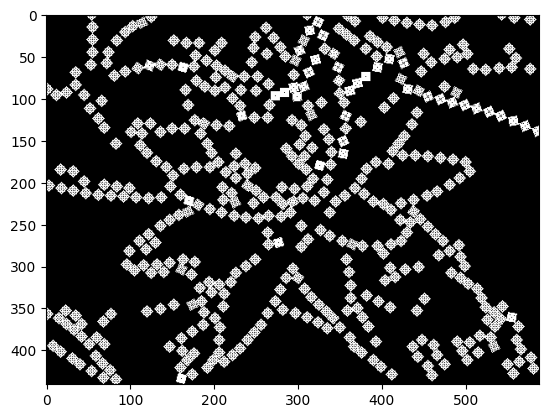

Q:  deque([[229, 147]])
wasted time on point:  (232, 158)


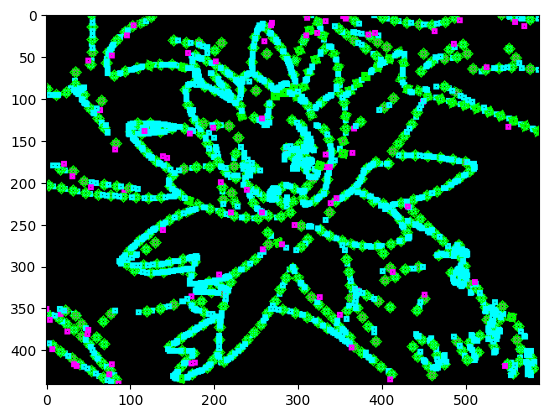

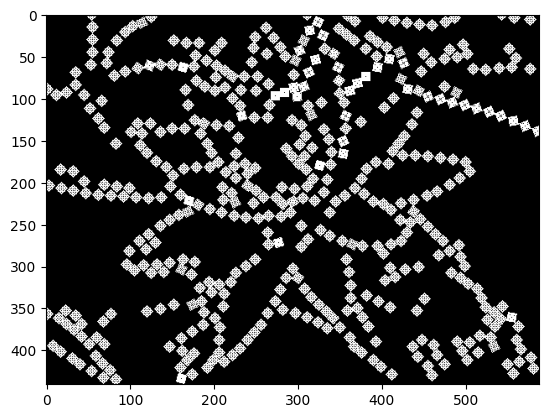

Q:  deque([[506, 271]])
wasted time on point:  (516, 271)


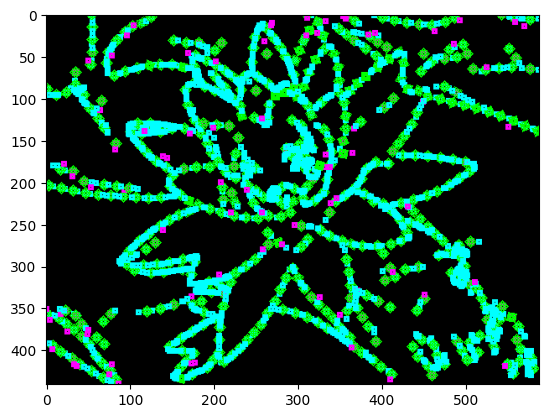

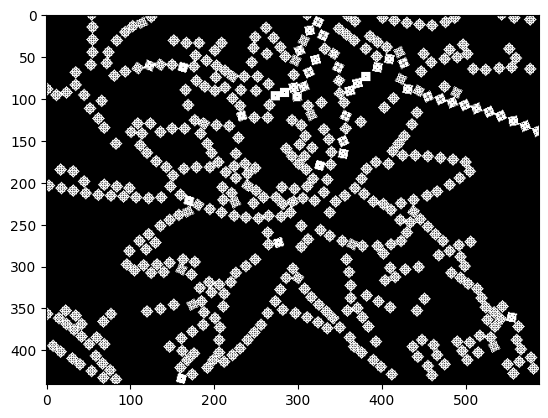

Q:  deque([[470, 351]])
wasted time on point:  (465, 360)


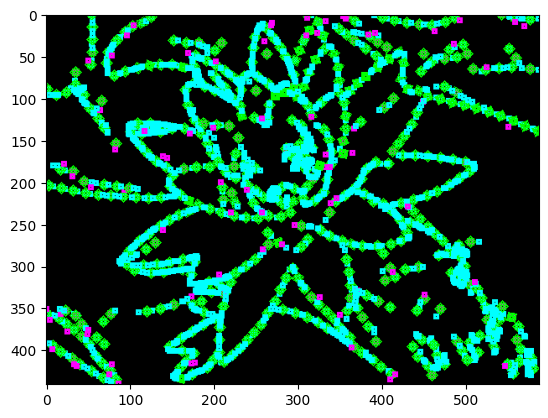

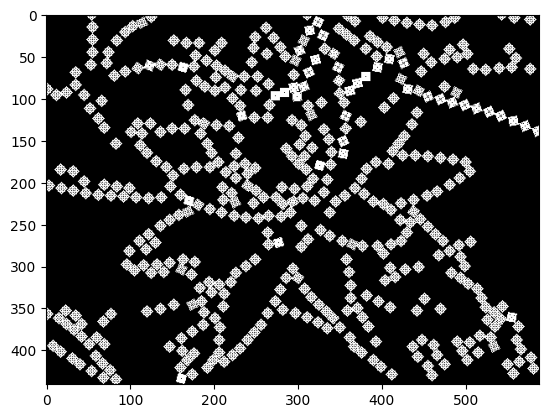

In [20]:
def place_tile(tiles_placed_info, image, mask_draw, mask_check, center, size, border, theta=0):
    
    info = {
                "point": center,
                "rotation": theta,
                "order": len(tiles_placed_info)
            }
    tiles_placed_info.append(info)
    
    
    
    # draw tile (green)
    draw_square(
        image=image,
        center=center,
        size=size,
        color=[0, 255, 0],
        border=border,
        theta=theta
    )

    # draw on visualization mask (white)
    draw_square(
        image=mask_draw,
        center=center,
        size=SIZE,
        color=[255, 255, 255],
        border=border,
        theta=theta
    )

    # update logical mask
    draw_mask(
        mask=mask_check,
        center=center,
        size=size,
        border=border,
        theta=theta
    )



canvas_image = np.zeros_like(contour_image, dtype=np.uint8)
mask_draw = np.zeros_like(contour_image, dtype=np.uint8)  # for visualization
mask_check = np.zeros(contour_image.shape[:2], dtype=np.uint8)  # for overlap checking
gray_image = np.mean(selected_contour_image[..., :3], axis=-1)



SIZE = 10
BORDER = 10
DECAY_RATE = 2

SEARCH_RADIUS = 10
SEARCH_ITERATIONS = 7

search_square_sizes = [SIZE + SEARCH_RADIUS * i for i in range(1,SEARCH_ITERATIONS+1)]

tiles_placed_info = []



for color, length in color_lengths: 

    edge_pixels = color_to_pixels[color]
    
    selected_contour_image = np.zeros_like(contour_image)

    for x, y in edge_pixels: 
        selected_contour_image[y, x] = [255, 255, 255]
        
        
        
        
    ## choose global BFS start here
    random_point = random.choice(edge_pixels)
    # show starting point (small pink dot)
    draw_square(
        image=canvas_image,
        center=random_point,
        size=7,
        color=[255, 0, 255],
        border=3
    )


    ## Attempt to place first tile
    best_theta = find_best_theta(gray_image, random_point, SIZE, mask_check, decay_rate=DECAY_RATE)
    if best_theta == ERROR_CODE_NO_VALID_THETA:
        continue
        
    

        
    place_tile(tiles_placed_info, canvas_image, mask_draw, mask_check, random_point, SIZE, BORDER, best_theta)



    H, W, C = canvas_image.shape

    q = deque([random_point])
    visited = set()
    visited.add(tuple(int(x) for x in random_point))

    while len(q) > 0:



        print("Q: ", q)

        starting_point = q.popleft()


        best_theta = find_best_theta(gray_image, starting_point, SIZE, mask_check, decay_rate=DECAY_RATE)

        intersections_list = []

        for search_square_size in search_square_sizes:

            intersections = get_edge_intersections(
                edge_image=selected_contour_image, 
                center=starting_point, 
                size=search_square_size, 
                theta_deg=best_theta
            )


            intersections_list.extend(intersections)




        for point in intersections_list: 

            if point in visited:
                continue

            point_x, point_y = point

            if point_x >= 0 and point_x <= W and point_y >= 0 and point_y <= H:
                if mask_check[point_y, point_x] == 1:
                    print("Intersection inside mask")
                    continue
            else: 
                # point out of bounds
                print("Out of bounds point: ", point)
                continue

            # show intersecting point (small cyan dot)
            draw_square(
                image=canvas_image,
                center=point,
                size=7,
                color=[0, 255, 255],
                border=3
            )


            best_theta = find_best_theta(gray_image, point, SIZE, mask_check, decay_rate=DECAY_RATE)

            if best_theta != ERROR_CODE_NO_VALID_THETA:
                

                place_tile(tiles_placed_info, canvas_image, mask_draw, mask_check, point, SIZE, BORDER, best_theta)
                q.append(point)
                visited.add(tuple(int(x) for x in point))
                
                
                
                print("placed tile at point: ", point)
                
            else: 
                
                print("wasted time on point: ", point)


    plt.figure()
    plt.imshow(canvas_image)
    plt.show()

    plt.figure()
    plt.imshow(mask_draw)
    plt.show()


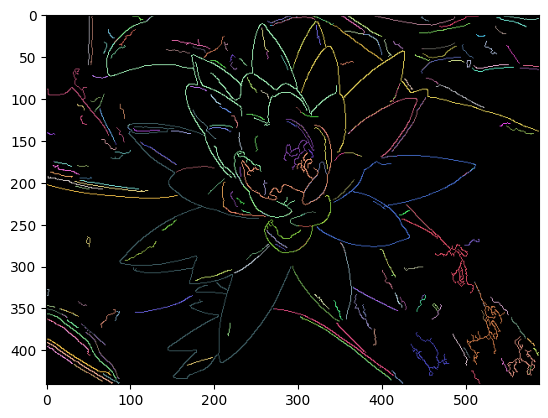

In [21]:
plt.imshow(contour_image)

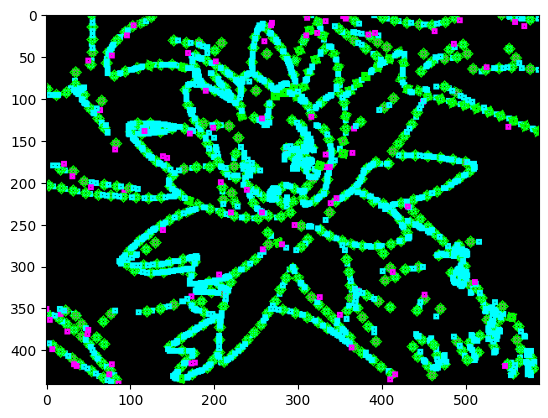

In [22]:
plt.imshow(canvas_image)

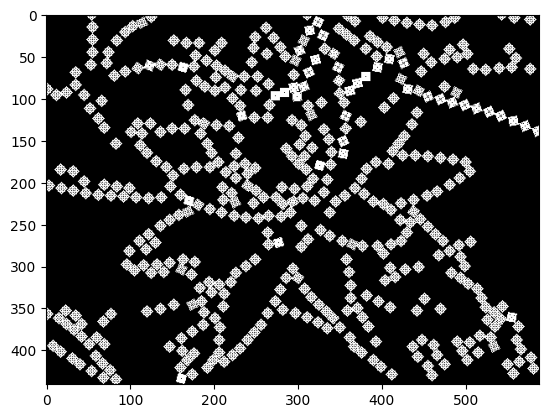

In [23]:
plt.imshow(mask_draw)

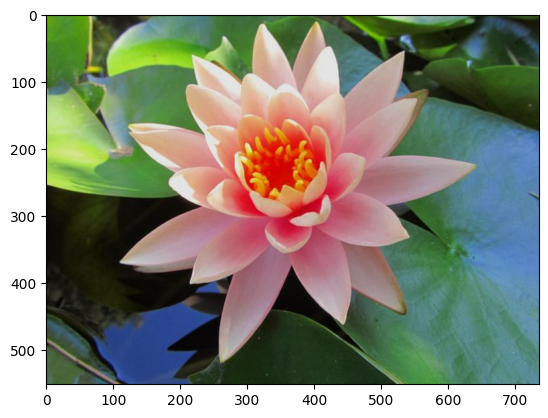

In [24]:
plt.imshow(original_image)

# Reconstruct Image

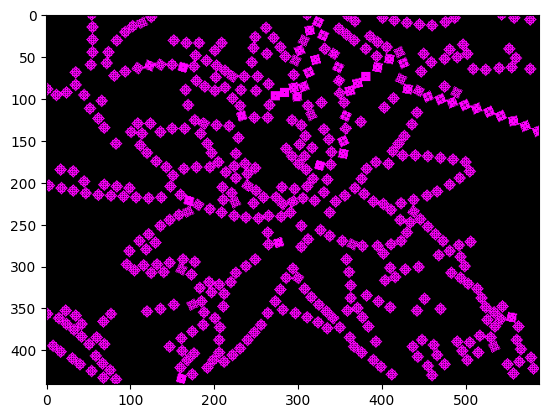

In [25]:
rendered_image = np.zeros_like(mask_draw)

for point_info in tiles_placed_info:
    
    draw_square(
        image=rendered_image,
        center=point_info["point"],
        size=SIZE,
        color=[255, 0, 255],
        border=SIZE//2,
        theta=point_info["rotation"]
    )
    
plt.imshow(rendered_image)

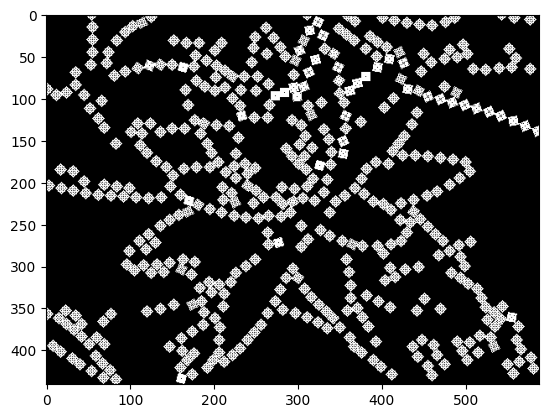

In [26]:
plt.imshow(mask_draw)

# Compute Voronoi Map

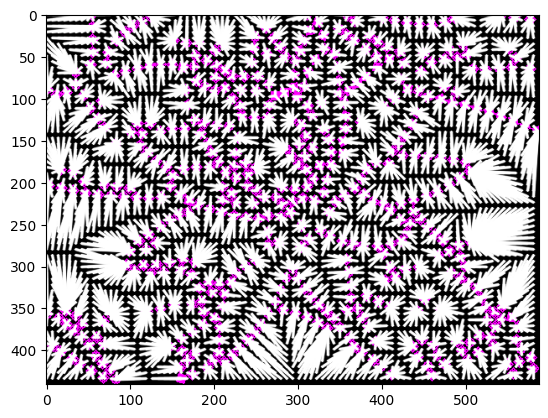

In [27]:
from scipy.spatial import cKDTree

placed_tile_coords = [tile["point"] for tile in tiles_placed_info]
tree = cKDTree(placed_tile_coords)

GRID_SIZE = 7
sample_points = []
for y in range(0, H, GRID_SIZE):
    for x in range(0, W, GRID_SIZE):
        sample_points.append((x, y))
        
distances, indicies = tree.query(sample_points)
        

    
voronoi_image = rendered_image.copy()

closest_tile_coords = [placed_tile_coords[index] for index in indicies]
for sample_point, closest_tile_point in zip(sample_points, closest_tile_coords):
    cv2.line(
        voronoi_image, 
        sample_point, 
        closest_tile_point,
        color=(255, 255, 255),
        thickness=2,
        lineType=cv2.LINE_AA
    )

plt.imshow(voronoi_image)

# Find Candidate Fill Points

In [28]:
placed_tile_rotations = [tile["rotation"] for tile in tiles_placed_info]

closest_tile_rotations = [placed_tile_rotations[index] for index in indicies]



candidate_points_info = []


for i in range(len(distances)):
    
  
    
    point_info = {
        "point": sample_points[i],
        
        "rotation": placed_tile_rotations[indicies[i]],
        "distance": distances[i]
    }
    candidate_points_info.append(point_info)
    
candidate_points_info.sort(key = lambda x: x["distance"])

candidate_points_info[:10]
    

[{'point': (35, 84), 'rotation': -45, 'distance': 0.0},
 {'point': (455, 98), 'rotation': 26, 'distance': 0.0},
 {'point': (420, 154), 'rotation': -45, 'distance': 0.0},
 {'point': (147, 245), 'rotation': -45, 'distance': 0.0},
 {'point': (119, 280), 'rotation': -45, 'distance': 0.0},
 {'point': (483, 308), 'rotation': -45, 'distance': 0.0},
 {'point': (371, 350), 'rotation': -45, 'distance': 0.0},
 {'point': (77, 357), 'rotation': -45, 'distance': 0.0},
 {'point': (399, 420), 'rotation': -45, 'distance': 0.0},
 {'point': (161, 434), 'rotation': -16, 'distance': 0.0}]

# Place Fill Tiles

no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid placement at distance:  5.0990195135927845
no valid pla

no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0
no valid placement at distance:  7.0710678118654755
no valid placement at distance:  7.0710678118654755
no valid placement at distance:  7.0710678118654755
no valid placement at distance:  7.0710678118654755
no valid placement at distance:  7.0710678118654755
no valid placement at distance:  7.0710678118654755
no valid placement at 

no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:  7.615773105863909
no valid placement at distance:

no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:  8.246211251235321
no valid placement at distance:

no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:  9.219544457292887
no valid placement at distance:

no valid placement at distance:  9.899494936611665
no valid placement at distance:  9.899494936611665
no valid placement at distance:  9.899494936611665
no valid placement at distance:  9.899494936611665
no valid placement at distance:  9.899494936611665
no valid placement at distance:  9.899494936611665
no valid placement at distance:  9.899494936611665
no valid placement at distance:  9.899494936611665
no valid placement at distance:  9.899494936611665
no valid placement at distance:  10.0
no valid placement at distance:  10.0
no valid placement at distance:  10.0
no valid placement at distance:  10.0
no valid placement at distance:  10.0
no valid placement at distance:  10.0
no valid placement at distance:  10.0
no valid placement at distance:  10.0
no valid placement at distance:  10.0
no valid placement at distance:  10.0
no valid placement at distance:  10.0
no valid placement at distance:  10.0
no valid placement at distance:  10.0
no valid placement at distance:  10.0
no valid 

no valid placement at distance:  10.44030650891055
no valid placement at distance:  10.44030650891055
no valid placement at distance:  10.44030650891055
no valid placement at distance:  10.44030650891055
no valid placement at distance:  10.44030650891055
no valid placement at distance:  10.44030650891055
no valid placement at distance:  10.63014581273465
no valid placement at distance:  10.63014581273465
no valid placement at distance:  10.63014581273465
no valid placement at distance:  10.63014581273465
no valid placement at distance:  10.63014581273465
no valid placement at distance:  10.63014581273465
no valid placement at distance:  10.63014581273465
no valid placement at distance:  10.63014581273465
no valid placement at distance:  10.63014581273465
no valid placement at distance:  10.63014581273465
no valid placement at distance:  10.63014581273465
no valid placement at distance:  10.63014581273465
no valid placement at distance:  10.63014581273465
no valid placement at distance:

no valid placement at distance:  11.180339887498949
no valid placement at distance:  11.180339887498949
no valid placement at distance:  11.180339887498949
no valid placement at distance:  11.180339887498949
no valid placement at distance:  11.180339887498949
no valid placement at distance:  11.180339887498949
no valid placement at distance:  11.180339887498949
no valid placement at distance:  11.180339887498949
no valid placement at distance:  11.180339887498949
no valid placement at distance:  11.180339887498949
no valid placement at distance:  11.180339887498949
no valid placement at distance:  11.180339887498949
no valid placement at distance:  11.180339887498949
placed tile at distance:  11.180339887498949
no valid placement at distance:  11.180339887498949
no valid placement at distance:  11.180339887498949
placed tile at distance:  11.313708498984761
no valid placement at distance:  11.313708498984761
placed tile at distance:  11.313708498984761
placed tile at distance:  11.3137

placed tile at distance:  12.041594578792296
no valid placement at distance:  12.041594578792296
placed tile at distance:  12.041594578792296
no valid placement at distance:  12.041594578792296
placed tile at distance:  12.041594578792296
no valid placement at distance:  12.041594578792296
no valid placement at distance:  12.041594578792296
placed tile at distance:  12.041594578792296
placed tile at distance:  12.041594578792296
placed tile at distance:  12.041594578792296
no valid placement at distance:  12.041594578792296
no valid placement at distance:  12.041594578792296
placed tile at distance:  12.041594578792296
placed tile at distance:  12.041594578792296
placed tile at distance:  12.083045973594572
no valid placement at distance:  12.083045973594572
placed tile at distance:  12.083045973594572
placed tile at distance:  12.083045973594572
placed tile at distance:  12.083045973594572
placed tile at distance:  12.083045973594572
placed tile at distance:  12.083045973594572
placed

placed tile at distance:  13.0
no valid placement at distance:  13.0
placed tile at distance:  13.0
placed tile at distance:  13.0
placed tile at distance:  13.0
placed tile at distance:  13.0
no valid placement at distance:  13.0
no valid placement at distance:  13.0
placed tile at distance:  13.0
no valid placement at distance:  13.0
no valid placement at distance:  13.0
no valid placement at distance:  13.0
placed tile at distance:  13.0
placed tile at distance:  13.0
no valid placement at distance:  13.0
no valid placement at distance:  13.0
no valid placement at distance:  13.0
no valid placement at distance:  13.0
no valid placement at distance:  13.0
placed tile at distance:  13.038404810405298
placed tile at distance:  13.038404810405298
placed tile at distance:  13.038404810405298
placed tile at distance:  13.038404810405298
placed tile at distance:  13.038404810405298
placed tile at distance:  13.038404810405298
placed tile at distance:  13.038404810405298
placed tile at dist

placed tile at distance:  13.892443989449804
placed tile at distance:  13.892443989449804
placed tile at distance:  13.892443989449804
placed tile at distance:  13.892443989449804
no valid placement at distance:  13.892443989449804
placed tile at distance:  13.892443989449804
no valid placement at distance:  13.892443989449804
no valid placement at distance:  13.892443989449804
no valid placement at distance:  13.892443989449804
no valid placement at distance:  13.92838827718412
no valid placement at distance:  13.92838827718412
no valid placement at distance:  13.92838827718412
no valid placement at distance:  13.92838827718412
no valid placement at distance:  13.92838827718412
no valid placement at distance:  13.92838827718412
placed tile at distance:  13.92838827718412
no valid placement at distance:  13.92838827718412
placed tile at distance:  13.92838827718412
no valid placement at distance:  13.92838827718412
no valid placement at distance:  13.92838827718412
no valid placement a

no valid placement at distance:  14.866068747318506
placed tile at distance:  14.866068747318506
no valid placement at distance:  14.866068747318506
no valid placement at distance:  14.866068747318506
placed tile at distance:  14.866068747318506
no valid placement at distance:  14.866068747318506
no valid placement at distance:  14.866068747318506
no valid placement at distance:  14.866068747318506
placed tile at distance:  14.866068747318506
placed tile at distance:  14.866068747318506
placed tile at distance:  14.866068747318506
no valid placement at distance:  14.866068747318506
no valid placement at distance:  14.866068747318506
placed tile at distance:  14.866068747318506
no valid placement at distance:  14.866068747318506
placed tile at distance:  14.866068747318506
placed tile at distance:  14.866068747318506
no valid placement at distance:  14.866068747318506
no valid placement at distance:  14.866068747318506
placed tile at distance:  14.866068747318506
placed tile at distance

no valid placement at distance:  15.811388300841896
placed tile at distance:  15.811388300841896
no valid placement at distance:  15.811388300841896
no valid placement at distance:  15.811388300841896
no valid placement at distance:  15.811388300841896
placed tile at distance:  15.811388300841896
no valid placement at distance:  15.811388300841896
no valid placement at distance:  15.811388300841896
no valid placement at distance:  15.811388300841896
no valid placement at distance:  15.811388300841896
no valid placement at distance:  15.811388300841896
no valid placement at distance:  15.811388300841896
placed tile at distance:  15.811388300841896
placed tile at distance:  15.811388300841896
no valid placement at distance:  16.0
no valid placement at distance:  16.0
no valid placement at distance:  16.0
no valid placement at distance:  16.0
no valid placement at distance:  16.0
no valid placement at distance:  16.0
no valid placement at distance:  16.0
no valid placement at distance:  1

no valid placement at distance:  17.029386365926403
no valid placement at distance:  17.029386365926403
no valid placement at distance:  17.029386365926403
no valid placement at distance:  17.029386365926403
no valid placement at distance:  17.029386365926403
no valid placement at distance:  17.029386365926403
no valid placement at distance:  17.08800749063506
no valid placement at distance:  17.08800749063506
no valid placement at distance:  17.08800749063506
placed tile at distance:  17.11724276862369
no valid placement at distance:  17.11724276862369
no valid placement at distance:  17.11724276862369
placed tile at distance:  17.11724276862369
no valid placement at distance:  17.11724276862369
no valid placement at distance:  17.11724276862369
placed tile at distance:  17.11724276862369
no valid placement at distance:  17.11724276862369
no valid placement at distance:  17.11724276862369
no valid placement at distance:  17.11724276862369
no valid placement at distance:  17.2046505340

placed tile at distance:  18.24828759089466
no valid placement at distance:  18.24828759089466
no valid placement at distance:  18.24828759089466
no valid placement at distance:  18.24828759089466
no valid placement at distance:  18.24828759089466
no valid placement at distance:  18.35755975068582
no valid placement at distance:  18.35755975068582
no valid placement at distance:  18.384776310850235
no valid placement at distance:  18.384776310850235
no valid placement at distance:  18.384776310850235
placed tile at distance:  18.384776310850235
no valid placement at distance:  18.384776310850235
no valid placement at distance:  18.384776310850235
no valid placement at distance:  18.384776310850235
no valid placement at distance:  18.384776310850235
no valid placement at distance:  18.384776310850235
placed tile at distance:  18.384776310850235
no valid placement at distance:  18.384776310850235
no valid placement at distance:  18.384776310850235
no valid placement at distance:  18.3847

no valid placement at distance:  19.72308292331602
no valid placement at distance:  19.72308292331602
no valid placement at distance:  19.72308292331602
no valid placement at distance:  19.72308292331602
no valid placement at distance:  19.72308292331602
no valid placement at distance:  19.72308292331602
no valid placement at distance:  19.72308292331602
placed tile at distance:  19.79898987322333
no valid placement at distance:  19.79898987322333
no valid placement at distance:  19.79898987322333
no valid placement at distance:  19.79898987322333
placed tile at distance:  19.79898987322333
no valid placement at distance:  19.79898987322333
no valid placement at distance:  19.79898987322333
placed tile at distance:  19.79898987322333
no valid placement at distance:  19.849433241279208
placed tile at distance:  19.849433241279208
no valid placement at distance:  19.849433241279208
placed tile at distance:  19.849433241279208
placed tile at distance:  19.849433241279208
no valid placemen

placed tile at distance:  21.2602916254693
no valid placement at distance:  21.2602916254693
no valid placement at distance:  21.2602916254693
no valid placement at distance:  21.2602916254693
no valid placement at distance:  21.2602916254693
no valid placement at distance:  21.2602916254693
no valid placement at distance:  21.2602916254693
no valid placement at distance:  21.37755832643195
no valid placement at distance:  21.37755832643195
no valid placement at distance:  21.37755832643195
no valid placement at distance:  21.37755832643195
no valid placement at distance:  21.400934559032695
no valid placement at distance:  21.400934559032695
no valid placement at distance:  21.470910553583888
no valid placement at distance:  21.470910553583888
no valid placement at distance:  21.470910553583888
no valid placement at distance:  21.470910553583888
no valid placement at distance:  21.470910553583888
no valid placement at distance:  21.470910553583888
no valid placement at distance:  21.5

placed tile at distance:  23.40939982143925
no valid placement at distance:  23.40939982143925
no valid placement at distance:  23.430749027719962
no valid placement at distance:  23.430749027719962
no valid placement at distance:  23.430749027719962
no valid placement at distance:  23.430749027719962
no valid placement at distance:  23.430749027719962
no valid placement at distance:  23.430749027719962
placed tile at distance:  23.53720459187964
no valid placement at distance:  23.53720459187964
no valid placement at distance:  23.600847442411894
placed tile at distance:  23.600847442411894
no valid placement at distance:  23.706539182259394
placed tile at distance:  23.706539182259394
placed tile at distance:  23.706539182259394
no valid placement at distance:  23.706539182259394
placed tile at distance:  23.706539182259394
no valid placement at distance:  23.769728648009426
placed tile at distance:  23.769728648009426
placed tile at distance:  23.769728648009426
no valid placement a

placed tile at distance:  26.1725046566048
no valid placement at distance:  26.1725046566048
placed tile at distance:  26.1725046566048
no valid placement at distance:  26.1725046566048
no valid placement at distance:  26.1725046566048
placed tile at distance:  26.1725046566048
no valid placement at distance:  26.1725046566048
no valid placement at distance:  26.1725046566048
no valid placement at distance:  26.1725046566048
no valid placement at distance:  26.248809496813376
no valid placement at distance:  26.248809496813376
no valid placement at distance:  26.248809496813376
no valid placement at distance:  26.30589287593181
no valid placement at distance:  26.30589287593181
no valid placement at distance:  26.30589287593181
no valid placement at distance:  26.40075756488817
no valid placement at distance:  26.40075756488817
no valid placement at distance:  26.40075756488817
no valid placement at distance:  26.40075756488817
no valid placement at distance:  26.40075756488817
no vali

no valid placement at distance:  29.698484809834994
no valid placement at distance:  29.732137494637012
no valid placement at distance:  29.732137494637012
no valid placement at distance:  29.832867780352597
no valid placement at distance:  29.832867780352597
no valid placement at distance:  29.966648127543394
placed tile at distance:  30.01666203960727
placed tile at distance:  30.01666203960727
no valid placement at distance:  30.066592756745816
no valid placement at distance:  30.066592756745816
no valid placement at distance:  30.083217912982647
placed tile at distance:  30.083217912982647
no valid placement at distance:  30.083217912982647
no valid placement at distance:  30.083217912982647
no valid placement at distance:  30.083217912982647
no valid placement at distance:  30.14962686336267
no valid placement at distance:  30.23243291566195
no valid placement at distance:  30.23243291566195
no valid placement at distance:  30.23243291566195
no valid placement at distance:  30.364

no valid placement at distance:  35.22782990761707
no valid placement at distance:  35.22782990761707
placed tile at distance:  35.34119409414458
no valid placement at distance:  35.35533905932738
no valid placement at distance:  35.35533905932738
no valid placement at distance:  35.35533905932738
placed tile at distance:  35.35533905932738
no valid placement at distance:  35.38361202590826
no valid placement at distance:  35.38361202590826
no valid placement at distance:  35.4682957019364
no valid placement at distance:  35.4682957019364
no valid placement at distance:  35.510561809129406
no valid placement at distance:  35.608987629529715
placed tile at distance:  35.73513677041127
no valid placement at distance:  35.77708763999664
no valid placement at distance:  35.805027579936315
no valid placement at distance:  35.84689665786984
no valid placement at distance:  36.0
no valid placement at distance:  36.013886210738214
placed tile at distance:  36.013886210738214
placed tile at dis

placed tile at distance:  45.69463863518345
no valid placement at distance:  45.803929962395145
no valid placement at distance:  45.880278987817846
no valid placement at distance:  45.880278987817846
no valid placement at distance:  45.89117562233506
no valid placement at distance:  45.967379738244816
placed tile at distance:  45.967379738244816
no valid placement at distance:  46.04345773288535
placed tile at distance:  46.14108798023731
no valid placement at distance:  46.2709412050371
no valid placement at distance:  46.32493928760188
no valid placement at distance:  46.57252408878007
no valid placement at distance:  46.66904755831214
no valid placement at distance:  46.69047011971501
no valid placement at distance:  46.87216658103186
placed tile at distance:  47.0
placed tile at distance:  47.01063709417264
no valid placement at distance:  47.01063709417264
no valid placement at distance:  47.042533945356304
no valid placement at distance:  47.095647357266465
no valid placement at 

no valid placement at distance:  66.03029607687671
no valid placement at distance:  66.12866246946176
no valid placement at distance:  66.18912297349165
placed tile at distance:  66.2872536767062
no valid placement at distance:  66.30987860040162
no valid placement at distance:  66.48308055437865
placed tile at distance:  66.61080993352356
placed tile at distance:  66.91038783328041
no valid placement at distance:  67.20119046564577
no valid placement at distance:  67.91170738539859
no valid placement at distance:  67.97793759742936
placed tile at distance:  68.0294054067798
no valid placement at distance:  68.18357573492314
no valid placement at distance:  68.41052550594829
no valid placement at distance:  68.59300255857006
no valid placement at distance:  68.87670143089025
no valid placement at distance:  68.96375859826666
placed tile at distance:  69.05070600652827
no valid placement at distance:  69.35416353759881
no valid placement at distance:  69.6419413859206
placed tile at dis

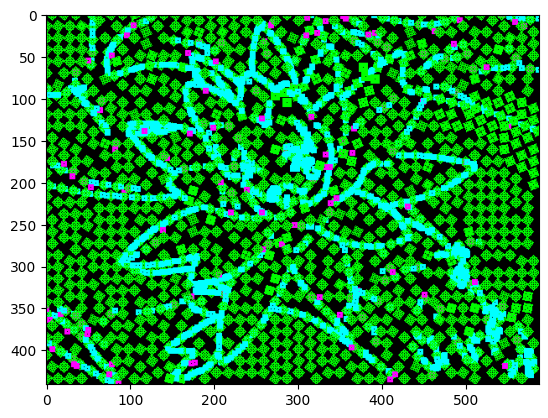

In [29]:
ERROR_CODE_NO_VALID_THETA = -999  # special negative int

def reward_function_fill(theta, original_theta):
    # Reward is negative absolute angle difference — higher reward if angles are more aligned
    diff = abs(theta - original_theta) % 180
    return -min(diff, 180 - diff)  # e.g., 10 deg diff → -10; 170 deg diff → -10

def find_best_theta_fill(center, size, mask_check, original_theta, theta_range=(-45, 45)):
    
    if not check_any_valid_rotation(mask_check, center, size):
        return ERROR_CODE_NO_VALID_THETA
    
    best_theta = None
    best_reward = -float('inf')
    border = BORDER

    for theta in range(theta_range[0], theta_range[1] + 1):
        if is_valid_square(mask_check, center, size, border, theta):
            reward = reward_function_fill(theta, original_theta)
            if reward > best_reward:
                best_reward = reward
                best_theta = theta

    return best_theta if best_theta is not None else ERROR_CODE_NO_VALID_THETA



voronoi_canvas = canvas_image.copy()
voronoi_mask_check = mask_check.copy()
voronoi_mask_draw = mask_draw.copy()

for point in candidate_points_info:
    

    
    if point["distance"] <= 5:

        continue
    
    best_theta = find_best_theta_fill(point["point"], SIZE, voronoi_mask_check, point["rotation"])
    if best_theta == ERROR_CODE_NO_VALID_THETA:
        print("no valid placement at distance: ", point['distance'])
        continue
    else:
        place_tile(tiles_placed_info, voronoi_canvas, voronoi_mask_draw, voronoi_mask_check, point["point"], SIZE, BORDER, best_theta)



    
        
        print("placed tile at distance: ", point["distance"])
        
plt.imshow(voronoi_canvas)


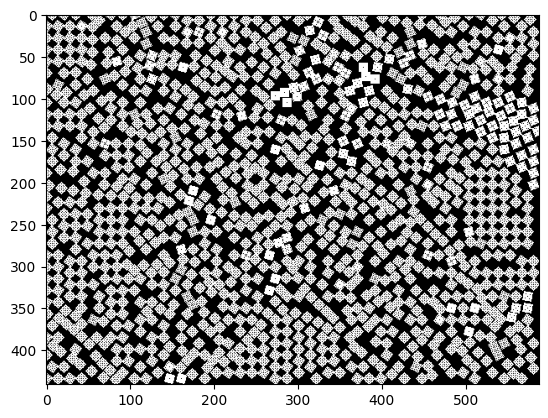

In [30]:
plt.imshow(voronoi_mask_draw)

# Reconstruct Again After Fill

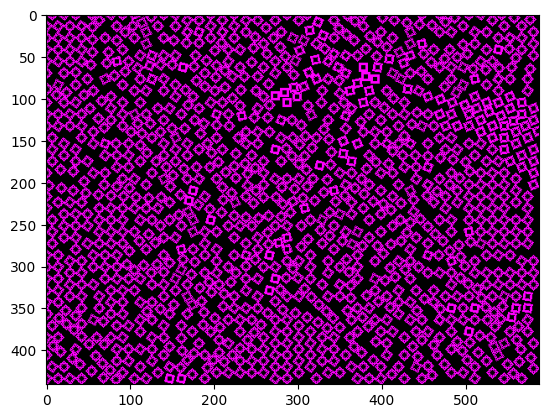

In [31]:
rendered_image = np.zeros_like(mask_draw)

for point_info in tiles_placed_info:
    
    draw_square(
        image=rendered_image,
        center=point_info["point"],
        size=SIZE,
        color=[255, 0, 255],
        border=3,
        theta=point_info["rotation"]
    )
    
plt.imshow(rendered_image)

# Sample Color

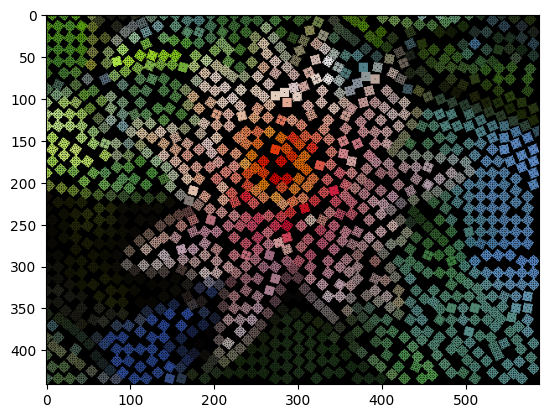

In [32]:
original_array = np.array(downsampled_image)
color_rendered_image = np.zeros_like(original_array)

for point_info in tiles_placed_info:
    coords = get_square_coords(
        center=point_info["point"],
        size=SIZE,
        border=3,
        theta=point_info["rotation"],
        image_shape=original_array.shape[:2]
    )

    sampled_colors = []
    for y, x in coords:
        sampled_colors.append(original_array[y, x])

    if sampled_colors:
        avg_color = np.mean(sampled_colors, axis=0).astype(np.uint8)
    else:
        avg_color = np.array([128, 128, 128], dtype=np.uint8)

    point_info["color"] = avg_color.tolist()

    draw_square(
        image=color_rendered_image,
        center=point_info["point"],
        size=SIZE,
        color=avg_color,
        border=SIZE//2,
        theta=point_info["rotation"]
    )

plt.imshow(color_rendered_image)




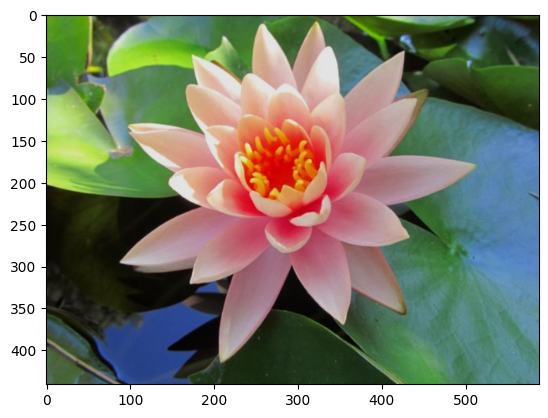

In [33]:
plt.imshow(downsampled_image)

In [34]:
end = datetime.now()
elapsed = end - start
print("Elapsed Time: ", elapsed)

Elapsed Time:  0:03:08.554002


## Create Animation

In [38]:
import imageio

H, W, C = color_rendered_image.shape

n = 20
output_name = "./Results/" + image_path.split("/")[-1][:-4] + "_animation.gif"



background_color = (0,0,0)

# --- Code Logic ---

# Sort tiles by their placement order to ensure correct layering
tiles_placed_info.sort(key=lambda x: x['order'])

frames = []
total_tiles = len(tiles_placed_info)

print(f"Generating GIF with {total_tiles} tiles, adding {n} per frame...")

# Create frames for the animation
for i in range(0, total_tiles, n):
    # Create a new blank canvas for the current frame
    # Using a 3-channel (RGB) image
    frame = np.full((H, W, 3), background_color, dtype=np.uint8)

    # Get the subset of tiles to draw for this frame
    tiles_to_draw = tiles_placed_info[:i + n]

    # Draw each tile onto the frame
    for tile in tiles_to_draw:
        center_point = tuple(map(int, tile['point']))
        rotation_angle = tile['rotation']
        
        # OpenCV uses BGR color format, so we reverse the RGB list
        color_bgr = tile['color'][::-1]

        # Create a RotatedRect object: ((center_x, center_y), (width, height), angle)
        rect = (center_point, (SIZE, SIZE), rotation_angle)

        # Get the 4 vertices of the rotated rectangle
        box_points = cv2.boxPoints(rect)
        box_points = np.intp(box_points) # Convert to integer points

        # Draw the filled rotated square on the frame
        cv2.drawContours(frame, [box_points], 0, color_bgr, -1)
        # Optional: Draw an outline for each tile
        # cv2.drawContours(frame, [box_points], 0, (0,0,0), 1) 

    # Convert the frame from OpenCV's BGR to RGB for imageio
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frames.append(frame_rgb)

# --- Save the animation ---

if not frames:
    print("No frames were generated. Check if 'tiles_placed_info' is empty.")
else:
    # Add a final frame that pauses at the end for better viewing
    # The 'duration' is in seconds. We make the last frame last for 2 seconds.
    # All other frames will have a default duration.
    durations = [0.1] * (len(frames) - 1) + [2.0]
    
    print(f"Saving animation to '{output_name}'...")
    imageio.mimsave(output_name, frames, duration=durations)
    print("Done!")



Generating GIF with 1188 tiles, adding 20 per frame...
Saving animation to './Results/flower_animation.gif'...
Done!
